<font size=6>Classifier des images à l'aide d'un algorithme de deep learning  
Partie 1 : Création d'un réseau de neurones</font>



---

**Vérification de l'environnement**

In [ ]:
import sys
IN_COLAB = "google.colab" in sys.modules
# PATH_DRIVE : to change according to your Google Drive folders
PATH_DRIVE = "/content/drive/My Drive/MachineLearning/ML06"

In [ ]:
if IN_COLAB:
    print("Le notebook est exécuté sur Google Colab")
else:
    print("Le notebook est exécuté en local")

Le notebook est exécuté sur Google Colab


In [ ]:
if IN_COLAB:
    from google.colab import drive, files
    drive.mount("/content/drive")

Mounted at /content/drive


---

<font size=5>**Sommaire**</font>

[1. Préparation des données](#1_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[1.1. Chargement des données](#1_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[1.2. Vérification des données](#1_2)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[1.3. Visualisation de quelques photos de data_train](#1_3)  
  
[2. Premier modèle : Perceptron Multi-Couches](#2_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[2.1. Approche pour réduire le temps de calcul](#2_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[2.2. Préparation d'un jeu de données en Noir et Blanc (grayscale)](#2_2)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[2.3. Premier essai sans optimisation de la structure du modèle](#2_3)  
  
[3. Deuxième modèle : réseau de neurones convolutif](#3_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[3.1. CNN avec trois couches convolutionnelles et trois max pooling](#3_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[3.2. CNN avec trois couches convolutionnelles, trois max pooling et une couche dense intermédiaire](#3_2)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[3.3. Intérêt du whitening et de l'equalization](#3_3)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[3.4. Intérêt de la data augmentation](#3_4)  

[4. Améliorer le modèle CNN sans couche dense intermédiaire](#4_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[4.1. Réduire l'overfitting du modèle en le régularisant](#4_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[4.2. Optimiser la structure du modèle avec Keras Tuner](#4_2)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[4.3. Comparaison de la performance des modèles optimisés et du modèle original](#4_3)  
  
[5. Entraînement des modèles potentiels sur toutes les données](#5_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[5.1. Entraînement du CNN original](#5_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[5.2. Entraînement du CNN optimisé avec 128 filtres sur le premier niveau convolutionnel](#5_2)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[5.3. Entraînement du CNN original régularisé avec plusieurs Spatial Dropout et une sortie en Global Max Pooling](#5_3)  
  
[6. Evaluation de la performance de généralisation du modèle retenu](#6_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[6.1. Modèle de base](#6_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[6.2. Modèle régularisé](#6_1)  

---
## <font color=blue>Notebook set-up</font>

**Importation des librairies**

In [ ]:
import os
#os.environ['CUDA_VISIBLE_DEVICES'] = '-1'

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import re
import datetime
import random as python_random

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv2D, Dropout, SpatialDropout2D
from tensorflow.keras.layers import Flatten, MaxPooling2D, AveragePooling2D
from tensorflow.keras.layers import GlobalAveragePooling2D, GlobalMaxPool2D
from tensorflow.keras.layers import InputLayer
from tensorflow.keras.layers.experimental.preprocessing import Rescaling, Resizing
from tensorflow.keras.utils import plot_model
from tensorflow.keras.callbacks import TensorBoard, EarlyStopping, ModelCheckpoint
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.image import per_image_standardization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.backend import clear_session as tf_clear_session
from tensorflow.keras.models import load_model
from skimage import exposure
from skimage.color import rgb2gray

In [ ]:
if IN_COLAB:
    !pip install keras-tuner
from kerastuner.tuners import BayesianOptimization
from kerastuner import HyperParameters

     |████████████████████████████████| 61kB 3.0MB/s 
  Created wheel for keras-tuner: filename=keras_tuner-1.0.1-cp36-none-any.whl size=73200 sha256=a842a33386d5908f76e68e766cbe477b6a3afc3df28b07cd32dce4b7f6d73a9f
  Stored in directory: /root/.cache/pip/wheels/b9/cc/62/52716b70dd90f3db12519233c3a93a5360bc672da1a10ded43
  Created wheel for terminaltables: filename=terminaltables-3.1.0-cp36-none-any.whl size=15356 sha256=d78778a2019f76067fd3c07cb47f1be4155299e224cdde28eeea55270d4dbd26
  Stored in directory: /root/.cache/pip/wheels/30/6b/50/6c75775b681fb36cdfac7f19799888ef9d8813aff9e379663e
Successfully built keras-tuner terminaltables


In [ ]:
if IN_COLAB:
    sys.path.append(PATH_DRIVE)
    os.chdir(PATH_DRIVE)
    import sf_graphiques as sfg
else:
    import modules_perso.sf_graphiques as sfg

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


**Notebook set-up**

In [ ]:
def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = fig_id + "." + fig_extension
    if IN_COLAB:
        path = PATH_DRIVE + "/" + path
    #print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, dpi=resolution)

In [ ]:
RANDOM_SEED = 42
BATCH_SIZE = 32

In [ ]:
def reset_random_seeds():
    np.random.seed(RANDOM_SEED)
    python_random.seed(RANDOM_SEED)
    tf.random.set_seed(RANDOM_SEED)

In [ ]:
%load_ext tensorboard

**Fonctions personnelles**

L'erreur de validation est calculée à la fin de chaque validation alors que l'erreur d'entraînement est calculée à l'aide d'une moyenne glissante pendant chaque époque. La courbe d'entraînement doit donc être décalée d'une demi époque vers la gauche.

In [ ]:
def graph_analysis_both(graph_title, history, figsize=(12, 8),
                        only_accuracy=False, is_csv=False, es_patience=20):
    if not is_csv:
        train_acc = history.history["accuracy"]
        valid_acc = history.history["val_accuracy"]
        train_loss = history.history["loss"]
        valid_loss = history.history["val_loss"]
    else:
        train_acc = history["accuracy"]
        valid_acc = history["val_accuracy"]
        train_loss = history["loss"]
        valid_loss = history["val_loss"]
    epoch_max = len(train_acc)
    epochs_range = np.arange(epoch_max)

    if only_accuracy:
        graph = sfg.MyGraph(graph_title, figsize=figsize)
    else:
        graph = sfg.MyGraph(graph_title, nblin=1, nbcol=2, figsize=figsize)
    graph.add_plot(epochs_range+0.5, train_acc, label="Training Accuracy",
                  multi_index=1)
    graph.add_plot(epochs_range+1, valid_acc, label="Validation Accuracy",
                  subtitle="Accuracy", legend=True, 
                  with_grid="both", grid_style=":", multi_index=1)
    graph.set_axe_x(label="Epoques", label_position=(1.1, 0.5),
                    tick_min=1, tick_max=epoch_max, multi_index=1)
    graph.set_axe_y(tick_labels_format=":.2%", multi_index=1)
    ymin, ymax = graph.ax[0].get_ylim()
    idx_ref = epoch_max - es_patience
    graph.add_fleches(idx_ref, ymax, 0, valid_acc[idx_ref-1]-ymax,
                      units='xy', color="dimgrey", multi_index=1)
    if not only_accuracy:
        graph.add_plot(epochs_range+0.5, train_loss, label="Training Loss",
                      multi_index=2)
        graph.add_plot(epochs_range+1, valid_loss, label="Validation Loss",
                      subtitle="Perte (categorical cross entropy)", legend=True,
                      with_grid="both", grid_style=":", multi_index=2)
        graph.set_axe_x(tick_min=1, tick_max=epoch_max, multi_index=2)
        graph.set_axe_y(tick_min=0, tick_max=10, multi_index=2)
        ymin, ymax = graph.ax[1].get_ylim()
        idx_ref = epoch_max - es_patience
        graph.add_fleches(idx_ref, ymax, 0, valid_loss[idx_ref-1]-ymax,
                          units='xy', color="dimgrey", multi_index=2)
    return graph.fig, graph.ax

In [ ]:
# with_rescaling : True si la première couche est un rescaling ;
#                  False si rescaling fait par ImageDataGenerator.
# first_activation_relu : True si les données initiales sont rescalées entre 0 et 1 ;
#                         False si les données initiales sont centrées autour de 0 -> fonction sigmoid utilisée.
# width of dense : entier positif : nombre de neurones dans une couche dense optionnelle avant la couche dense de classification
#                  0 ou négatif : pas de couche dense avant la couche dense de classification
# regularisation_method : "none" si pas de régularisation
#                         "dropout" si on ajoute un dropout après la dernière couche de pooling
#                         "spatial_dropout" si on ajoute un spatial dropout après la dernière couche convolutionnelle
#                         "GAP_v1" si on ajoute un GeneralAveragePooling après le dernier MaxPooling2D
#                         "GAP_v2" si on remplace le dernier MaxPooling2D par un GeneralAveragePooling
#                         "GMP" si on remplace le dernier MaxPooling2D par un GeneralMaxPooling
def get_model_cnn(with_rescaling=True, first_activation_relu=True,
                  width_of_dense=0, regularisation_method="none"):
    model = Sequential()
    if with_rescaling:
        model.add(Rescaling(1./255, input_shape=(256, 256, 3)))
    else:
        model.add(InputLayer(input_shape=(256, 256, 3)))
    if first_activation_relu:
        model.add(Conv2D(32, (3, 3), padding="same", activation="relu"))
    else:
        model.add(Conv2D(32, (3, 3), padding="same", activation="sigmoid"))
    model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))
    model.add(Conv2D(64, (3, 3), padding="same", activation="relu"))
    model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))
    model.add(Conv2D(128, (3, 3), padding="same", activation="relu"))
    if regularisation_method == "GMP":
        model.add(GlobalMaxPool2D())
    elif regularisation_method == "GAP_v2":
        model.add(GlobalAveragePooling2D())
    else:
        if regularisation_method == "spatial_dropout":
            model.add(SpatialDropout2D(0.2, seed=RANDOM_SEED))
        model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))
        if regularisation_method == "dropout":
            model.add(Dropout(0.2, seed=RANDOM_SEED))
        if regularisation_method == "GAP_v1":
            model.add(GlobalAveragePooling2D())
        else:
            model.add(Flatten())
    if width_of_dense > 0:
        model.add(Dense(width_of_dense, activation="relu"))
        model.add(Dropout(0.2, seed=RANDOM_SEED))
    model.add(Dense(120, activation="softmax"))

    model.compile(loss="sparse_categorical_crossentropy",
                  optimizer="adam",
                  metrics=["accuracy"])
    return model

In [ ]:
def graph_analysis_compar(graph_title, history, figsize=(12, 8),
                          only_accuracy=False):
    mini_acc = history["val_accuracy_mini"]
    all_acc = history["val_accuracy_all"]
    mini_loss = history["val_loss_mini"]
    all_loss = history["val_loss_all"]
    epoch_max = max(len(mini_acc), len(all_acc))
    epochs_range = np.arange(epoch_max)

    if only_accuracy:
        graph = sfg.MyGraph(graph_title, figsize=figsize)
    else:
        graph = sfg.MyGraph(graph_title, nblin=1, nbcol=2, figsize=figsize)
    graph.add_plot(epochs_range+1, mini_acc, label="Données partielles",
                  multi_index=1)
    graph.add_plot(epochs_range+1, all_acc, label="Toutes les données",
                   subtitle="Validation Accuracy", legend=True, 
                   with_grid="both", grid_style=":", multi_index=1)
    graph.set_axe_x(label="Epoques", label_position=(1.1, 0.5),
                    tick_min=1, tick_max=epoch_max, multi_index=1)
    graph.set_axe_y(tick_labels_format=":.2%", multi_index=1)
    if not only_accuracy:
        graph.add_plot(epochs_range+1, mini_loss, label="Données partielles",
                      multi_index=2)
        graph.add_plot(epochs_range+1, all_loss, label="Toutes les données",
                       subtitle="Validation Loss", legend=True,
                       with_grid="both", grid_style=":", multi_index=2)
        graph.set_axe_x(tick_min=1, tick_max=epoch_max, multi_index=2)
        #graph.set_axe_y(tick_min=0, tick_max=10, multi_index=2)
    return graph.fig, graph.ax

---
<a id='1_0'></a>

## <font color=blue>1. Préparation des données</font>

### 1.1. Chargement des données

In [ ]:
tf.__version__

'2.3.0'

In [ ]:
tf.keras.__version__

'2.4.0'

In [ ]:
#tf.test.is_gpu_available()
tf.config.list_physical_devices('GPU')

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

Je télécharge les données sur mon Google Drive puis je décompresse les donnés (seulement la première fois).

In [ ]:
#if IN_COLAB:
#    !wget http://vision.stanford.edu/aditya86/ImageNetDogs/images.tar

In [ ]:
#if IN_COLAB:
#    !tar -xvf images.tar

Je dispose d'environ 150 images pour chacune des 120 classes, aux dires de la documentation. Je conserve 20% des données, soit environ 30 images par classe, comme données de test pour évaluer la performance de généralisation. Je ne regarde pas ces données avant la dernière étape.  
J'ai donc environ 120 images par race de chien dans mon set de données appelé data_fulltrain. Je divise ce set de données en deux ensembles: un jeu d'entraînement (80%) et un jeu de validation (20%).

In [ ]:
image_size = (256, 256)
data_fulltrain = tf.keras.preprocessing.image_dataset_from_directory(
    "Images",
    label_mode="int", color_mode="rgb",
    image_size=image_size, batch_size=BATCH_SIZE,
    shuffle=True, seed=RANDOM_SEED, validation_split=0.2, subset="training"
)
data_test = tf.keras.preprocessing.image_dataset_from_directory(
    "Images",
    label_mode="int", color_mode="rgb",
    image_size=image_size, batch_size=BATCH_SIZE,
    shuffle=True, seed=RANDOM_SEED, validation_split=0.2, subset="validation"
)

Found 20580 files belonging to 120 classes.
Using 16464 files for training.
Found 20580 files belonging to 120 classes.
Using 4116 files for validation.


In [ ]:
data_fulltrain

<BatchDataset shapes: ((None, 256, 256, 3), (None,)), types: (tf.float32, tf.int32)>

In [ ]:
print(data_fulltrain.cardinality().numpy())

515


Il y a 515 batches de 32 images dans le dataset data_fulltrain.  
Je partage ce dataset en un jeu d'entraînement (80% des données) et de validation (20% des données).

In [ ]:
nb_batches = data_fulltrain.cardinality().numpy()
data_valid = data_fulltrain.take(nb_batches // 5)
data_train = data_fulltrain.skip(nb_batches // 5)

<a id='1_2'></a>

### 1.2. Vérification des données

**Nettoyage du nom des races de chien**

J'enlève les 10 premiers caractères, qui représentent une identification alphanumérique de chaque race, afin de ne conserver que le nom des races.  
Ensuite, je remplace les underscores par des espaces et je force une majuscule au début de chaque mot.  
Dans un autre tableau, je ne conserve que la version courte du nom en limitant le nombre de caractères à 20.

In [ ]:
dog_race = []
short_dog_race = []
for cn in data_fulltrain.class_names:
    full_name = cn[10:].replace("_", " ").title()
    dog_race.append(full_name)
    short_dog_race.append(full_name[:20])

In [ ]:
print(dog_race)
print(short_dog_race)

['Chihuahua', 'Japanese Spaniel', 'Maltese Dog', 'Pekinese', 'Shih-Tzu', 'Blenheim Spaniel', 'Papillon', 'Toy Terrier', 'Rhodesian Ridgeback', 'Afghan Hound', 'Basset', 'Beagle', 'Bloodhound', 'Bluetick', 'Black-And-Tan Coonhound', 'Walker Hound', 'English Foxhound', 'Redbone', 'Borzoi', 'Irish Wolfhound', 'Italian Greyhound', 'Whippet', 'Ibizan Hound', 'Norwegian Elkhound', 'Otterhound', 'Saluki', 'Scottish Deerhound', 'Weimaraner', 'Staffordshire Bullterrier', 'American Staffordshire Terrier', 'Bedlington Terrier', 'Border Terrier', 'Kerry Blue Terrier', 'Irish Terrier', 'Norfolk Terrier', 'Norwich Terrier', 'Yorkshire Terrier', 'Wire-Haired Fox Terrier', 'Lakeland Terrier', 'Sealyham Terrier', 'Airedale', 'Cairn', 'Australian Terrier', 'Dandie Dinmont', 'Boston Bull', 'Miniature Schnauzer', 'Giant Schnauzer', 'Standard Schnauzer', 'Scotch Terrier', 'Tibetan Terrier', 'Silky Terrier', 'Soft-Coated Wheaten Terrier', 'West Highland White Terrier', 'Lhasa', 'Flat-Coated Retriever', 'Cur

**Nombre de photos par race de chien**

In [ ]:
nb_img_race = {}
list_dirs = next(os.walk("Images"))[1]
for dir in list_dirs:
    race_dir = os.path.join("Images", dir)
    list_imgs = next(os.walk(race_dir))[2]
    nb_img_race[dir] = len(list_imgs)

In [ ]:
for w in sorted(nb_img_race, key=nb_img_race.get, reverse=True):
    print(w, nb_img_race[w])

n02085936-Maltese_dog 252
n02088094-Afghan_hound 239
n02092002-Scottish_deerhound 232
n02112018-Pomeranian 219
n02107683-Bernese_mountain_dog 218
n02090721-Irish_wolfhound 218
n02111889-Samoyed 218
n02086240-Shih-Tzu 214
n02111500-Great_Pyrenees 213
n02111129-Leonberg 210
n02110806-basenji 209
n02097474-Tibetan_terrier 206
n02095889-Sealyham_terrier 202
n02096051-Airedale 202
n02108000-EntleBucher 202
n02091831-Saluki 200
n02110958-pug 200
n02095570-Lakeland_terrier 197
n02096177-cairn 197
n02091467-Norwegian_elkhound 196
n02112137-chow 196
n02086910-papillon 196
n02096294-Australian_terrier 196
n02088364-beagle 195
n02111277-Newfoundland 195
n02110185-Siberian_husky 192
n02086646-Blenheim_spaniel 188
n02091244-Ibizan_hound 188
n02091134-whippet 187
n02088466-bloodhound 187
n02098413-Lhasa 186
n02094258-Norwich_terrier 185
n02085782-Japanese_spaniel 185
n02107312-miniature_pinscher 184
n02097658-silky_terrier 183
n02091032-Italian_greyhound 182
n02093647-Bedlington_terrier 182
n0209658

In [ ]:
interdata = []
for w in sorted(nb_img_race, key=nb_img_race.get, reverse=True):
    interdata.append([w, nb_img_race[w]])
graph_data = pd.DataFrame(interdata, columns=["race", "nombre_photos"])
graph_data["race"] = graph_data.race.str[10:]
graph_data["race"] = graph_data.race.str.replace("_", " ")
graph_data["race"] = graph_data.race.str.title()
graph_data.head()

,race,nombre_photos
0,Maltese Dog,252
1,Afghan Hound,239
2,Scottish Deerhound,232
3,Pomeranian,219
4,Bernese Mountain Dog,218


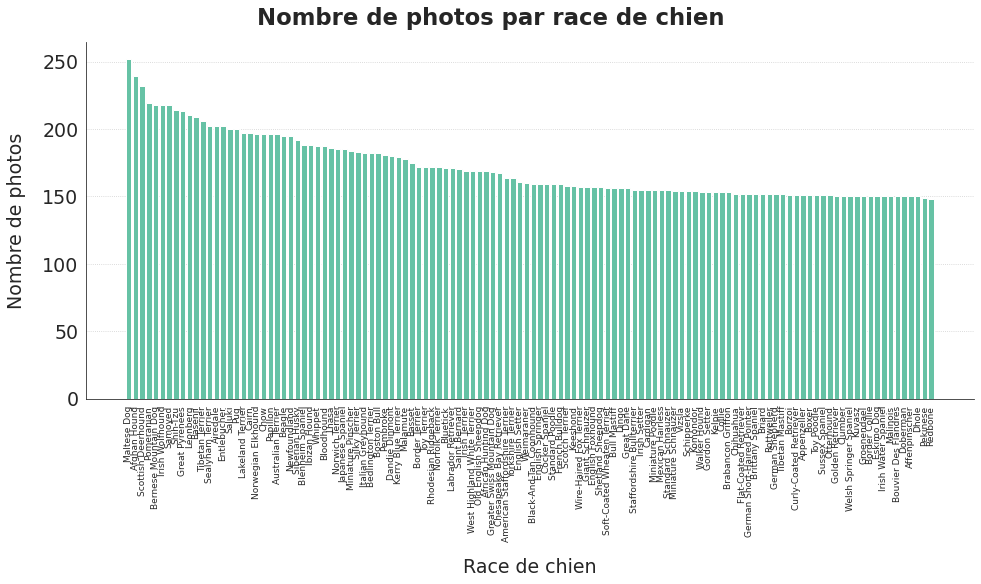

In [ ]:
graph = sfg.MyGraph("Nombre de photos par race de chien", figsize=(14, 8))
graph.add_barv(graph_data.race, graph_data.nombre_photos)
graph.set_axe_x(label="Race de chien", rotation=90, ha="center")
graph.set_axe_y(label="Nombre de photos", tick_min=0)
fig, ax = graph.fig, graph.ax
ax[0].tick_params(axis="x", labelsize=9)
save_fig("iml06_nb_photos_par_race")
plt.show()

Il y a au moins 148 images par classe. La majorité des races comprend entre 150 et 160 images. Quelques classes sont mieux représentées avec plus de 200 images.

<a id='1_3'></a>

### 1.3. Visualisation de quelques photos de data_train

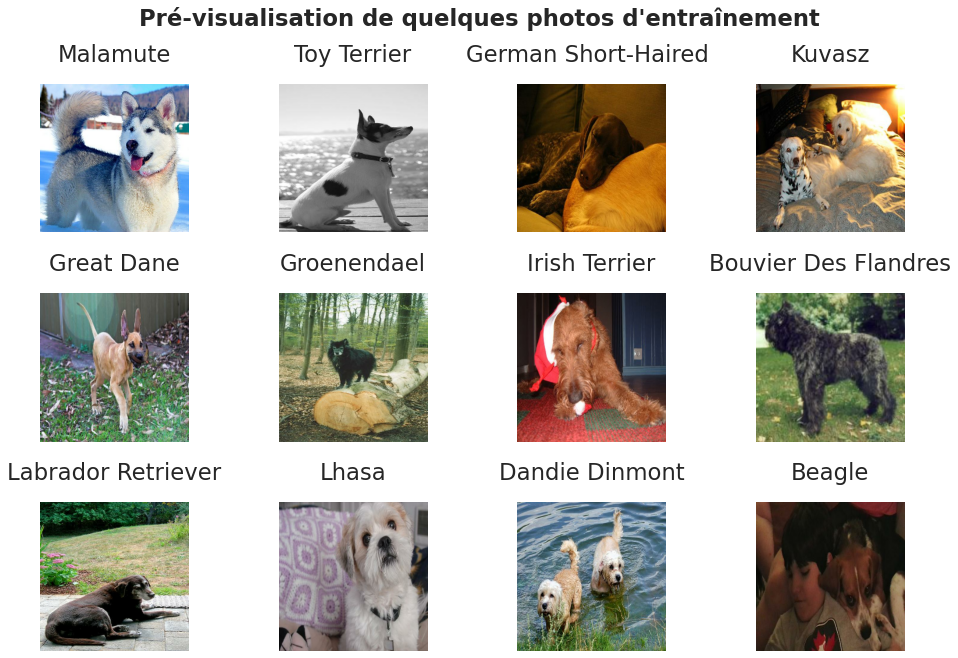

In [ ]:
graph = sfg.MyGraph("Pré-visualisation de quelques photos d'entraînement",
                    nblin=3, nbcol=4, figsize=(14, 9))
for img, lab in data_train.take(1):
    for i in range(12):
        graph.add_image(np.array(img[i], dtype="uint8"),
                        subtitle=short_dog_race[lab[i]],
                        multi_index=i+1)
fig, ax = graph.fig, graph.ax
save_fig("iml06_01_colorsamples", tight_layout=False)
plt.show()

Comme la taille originale des photos (ni leur ratio hauteur/largeur) n'est pas uniforme, certaines photos paraissent déformées. On voit que l'angle de vue (profil, face, plongée, contre-plongée) et le cadrage diffèrent d'une photo à l'autre. Parfois des éléments de l'environnement peuvent perturber le modèle (personnes, mobilier, paysage...).

---
<a id='2_0'></a>

## <font color=blue>2. Premier modèle : Perceptron Multi-Couches</font>

Je construis un modèle basé sur des couches denses pour le premier essai avec un réseau de neurones. Normalement, ce modèle ne devrait pas être le meilleur pour traiter des images.

### 2.1. Approche pour réduire le temps de calcul

Pour réduire le temps de calcul des paramètres des premiers essais, je dispose de deux approches qui visent toutes deux à réduire le nombre de données traitées pour accélérer les calcules, au détriment de la précision des résultats de l'entraînement :
- ne conserver qu'un sous-ensemble des 120 classes à estimer. Si je choisis de conserver 20% des données, je ne garderai donc que 24 classes et entraînerai le modèle sur toutes les images d'entraînement de ces 24 classes. Au-delà du nombre limité de données d'entraînement, ce choix peut biaiser les résultats à travers les races sélectionnées qui ne sont pas nécessairement suffisamment représentatives de l'ensemble des races à identifier ;  
- conserver toutes les races (les 120 classes) mais limiter le nombre de batchs utilisés par époque pour déterminer les poids du modèle. Si je n'utilise que du 20% du nombre total de batchs du jeu d'entraînement, j'aurai au final le même nombre d'images mais sur un échantillon bien plus représentatif de la population totale.  
  
Je choisis la deuxième option.


In [ ]:
print(data_train.cardinality().numpy())

412


Je vais donc prendre les 83 premiers batchs de data_train pour entraîner mon réseau, en arrondissant 82,4 à l'entier supérieur.

In [ ]:
data_mini = data_train.take(int(np.ceil(0.2 * data_train.cardinality().numpy())))
print(data_mini.cardinality().numpy())

83


<a id='2_2'></a>

### 2.2. Préparation d'un jeu de données en Noir et Blanc (grayscale)

Lorsqu'on applique des couches denses sur une image, il est préférable de fournir des images en noir et blanc pour faciliter l'extraction des données.  
Pour ce faire, je charge le même jeu de données en N&B et je vérifie les images en ma possession.

Je vérifie quelques images en NB.

In [ ]:
image_size = (256, 256)
data_fulltrain_nb = tf.keras.preprocessing.image_dataset_from_directory(
    "Images",
    label_mode="int", color_mode="grayscale",
    image_size=image_size, batch_size=BATCH_SIZE,
    shuffle=True, seed=RANDOM_SEED, validation_split=0.2, subset="training"
)
data_test_nb = tf.keras.preprocessing.image_dataset_from_directory(
    "Images",
    label_mode="int", color_mode="grayscale",
    image_size=image_size, batch_size=BATCH_SIZE,
    shuffle=True, seed=RANDOM_SEED, validation_split=0.2, subset="validation"
)

Found 20580 files belonging to 120 classes.
Using 16464 files for training.
Found 20580 files belonging to 120 classes.
Using 4116 files for validation.


In [ ]:
nb_batches_nb = data_fulltrain_nb.cardinality().numpy()
data_valid_nb = data_fulltrain_nb.take(nb_batches_nb // 5)
data_train_nb = data_fulltrain_nb.skip(nb_batches_nb // 5)

In [ ]:
data_mini_nb = data_train_nb.take(int(np.ceil(0.2 * data_train_nb.cardinality().numpy())))
print(data_mini_nb.cardinality().numpy())

83


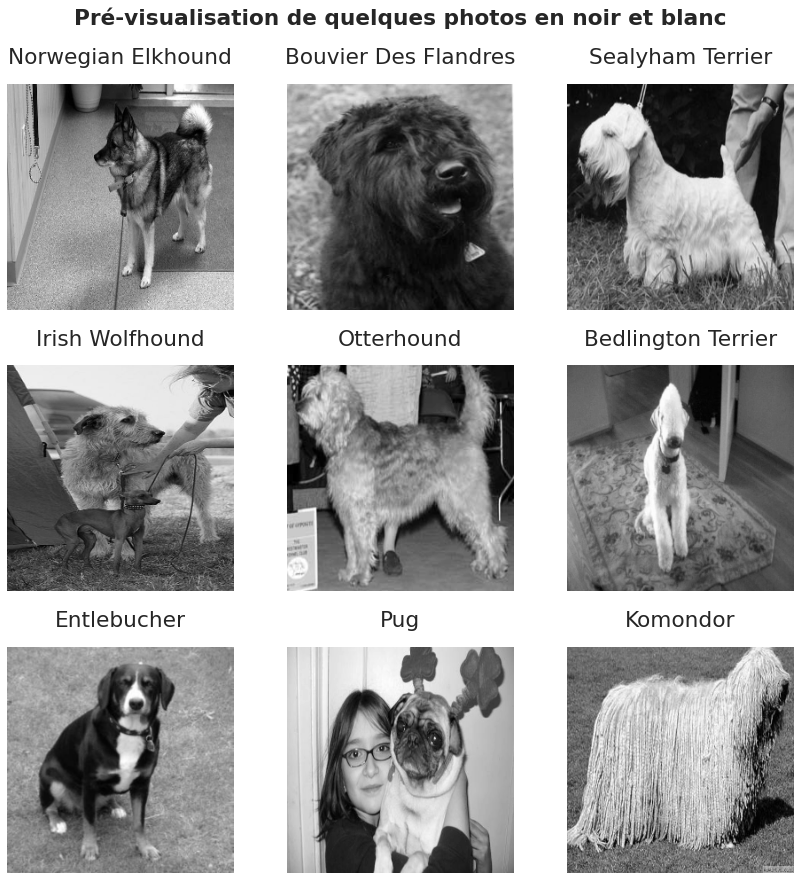

In [ ]:
graph = sfg.MyGraph("Pré-visualisation de quelques photos en noir et blanc",
                    nblin=3, nbcol=3, figsize=(12, 12))
for img, lab in data_mini_nb.take(1):
    for i in range(9):
        graph.add_image(np.array(img[i], dtype="uint8").reshape(256, 256),
                        subtitle=short_dog_race[lab[i]],
                        multi_index=i+1)
fig, ax = graph.fig, graph.ax
save_fig("iml06_01_bwsamples")
plt.show()

<a id='2_3'></a>

### 2.3. Premier essai sans optimisation de la structure du modèle

La dernière couche devra être une couche dense avec autant de sorties que de classes possibles, soit 120 neurones. La fonction d'activation de cette couche sera une softmax, car nous sommes dans un problème de classification multi-classes et nous ne souhaitons obtenir qu'une classe.  
En général, les couches denses plus basses comportent autant ou plus de neurones que les couches qui les suivent.  
Pour commencer et avoir une première performance de base, je fixe arbitrairement une première couche à 960 neuros, puis une seconde à 480 neurones et une dernière (avant celle de classification) à 240 neurones, à chaque fois avec une fonction d'activation ReLU. Diminuer progressivement le nombre de neurones me permet aussi de limiter le nombre de poids à estimer.  
Mes images comportent 3 dimensions car elles sont en couleur. Je dois les applatir avec un layer Flatten avant de les fournir à mes couches de neurones.  
Afin de régulariser la rétropropagation du gradient, j'insère un layer Dropout sur 20% des neurones entre chaque couche dense.

In [ ]:
# I don't use the caching of data within Google Colab because it leads to a RAM overflow
if not IN_COLAB:
    AUTOTUNE = tf.data.experimental.AUTOTUNE
    data_train = data_mini.cache().prefetch(buffer_size=AUTOTUNE)
    data_valid = data_valid.cache().prefetch(buffer_size=AUTOTUNE)
    print("Cache is set")
else:
    print("No cache")

No cache


In [ ]:
MODEL_NAME = "01_pmc"

In [ ]:
model = Sequential()
model.add(Rescaling(1./255, input_shape=(256, 256, 1)))
model.add(Flatten())
model.add(Dense(960, activation="relu"))
model.add(Dropout(0.2, seed=RANDOM_SEED))
model.add(Dense(480, activation="relu"))
model.add(Dropout(0.2, seed=RANDOM_SEED))
model.add(Dense(240, activation="relu"))
model.add(Dropout(0.2, seed=RANDOM_SEED))
model.add(Dense(120, activation="softmax"))

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling (Rescaling)        (None, 256, 256, 1)       0         
_________________________________________________________________
flatten (Flatten)            (None, 65536)             0         
_________________________________________________________________
dense (Dense)                (None, 960)               62915520  
_________________________________________________________________
dropout (Dropout)            (None, 960)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 480)               461280    
_________________________________________________________________
dropout_1 (Dropout)          (None, 480)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 240)               1

Le modèle a un nombre très élevé de paramètres, du fait de l'utilisation de couches denses. Ce nombre élevé de paramètres cumulé au petit nombre d'images à notre disposition risque de créer un sur-apprentissage marqué. L'utilisation de couches dropout après chaque couche dense est donc indispensable.

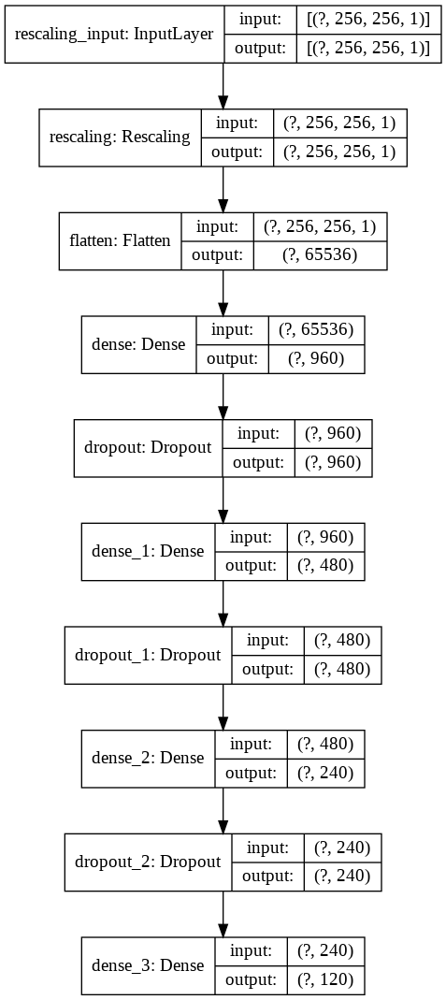

In [ ]:
plot_model(model, to_file="plot_{}.png".format(MODEL_NAME), show_shapes=True)

Pour l'instant, j'utilise l'algorithme d'optimisation adam. Je verrai par la suite si j'ai intérêt à utiliser un autre algorithme d'optimisation.

In [ ]:
model.compile(loss="sparse_categorical_crossentropy",
              optimizer="adam",
              metrics=["accuracy"])

In [ ]:
es_patience = 20
logdir = os.path.join("logs", MODEL_NAME, datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = TensorBoard(logdir, histogram_freq=1)
checkpoint_callback = ModelCheckpoint("model_{}.h5".format(MODEL_NAME),
                                      monitor="val_loss", save_best_only=True)
earlystop_callback = EarlyStopping(monitor='val_loss', mode="min", patience=es_patience,
                                   restore_best_weights=True)

In [ ]:
epochs = 1000
history = model.fit(data_mini_nb, validation_data=data_valid_nb, verbose=2,
                    epochs=epochs, callbacks=[checkpoint_callback,
                                              earlystop_callback,
                                              tensorboard_callback])

Epoch 1/1000
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
83/83 - 794s - loss: 9.5451 - accuracy: 0.0087 - val_loss: 4.7871 - val_accuracy: 0.0067
Epoch 2/1000
83/83 - 24s - loss: 4.8237 - accuracy: 0.0109 - val_loss: 4.7942 - val_accuracy: 0.0085
Epoch 3/1000
83/83 - 26s - loss: 4.7984 - accuracy: 0.0098 - val_loss: 4.7870 - val_accuracy: 0.0109
Epoch 4/1000
83/83 - 22s - loss: 4.7992 - accuracy: 0.0105 - val_loss: 4.7866 - val_accuracy: 0.0106
Epoch 5/1000
83/83 - 20s - loss: 4.7918 - accuracy: 0.0143 - val_loss: 4.7868 - val_accuracy: 0.0106
Epoch 6/1000
83/83 - 22s - loss: 4.7842 - accuracy: 0.0139 - val_loss: 4.7864 - val_accuracy: 0.0106
Epoch 7/1000
83/83 - 23s - loss: 4.7825 - accuracy: 0.0181 - val_loss: 4.7945 - val_accuracy: 0.0121
Epoch 8/1000
83/83 - 23s - loss: 4.7809 - accuracy: 0.0139 - val_loss: 4.7866 - val_accuracy: 0.0106
Epoch 9/1000
83/83 - 23s - loss: 4.7822 - accuracy: 0.0136 - val_loss: 4.7869 - val_accuracy: 0.0100
Epoch 10/1000
83/8

Je sauvegarde les résultats dans un fichier csv pour pouvoir y revenir facilement.

In [ ]:
history_csv = pd.DataFrame(history.history)
history_csv.to_csv("history_{}.csv".format(MODEL_NAME))

In [ ]:
history_csv = pd.read_csv("history_01_pmc.csv", index_col=0)
history_csv.head()

,loss,accuracy,val_loss,val_accuracy
0,9.545087,0.008660,4.787080,0.006675
1,4.823707,0.010919,4.794166,0.008495
2,4.798421,0.009789,4.786963,0.010922
3,4.799161,0.010542,4.786563,0.010619
4,4.791813,0.014307,4.786784,0.010619


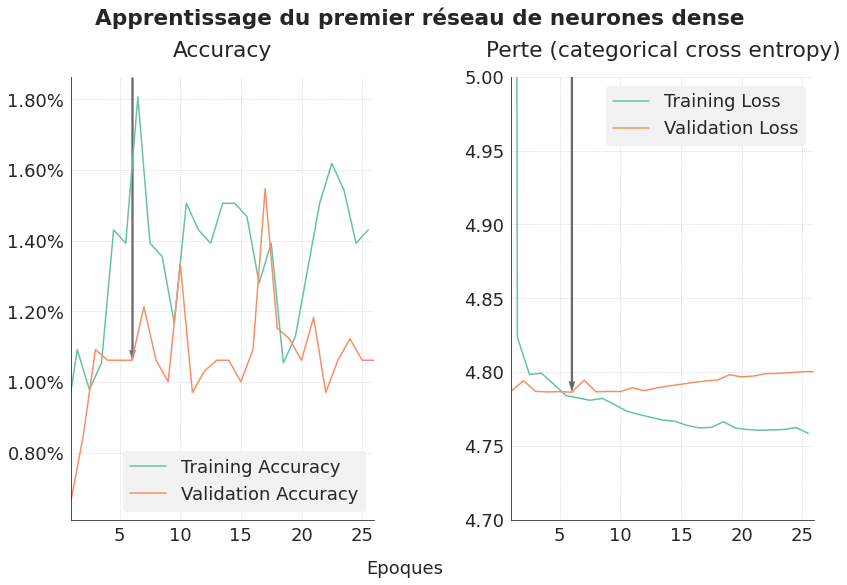

In [ ]:
fig, ax = graph_analysis_both("Apprentissage du premier réseau de neurones dense",
                              history_csv, is_csv=True)
ax[1].set_ylim([4.7, 5.0])
save_fig("iml06_01_pmc")
plt.show()

La perte de validation augmente après 6 époques, et l'accuracy de validation stagne entre 1% et 1.20%. C'est à peine plus que le hasard qui vaut 0.83% (1/120 classes).  
Ces performances ne sont pas bonnes. Je m'y attendais car les couches denses ne sont pas les meilleurs couches de neurones pour extraire les features des images. Pour cela, il faut mieux utiliser des couches convolutionnelles.

In [ ]:
%tensorboard --logdir logs/01_pmc

<IPython.core.display.Javascript object>

---
<a id='3_0'></a>

## <font color=blue>3. Deuxième modèle : réseau de neurones convolutif</font>

### 3.1. CNN avec trois couches convolutionnelles et trois max pooling

Je commence par créer un réseau de neurones convolutif de base, qui comporte 3 niveaux. Chaque niveau est composé :
- d'une couche convolutionnelle, avec un nombre de filtres qui double d'un niveau à l'autre (32, 64 puis 128), un noyau convolutif de taille 3*3, une fonction d'activation Relu et un padding afin d'obtenir des features maps de même taille qu'en entrée ;
- d'une couche de max pooling de taille 2*2 sans recoupement.  
  
Pour finir, j'applatis les sorties et j'applique une couche dense avec 120 neurones et une fonction d'activation softmax afin d'effectuer ma classification multi-classe.

In [ ]:
MODEL_NAME = "02_cnn"

In [ ]:
model2 = get_model_cnn()
model2.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling (Rescaling)        (None, 256, 256, 3)       0         
_________________________________________________________________
conv2d (Conv2D)              (None, 256, 256, 32)      896       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 128, 128, 64)      18496     
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 64, 64, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 64, 64, 128)       73856     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 32, 32, 128)       0

Le modèle a un nombre moins élevé de paramètres (environ 4 fois moins de paramètres), du fait de l'utilisation de couches de convolution au lieu de couches denses.  
La grande majorité des poids à déterminer provient de la partie classification, du fait que l'on applatisse les données après la dernière couche de max pooling.

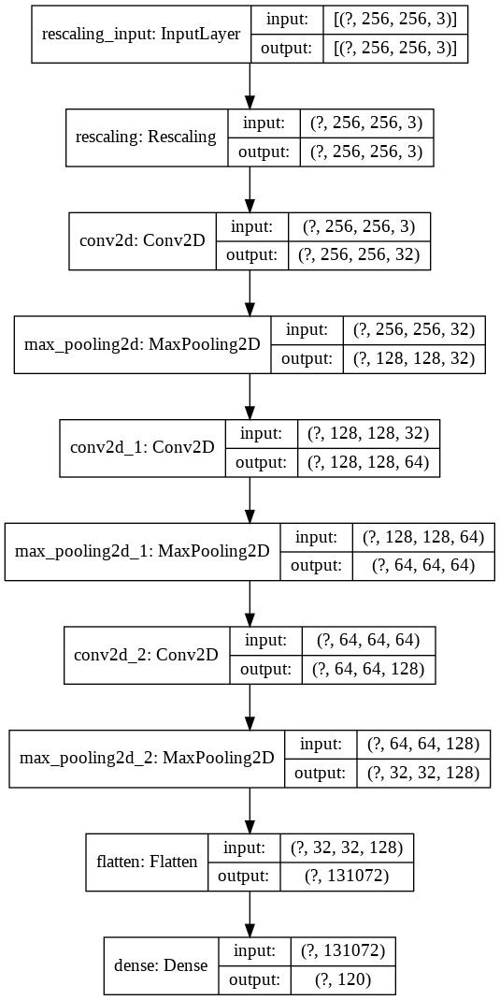

In [ ]:
plot_model(model2, to_file="plot_{}.png".format(MODEL_NAME), show_shapes=True)

In [ ]:
es_patience = 20
logdir = os.path.join("logs", MODEL_NAME, datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = TensorBoard(logdir, histogram_freq=1)
checkpoint_callback = ModelCheckpoint("model_{}.h5".format(MODEL_NAME),
                                      monitor="val_loss", save_best_only=True)
earlystop_callback = EarlyStopping(monitor='val_loss', mode="min", patience=es_patience,
                                   restore_best_weights=True)

In [ ]:
epochs = 1000
history2 = model2.fit(data_mini, validation_data=data_valid, verbose=2,
                     epochs=epochs, callbacks=[checkpoint_callback,
                                               earlystop_callback,
                                               tensorboard_callback])

Epoch 1/1000
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
83/83 - 581s - loss: 4.8902 - accuracy: 0.0124 - val_loss: 4.7820 - val_accuracy: 0.0133
Epoch 2/1000
83/83 - 40s - loss: 4.6121 - accuracy: 0.0331 - val_loss: 4.8223 - val_accuracy: 0.0237
Epoch 3/1000
83/83 - 40s - loss: 2.5290 - accuracy: 0.4635 - val_loss: 5.7848 - val_accuracy: 0.0482
Epoch 4/1000
83/83 - 40s - loss: 1.0221 - accuracy: 0.8148 - val_loss: 7.6454 - val_accuracy: 0.0610
Epoch 5/1000
83/83 - 40s - loss: 0.6064 - accuracy: 0.9017 - val_loss: 9.3000 - val_accuracy: 0.0816
Epoch 6/1000
83/83 - 40s - loss: 0.4695 - accuracy: 0.9375 - val_loss: 9.8476 - val_accuracy: 0.0947
Epoch 7/1000
83/83 - 41s - loss: 0.3146 - accuracy: 0.9575 - val_loss: 9.7435 - val_accuracy: 0.1120
Epoch 8/1000
83/83 - 40s - loss: 0.3363 - accuracy: 0.9642 - val_loss: 10.1222 - val_accuracy: 0.1232
Epoch 9/1000
83/83 - 40s - loss: 0.2035 - accuracy: 0.9767 - val_loss: 10.9122 - val_accuracy: 0.1283
Epoch 10/1000
83

Je sauvegarde les résultats dans un fichier csv pour pouvoir y revenir facilement.

In [ ]:
history2_csv = pd.DataFrame(history2.history)
history2_csv.to_csv("history_{}.csv".format(MODEL_NAME))

In [ ]:
history_csv = pd.read_csv("history_02_cnn.csv", index_col=0)
history_csv.head()

,loss,accuracy,val_loss,val_accuracy
0,4.890179,0.012425,4.782028,0.013350
1,4.612084,0.033133,4.822272,0.023665
2,2.528976,0.463479,5.784799,0.048240
3,1.022148,0.814759,7.645425,0.060983
4,0.606440,0.901732,9.300019,0.081614


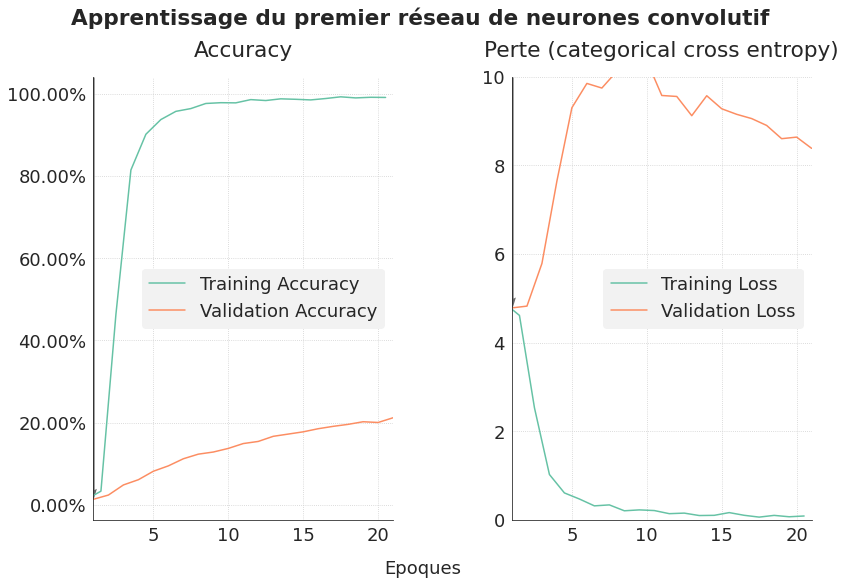

In [ ]:
fig, ax = graph_analysis_both("Apprentissage du premier réseau de neurones convolutif",
                              history_csv, is_csv=True)
plt.show()

La perte de validation augmente après 2 époques. Toutefois, on note qu'elle diminue à nouveau à partir de la 13ème époque et que l'accuracy de validation augmente constamment après cette deuxième époque jusqu'au déclenchement du early stopping.  
Je refais tourner un fitting en basant l'arrêt précoce sur l'accuracy plutôt que sur la perte (l'autre option aurait été de laisser l'arrêt précoce se basant sur la perte mais avec une plus patience plus élevée).

In [ ]:
model2.compile(loss="sparse_categorical_crossentropy",
               optimizer="adam",
               metrics=["accuracy"])

In [ ]:
es_patience = 20
logdir = os.path.join("logs", MODEL_NAME, datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = TensorBoard(logdir, histogram_freq=1)
checkpoint_callback = ModelCheckpoint("model_{}.h5".format(MODEL_NAME),
                                      monitor="val_accuracy", save_best_only=True)
earlystop_callback = EarlyStopping(monitor='val_accuracy', mode="max", patience=es_patience,
                                   restore_best_weights=True)

In [ ]:
epochs = 1000
history2 = model2.fit(data_mini, validation_data=data_valid, verbose=2,
                     epochs=epochs, callbacks=[checkpoint_callback,
                                               earlystop_callback,
                                               tensorboard_callback])

Epoch 1/1000
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
83/83 - 1169s - loss: 4.9297 - accuracy: 0.0094 - val_loss: 4.7867 - val_accuracy: 0.0103
Epoch 2/1000
83/83 - 25s - loss: 4.7735 - accuracy: 0.0143 - val_loss: 4.7957 - val_accuracy: 0.0137
Epoch 3/1000
83/83 - 25s - loss: 4.4084 - accuracy: 0.0858 - val_loss: 4.8816 - val_accuracy: 0.0331
Epoch 4/1000
83/83 - 25s - loss: 2.0452 - accuracy: 0.5809 - val_loss: 6.7242 - val_accuracy: 0.0470
Epoch 5/1000
83/83 - 25s - loss: 1.1270 - accuracy: 0.7967 - val_loss: 9.1636 - val_accuracy: 0.0664
Epoch 6/1000
83/83 - 25s - loss: 0.7592 - accuracy: 0.8720 - val_loss: 10.0184 - val_accuracy: 0.0774
Epoch 7/1000
83/83 - 25s - loss: 0.6454 - accuracy: 0.9059 - val_loss: 10.0319 - val_accuracy: 0.0947
Epoch 8/1000
83/83 - 25s - loss: 0.5352 - accuracy: 0.9281 - val_loss: 11.2299 - val_accuracy: 0.1041
Epoch 9/1000
83/83 - 25s - loss: 0.4020 - accuracy: 0.9488 - val_loss: 11.9840 - val_accuracy: 0.1126
Epoch 10/1000

Je sauvegarde les résultats dans un fichier csv pour pouvoir y revenir facilement.

In [ ]:
history2_csv = pd.DataFrame(history2.history)
history2_csv.to_csv("history_{}_bis.csv".format(MODEL_NAME))

In [ ]:
history_csv = pd.read_csv("history_02_cnn_bis.csv", index_col=0)
history_csv.head()

,loss,accuracy,val_loss,val_accuracy
0,4.929748,0.009413,4.786747,0.010316
1,4.773511,0.014307,4.795690,0.013653
2,4.408445,0.085843,4.881650,0.033070
3,2.045212,0.580949,6.724234,0.047027
4,1.127000,0.796687,9.163557,0.066444


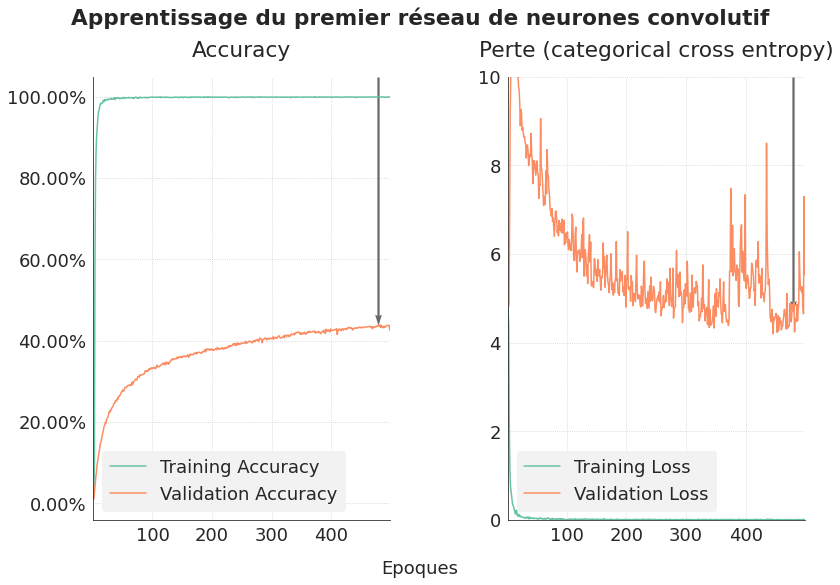

In [ ]:
fig, ax = graph_analysis_both("Apprentissage du premier réseau de neurones convolutif",
                              history_csv, is_csv=True)
save_fig("iml06_02_cnn")
plt.show()

In [ ]:
%tensorboard --logdir logs/02_cnn

<IPython.core.display.Javascript object>

<a id='3_2'></a>

### 3.2. CNN avec trois couches convolutionnelles, trois max pooling et une couche dense intermédiaire

Ce réseau de neurones reprend la structure du réseau précédent, en ajoutant une couche dense avec 240 neurones et une fonction d'activation Relu ainsi qu'une régularisation avec un dropout de 20%, entre l'applatissement de la sortie du dernier max pooling et la couche dense de classification.

In [ ]:
MODEL_NAME = "03_cnn_pmc"

In [ ]:
model3 = get_model_cnn(width_of_dense=240)
model3.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling_1 (Rescaling)      (None, 256, 256, 3)       0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 256, 256, 32)      896       
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 128, 128, 64)      18496     
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 64, 64, 64)        0         
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 64, 64, 128)       73856     
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 32, 32, 128)      

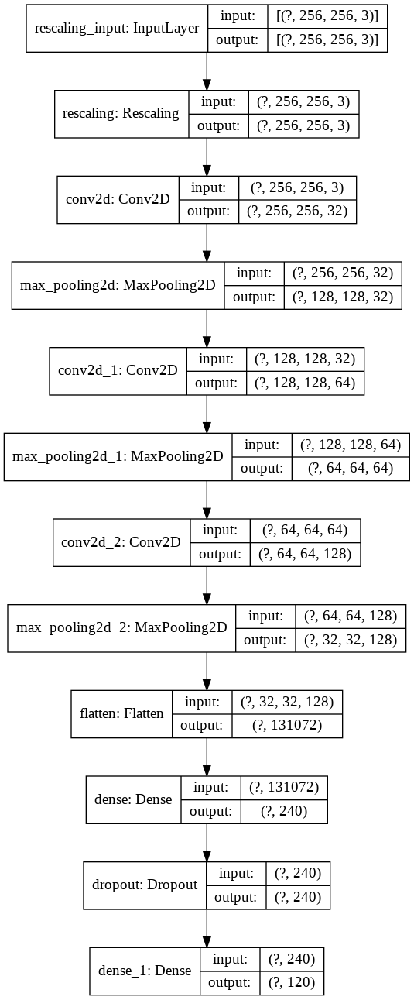

In [ ]:
plot_model(model3, to_file="plot_{}.png".format(MODEL_NAME), show_shapes=True)

In [ ]:
model3.compile(loss="sparse_categorical_crossentropy",
               optimizer="adam",
               metrics=["accuracy"])

In [ ]:
es_patience = 20
logdir = os.path.join("logs", MODEL_NAME, datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = TensorBoard(logdir, histogram_freq=1)
checkpoint_callback = ModelCheckpoint("model_{}.h5".format(MODEL_NAME),
                                      monitor="val_loss", save_best_only=True)
earlystop_callback = EarlyStopping(monitor='val_loss', mode="min", patience=es_patience,
                                   restore_best_weights=True)

In [ ]:
epochs = 1000
history3 = model3.fit(data_mini, validation_data=data_valid, verbose=2,
                     epochs=epochs, callbacks=[checkpoint_callback,
                                               earlystop_callback,
                                               tensorboard_callback])

Epoch 1/1000
83/83 - 26s - loss: 4.8542 - accuracy: 0.0056 - val_loss: 4.7863 - val_accuracy: 0.0112
Epoch 2/1000
83/83 - 25s - loss: 4.7780 - accuracy: 0.0139 - val_loss: 4.7820 - val_accuracy: 0.0143
Epoch 3/1000
83/83 - 23s - loss: 4.6836 - accuracy: 0.0271 - val_loss: 4.8104 - val_accuracy: 0.0243
Epoch 4/1000
83/83 - 23s - loss: 4.0059 - accuracy: 0.1438 - val_loss: 5.1005 - val_accuracy: 0.0312
Epoch 5/1000
83/83 - 23s - loss: 2.4242 - accuracy: 0.4612 - val_loss: 6.1286 - val_accuracy: 0.0458
Epoch 6/1000
83/83 - 23s - loss: 1.4646 - accuracy: 0.7120 - val_loss: 6.9798 - val_accuracy: 0.0634
Epoch 7/1000
83/83 - 23s - loss: 0.9481 - accuracy: 0.8181 - val_loss: 8.0279 - val_accuracy: 0.0786
Epoch 8/1000
83/83 - 23s - loss: 0.6636 - accuracy: 0.8799 - val_loss: 8.6670 - val_accuracy: 0.0895
Epoch 9/1000
83/83 - 23s - loss: 0.5399 - accuracy: 0.9160 - val_loss: 9.5692 - val_accuracy: 0.0968
Epoch 10/1000
83/83 - 24s - loss: 0.4495 - accuracy: 0.9285 - val_loss: 9.3967 - val_accura

Je sauvegarde les résultats dans un fichier csv pour pouvoir y revenir facilement.

In [ ]:
history3_csv = pd.DataFrame(history3.history)
history3_csv.to_csv("history_{}.csv".format(MODEL_NAME))

In [ ]:
history_csv = pd.read_csv("history_03_cnn_pmc.csv", index_col=0)
history_csv.head()

,loss,accuracy,val_loss,val_accuracy
0,4.854199,0.005648,4.786321,0.011226
1,4.778014,0.013931,4.781966,0.014260
2,4.683572,0.027108,4.810434,0.024272
3,4.005910,0.143825,5.100468,0.031250
4,2.424207,0.461220,6.128560,0.045813


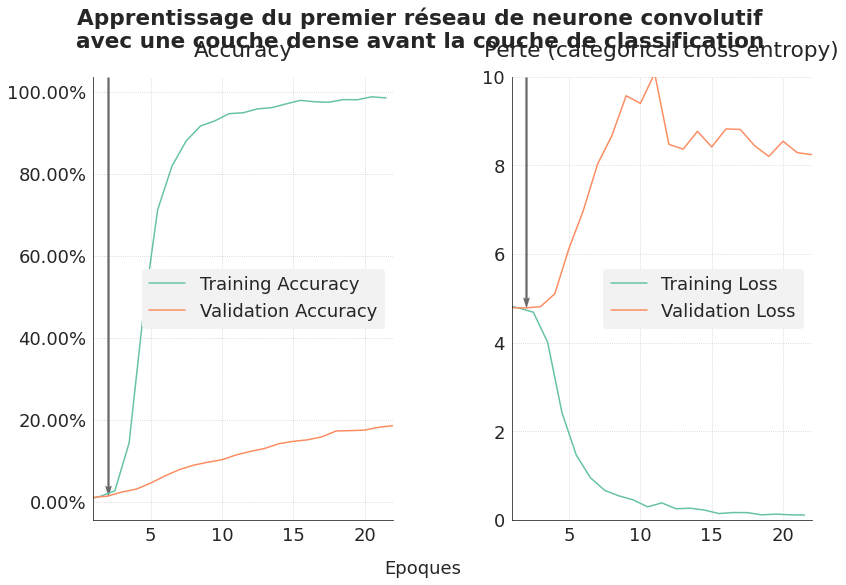

In [ ]:
fig, ax = graph_analysis_both("Apprentissage du premier réseau de neurone convolutif\navec une couche dense avant la couche de classification",
                              history_csv, is_csv=True)
plt.show()

Cette approche obtient des résultats similaires, mais les derniers résultats semblent pointer vers un meilleur potentiel d'amélioration en ajoutant des époques.

In [ ]:
model3.compile(loss="sparse_categorical_crossentropy",
               optimizer="adam",
               metrics=["accuracy"])

In [ ]:
es_patience = 20
logdir = os.path.join("logs", MODEL_NAME, datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = TensorBoard(logdir, histogram_freq=1)
checkpoint_callback = ModelCheckpoint("model_{}.h5".format(MODEL_NAME),
                                      monitor="val_accuracy", save_best_only=True)
earlystop_callback = EarlyStopping(monitor="val_accuracy", mode="max", patience=es_patience,
                                   restore_best_weights=True)

In [ ]:
epochs = 1000
history3 = model3.fit(data_mini, validation_data=data_valid, verbose=2,
                     epochs=epochs, callbacks=[checkpoint_callback,
                                               earlystop_callback,
                                               tensorboard_callback])

Epoch 1/1000
83/83 - 25s - loss: 4.6818 - accuracy: 0.0252 - val_loss: 4.7741 - val_accuracy: 0.0240
Epoch 2/1000
83/83 - 26s - loss: 3.8959 - accuracy: 0.1687 - val_loss: 4.9986 - val_accuracy: 0.0334
Epoch 3/1000
83/83 - 25s - loss: 2.1695 - accuracy: 0.5252 - val_loss: 5.5883 - val_accuracy: 0.0576
Epoch 4/1000
83/83 - 25s - loss: 1.2169 - accuracy: 0.7620 - val_loss: 7.2849 - val_accuracy: 0.0643
Epoch 5/1000
83/83 - 25s - loss: 0.7757 - accuracy: 0.8535 - val_loss: 8.7087 - val_accuracy: 0.0862
Epoch 6/1000
83/83 - 25s - loss: 0.6337 - accuracy: 0.8976 - val_loss: 8.7992 - val_accuracy: 0.0980
Epoch 7/1000
83/83 - 26s - loss: 0.4487 - accuracy: 0.9183 - val_loss: 8.5358 - val_accuracy: 0.1165
Epoch 8/1000
83/83 - 24s - loss: 0.4198 - accuracy: 0.9405 - val_loss: 8.9784 - val_accuracy: 0.1150
Epoch 9/1000
83/83 - 26s - loss: 0.3300 - accuracy: 0.9552 - val_loss: 8.8039 - val_accuracy: 0.1283
Epoch 10/1000
83/83 - 26s - loss: 0.2591 - accuracy: 0.9597 - val_loss: 8.4900 - val_accura

In [ ]:
history3_csv = pd.DataFrame(history3.history)
history3_csv.to_csv("history_{}_bis.csv".format(MODEL_NAME))

In [ ]:
history_csv = pd.read_csv("history_03_cnn_pmc_bis.csv", index_col=0)
history_csv.head()

,loss,accuracy,val_loss,val_accuracy
0,4.681846,0.025226,4.774115,0.023968
1,3.895905,0.168675,4.998557,0.033374
2,2.169453,0.525226,5.588310,0.057646
3,1.216928,0.762048,7.284861,0.064320
4,0.775710,0.853539,8.708670,0.086165


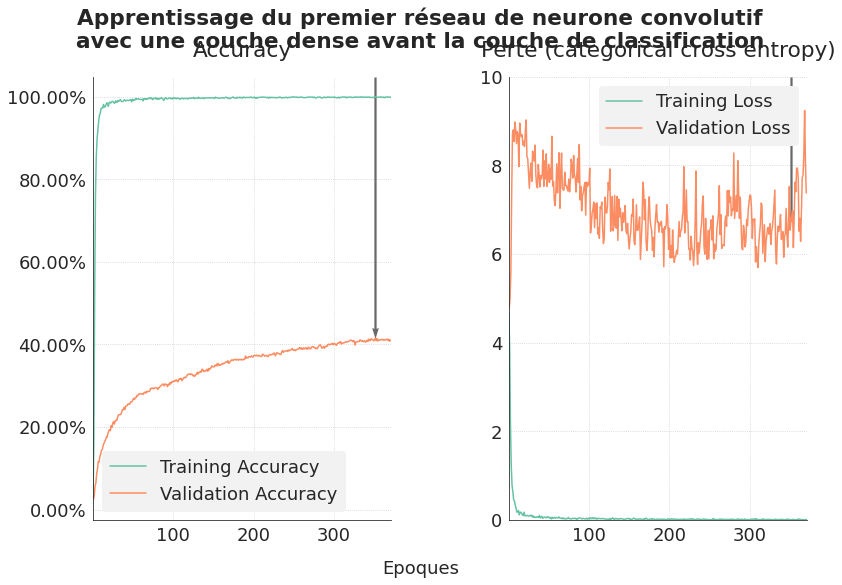

In [ ]:
fig, ax = graph_analysis_both("Apprentissage du premier réseau de neurone convolutif\navec une couche dense avant la couche de classification",
                              history_csv, is_csv=True)
save_fig("iml06_03_cnn_pmc")
plt.show()

In [ ]:
%tensorboard --logdir logs/03_cnn_pmc

<IPython.core.display.Javascript object>

L'ajout d'une couche dense augmente le nombre de paramètres sans améliorer les résultats. Je préfère pour l'instant rester sur un modèle CNN pur avec trois couches convolutionnelles et trois max pooling.

A partir de mes constatations sur ces premiers essais, j'applique désormais le Early Stopping sur l'accuracy de validation.

<a id='3_3'></a>

### 3.3. Intérêt du whitening et de l'equalization

Pour les tests suivants, je me base sur le modèle 2 : le CNN avec trois couches convolutionnelles et trois max pooling.  
Afin d'accélérer les tests, je ne base mes calculs que sur 10% des valeurs d'entraînement pour le fitting, tout en gardant toutes les données de validation pour calculer le score de validation.

In [ ]:
percent_data = 0.1
data_mini = data_train.take(int(np.ceil(percent_data * data_train.cardinality().numpy())))
print(data_mini.cardinality().numpy())

42


Je commence par entraîner le modèle 2 sans whitening ni equalization pour avoir une performance de base.  
Puis j'entraînerai le même modèle :
- avec du whitening ;
- avec de l'égalisation d'histogramme : je choisis d'utiliser l'algorithme Histogram Adaptatibe Equalization de scikit-image, qui présente l'avantage de gérer les contrastes au niveau des zones locales pour une image globale plus équilibrée.

Afin d'incorporer le whitening et/ou l'equalization, j'utiliserai la classe data augmentation de Keras sans augmentation, juste avec le pre-processing.  
Pour cela, j'ai besoin des données sous forme de numpy array. Je prépare ces tableaux numpy et je les sauvegarde pour pouvoir y revenir facilement.

In [ ]:
interdata = list(data_mini.unbatch().as_numpy_iterator())
inter_img = np.array([interdata[i][0] for i in range(len(interdata))])
inter_label = np.array([interdata[i][1] for i in range(len(interdata))])
np.save("data_mini_x.npy", inter_img)
np.save("data_mini_y.npy", inter_label)

#### 3.3.1. Définition du modèle

In [ ]:
MODEL_NAME = "04_cnn_whitening_equalization"

In [ ]:
model2 = get_model_cnn()
model2.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling_2 (Rescaling)      (None, 256, 256, 3)       0         
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 256, 256, 32)      896       
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 128, 128, 64)      18496     
_________________________________________________________________
max_pooling2d_7 (MaxPooling2 (None, 64, 64, 64)        0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 64, 64, 128)       73856     
_________________________________________________________________
max_pooling2d_8 (MaxPooling2 (None, 32, 32, 128)      

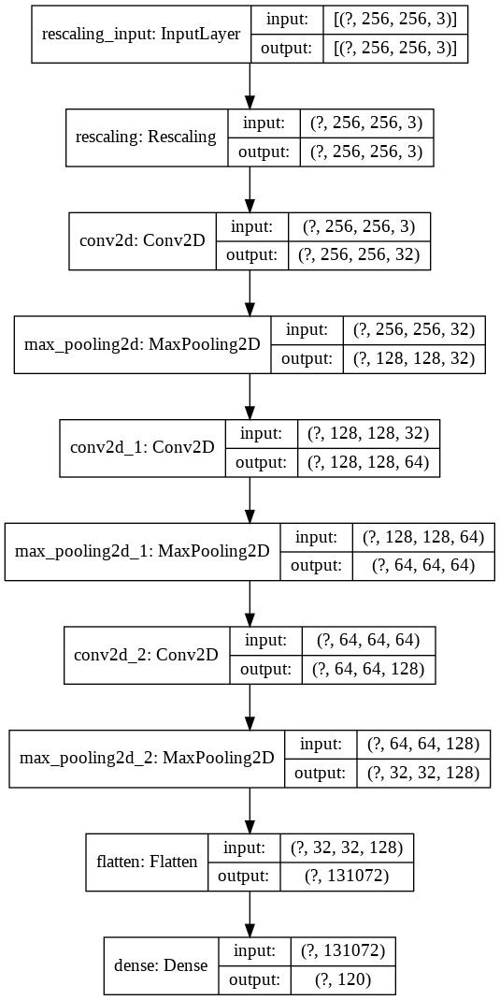

In [ ]:
plot_model(model2, to_file="plot_{}.png".format(MODEL_NAME), show_shapes=True)

#### 3.3.2. Performance du modèle de base

In [ ]:
SUB_MODEL = "model2_alone"

In [ ]:
model2.compile(loss="sparse_categorical_crossentropy",
               optimizer="adam",
               metrics=["accuracy"])

In [ ]:
es_patience = 20
logdir = os.path.join("logs", MODEL_NAME, SUB_MODEL)
tensorboard_callback = TensorBoard(logdir, histogram_freq=1)
checkpoint_callback = ModelCheckpoint("model_{}.h5".format(SUB_MODEL),
                                      monitor="val_accuracy", save_best_only=True)
earlystop_callback = EarlyStopping(monitor="val_accuracy", mode="max", patience=es_patience,
                                   restore_best_weights=True)

In [ ]:
epochs = 1000
history4 = model2.fit(data_mini, validation_data=data_valid, verbose=2,
                     epochs=epochs, callbacks=[checkpoint_callback,
                                               earlystop_callback,
                                               tensorboard_callback])

Epoch 1/1000
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
42/42 - 609s - loss: 5.0163 - accuracy: 0.0089 - val_loss: 4.7887 - val_accuracy: 0.0094
Epoch 2/1000
42/42 - 22s - loss: 4.7736 - accuracy: 0.0193 - val_loss: 4.7831 - val_accuracy: 0.0118
Epoch 3/1000
42/42 - 21s - loss: 4.6453 - accuracy: 0.0379 - val_loss: 4.8314 - val_accuracy: 0.0185
Epoch 4/1000
42/42 - 22s - loss: 3.5106 - accuracy: 0.2902 - val_loss: 5.7037 - val_accuracy: 0.0331
Epoch 5/1000
42/42 - 22s - loss: 1.7243 - accuracy: 0.6868 - val_loss: 5.8922 - val_accuracy: 0.0573
Epoch 6/1000
42/42 - 21s - loss: 1.1198 - accuracy: 0.8177 - val_loss: 6.5855 - val_accuracy: 0.0765
Epoch 7/1000
42/42 - 21s - loss: 0.7281 - accuracy: 0.8929 - val_loss: 7.8488 - val_accuracy: 0.0837
Epoch 8/1000
42/42 - 21s - loss: 0.6334 - accuracy: 0.9055 - val_loss: 8.1571 - val_accuracy: 0.1065
Epoch 9/1000
42/42 - 22s - loss: 0.3953 - accuracy: 0.9427 - val_loss: 8.7233 - val_accuracy: 0.1138
Epoch 10/1000
42/4

Je sauvegarde les résultats dans un fichier csv pour pouvoir y revenir facilement.

In [ ]:
history4_csv = pd.DataFrame(history4.history)
history4_csv.to_csv("history_{}.csv".format(SUB_MODEL))

In [ ]:
history_csv = pd.read_csv("history_model2_alone.csv", index_col=0)
history_csv.head()

,loss,accuracy,val_loss,val_accuracy
0,5.016328,0.008929,4.788666,0.009405
1,4.773577,0.019345,4.783146,0.011833
2,4.645268,0.037946,4.831415,0.018507
3,3.510624,0.290179,5.703714,0.033070
4,1.724344,0.686756,5.892240,0.057342


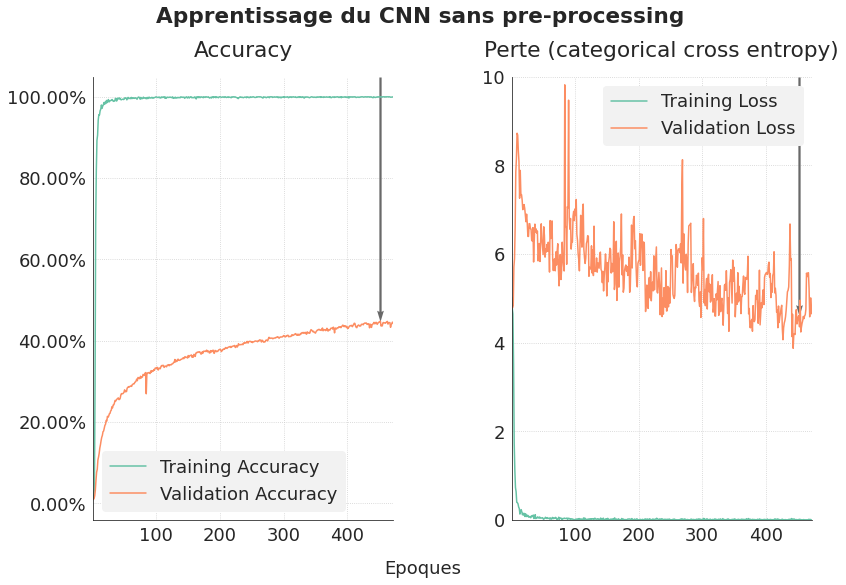

In [ ]:
fig, ax = graph_analysis_both("Apprentissage du CNN sans pre-processing",
                              history_csv, is_csv=True)
plt.show()

La performance de validation obtenue avec 10% des données d'entraînement est légèrement supérieure en restant très similaire à celle obtenue avec 20% des données, au niveau de l'accuracy (44,81% contre 43,87%) comme au niveau de la perte (4,61 contre 4,70).

#### 3.3.3. Performance du modèle avec Whitening

In [ ]:
x_train = np.load("data_mini_x.npy")
y_train = np.load("data_mini_y.npy")

In [ ]:
len(x_train)

1344

**ZCA whitening**

Le ZCA Whitening n'est pas possible à cause des ressources mémoires insuffisantes. Cette méthode implique une multiplication matricielle trop gourmande en ressources.  
Je teste à la place une normalisation par features et une normalisation par samples.

**Normalisation par features**

In [ ]:
MODEL_NAME = "04_cnn_whitening_equalization"
SUB_MODEL = "model2_normalization_features"

Le rescaling est désormais pris en charge par l'Image Data Generator.  
J'utilise désormais une fonction sigmoïde comme fonction d'activation de la première couche, car mes données centrées réduites auront des valeurs négatives que je veux ramener dans des valeurs positives.

In [ ]:
model2 = get_model_cnn(with_rescaling=False, first_activation_relu=False)
model2.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_12 (Conv2D)           (None, 256, 256, 32)      896       
_________________________________________________________________
max_pooling2d_12 (MaxPooling (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_13 (Conv2D)           (None, 128, 128, 64)      18496     
_________________________________________________________________
max_pooling2d_13 (MaxPooling (None, 64, 64, 64)        0         
_________________________________________________________________
conv2d_14 (Conv2D)           (None, 64, 64, 128)       73856     
_________________________________________________________________
max_pooling2d_14 (MaxPooling (None, 32, 32, 128)       0         
_________________________________________________________________
flatten_4 (Flatten)          (None, 131072)           

In [ ]:
es_patience = 20
logdir = os.path.join("logs", MODEL_NAME, SUB_MODEL)
tensorboard_callback = TensorBoard(logdir, histogram_freq=1)
checkpoint_callback = ModelCheckpoint("model_{}.h5".format(SUB_MODEL),
                                      monitor="val_accuracy", save_best_only=True)
earlystop_callback = EarlyStopping(monitor="val_accuracy", mode="max", patience=es_patience,
                                   restore_best_weights=True)

In [ ]:
datagen = ImageDataGenerator(featurewise_center=True,
                             featurewise_std_normalization=True)
datagen.fit(x_train)

In [ ]:
epochs = 1000
history5 = model2.fit(datagen.flow(x_train, y_train, batch_size=BATCH_SIZE),
                      validation_data=data_valid, verbose=2,
                      epochs=epochs, callbacks=[checkpoint_callback,
                                                earlystop_callback,
                                                tensorboard_callback])

Epoch 1/1000
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
42/42 - 874s - loss: 5.7763 - accuracy: 0.0037 - val_loss: 4.7874 - val_accuracy: 0.0094
Epoch 2/1000
42/42 - 17s - loss: 4.7746 - accuracy: 0.0112 - val_loss: 4.8423 - val_accuracy: 0.0070
Epoch 3/1000
42/42 - 16s - loss: 4.7617 - accuracy: 0.0141 - val_loss: 4.7874 - val_accuracy: 0.0091
Epoch 4/1000
42/42 - 17s - loss: 4.7539 - accuracy: 0.0141 - val_loss: 4.7870 - val_accuracy: 0.0106
Epoch 5/1000
42/42 - 16s - loss: 4.7460 - accuracy: 0.0141 - val_loss: 4.7874 - val_accuracy: 0.0067
Epoch 6/1000
42/42 - 16s - loss: 4.7361 - accuracy: 0.0119 - val_loss: 4.7898 - val_accuracy: 0.0070
Epoch 7/1000
42/42 - 16s - loss: 4.7174 - accuracy: 0.0193 - val_loss: 4.8167 - val_accuracy: 0.0067
Epoch 8/1000
42/42 - 16s - loss: 4.6577 - accuracy: 0.0231 - val_loss: 5.2771 - val_accuracy: 0.0055
Epoch 9/1000
42/42 - 16s - loss: 4.3112 - accuracy: 0.1272 - val_loss: 6.3855 - val_accuracy: 0.0061
Epoch 10/1000
42/4

Je sauvegarde les résultats dans un fichier csv pour pouvoir y revenir facilement.

In [ ]:
history5_csv = pd.DataFrame(history5.history)
history5_csv.to_csv("history_{}.csv".format(SUB_MODEL))

In [ ]:
history_csv = pd.read_csv("history_model2_normalization_features.csv", index_col=0)
history_csv.head()

,loss,accuracy,val_loss,val_accuracy
0,5.776328,0.003720,4.787417,0.009405
1,4.774618,0.011161,4.842255,0.006978
2,4.761684,0.014137,4.787412,0.009102
3,4.753886,0.014137,4.787048,0.010619
4,4.745963,0.014137,4.787380,0.006675


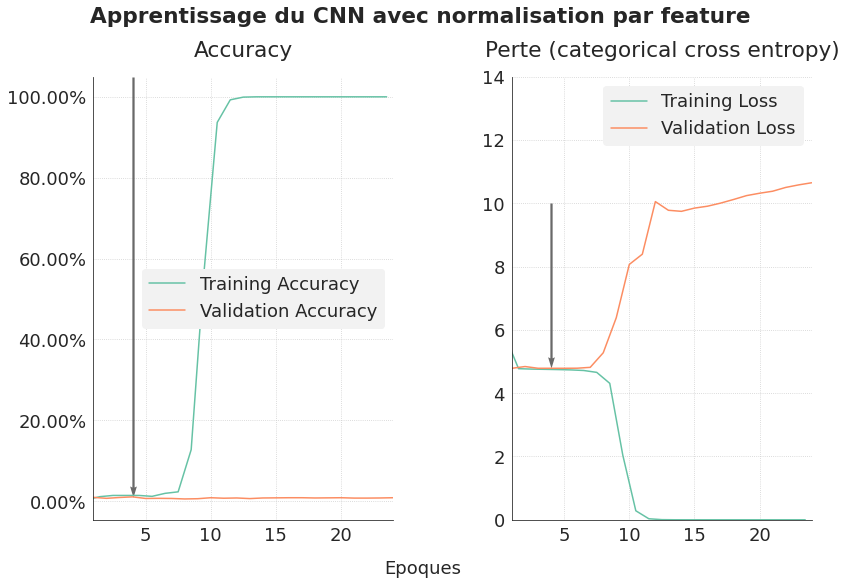

In [ ]:
fig, ax = graph_analysis_both("Apprentissage du CNN avec normalisation par feature",
                              history_csv, is_csv=True)
ax[1].set_ylim([0, 14])
plt.show()

La normalisation par features dégrade la performance de validation. Cette approche n'est pas adaptée à notre problématique.

**Normalisation par samples**

In [ ]:
SUB_MODEL = "model2_normalization_samples"

In [ ]:
model2 = get_model_cnn(with_rescaling=False, first_activation_relu=False)
model2.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 256, 256, 32)      896       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 128, 128, 64)      18496     
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 64, 64, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 64, 64, 128)       73856     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 32, 32, 128)       0         
_________________________________________________________________
flatten (Flatten)            (None, 131072)            0

In [ ]:
es_patience = 20
logdir = os.path.join("logs", MODEL_NAME, SUB_MODEL)
tensorboard_callback = TensorBoard(logdir, histogram_freq=1)
checkpoint_callback = ModelCheckpoint("model_{}.h5".format(SUB_MODEL),
                                      monitor="val_accuracy", save_best_only=True)
earlystop_callback = EarlyStopping(monitor="val_accuracy", mode="max", patience=es_patience,
                                   restore_best_weights=True)

In [ ]:
datagen = ImageDataGenerator(samplewise_center=True,
                             samplewise_std_normalization=True)

In [ ]:
epochs = 1000
history6 = model2.fit(datagen.flow(x_train, y_train, batch_size=BATCH_SIZE),
                      validation_data=data_valid, verbose=2,
                      epochs=epochs, callbacks=[checkpoint_callback,
                                                earlystop_callback,
                                                tensorboard_callback])

Epoch 1/1000
42/42 - 18s - loss: 5.6845 - accuracy: 0.0097 - val_loss: 4.7870 - val_accuracy: 0.0079
Epoch 2/1000
42/42 - 17s - loss: 4.7858 - accuracy: 0.0082 - val_loss: 4.7871 - val_accuracy: 0.0067
Epoch 3/1000
42/42 - 16s - loss: 4.7831 - accuracy: 0.0141 - val_loss: 4.7871 - val_accuracy: 0.0073
Epoch 4/1000
42/42 - 16s - loss: 4.7811 - accuracy: 0.0097 - val_loss: 4.7869 - val_accuracy: 0.0079
Epoch 5/1000
42/42 - 16s - loss: 4.7793 - accuracy: 0.0119 - val_loss: 4.7870 - val_accuracy: 0.0070
Epoch 6/1000
42/42 - 16s - loss: 4.7774 - accuracy: 0.0112 - val_loss: 4.7872 - val_accuracy: 0.0067
Epoch 7/1000
42/42 - 17s - loss: 4.7781 - accuracy: 0.0104 - val_loss: 4.7870 - val_accuracy: 0.0094
Epoch 8/1000
42/42 - 16s - loss: 4.7741 - accuracy: 0.0089 - val_loss: 4.7872 - val_accuracy: 0.0094
Epoch 9/1000
42/42 - 16s - loss: 4.7724 - accuracy: 0.0112 - val_loss: 4.7875 - val_accuracy: 0.0085
Epoch 10/1000
42/42 - 16s - loss: 4.7709 - accuracy: 0.0112 - val_loss: 4.7876 - val_accura

Je sauvegarde les résultats dans un fichier csv pour pouvoir y revenir facilement.

In [ ]:
history6_csv = pd.DataFrame(history6.history)
history6_csv.to_csv("history_{}.csv".format(SUB_MODEL))

In [ ]:
history_csv = pd.read_csv("history_model2_normalization_samples.csv", index_col=0)
history_csv.head()

,loss,accuracy,val_loss,val_accuracy
0,5.684525,0.009673,4.787035,0.007888
1,4.785843,0.008185,4.787080,0.006675
2,4.783137,0.014137,4.787072,0.007282
3,4.781116,0.009673,4.786923,0.007888
4,4.779301,0.011905,4.786966,0.006978


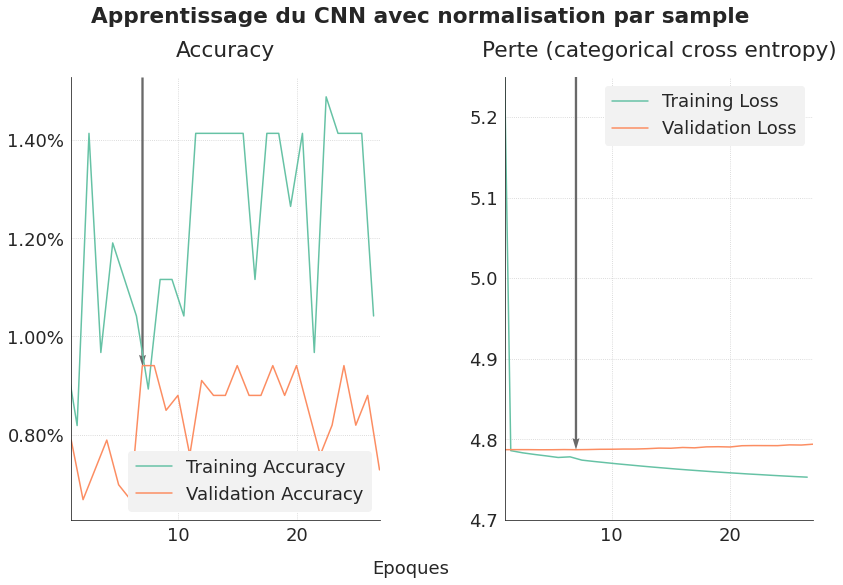

In [ ]:
fig, ax = graph_analysis_both("Apprentissage du CNN avec normalisation par sample",
                              history_csv, is_csv=True)
ax[1].set_ylim([4.7, 5.25])
plt.show()

La normalisation par sample dégrade l'accuracy, de training comme de validation. Cette approche n'est pas adaptée à notre problématique.

#### 3.3.4. Modèle avec Histogram Adaptative Equalization

In [ ]:
SUB_MODEL = "model2_equalization"

In [ ]:
model2 = get_model_cnn(with_rescaling=False, first_activation_relu=True)
model2.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 256, 256, 32)      896       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 128, 128, 64)      18496     
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 64, 64, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 64, 64, 128)       73856     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 32, 32, 128)       0         
_________________________________________________________________
flatten (Flatten)            (None, 131072)            0

In [ ]:
es_patience = 20
logdir = os.path.join("logs", MODEL_NAME, SUB_MODEL)
tensorboard_callback = TensorBoard(logdir, histogram_freq=1)
checkpoint_callback = ModelCheckpoint("model_{}.h5".format(SUB_MODEL),
                                      monitor="val_accuracy", save_best_only=True)
earlystop_callback = EarlyStopping(monitor="val_accuracy", mode="max", patience=es_patience,
                                   restore_best_weights=True)

In [ ]:
def histo_adaptative_equal(image):
    # Line below is needed, because equalize_adapthist works in pixel value range (0,1)
    image = image / 255.

    # h, w = image.shape[:2]
    # Line below is required, because equalize_adapthist works on arrays with shape (h,w)
    # image = np.resize(image, (h,w))
    img_adapteq = exposure.equalize_adapthist(image, clip_limit=0.03)

    # I back-resize, because keras works with arrays with shape (h,w,channels)
    #img_adapteq = np.resize(img_adapteq, (h,w,1))

    return img_adapteq

In [ ]:
datagen = ImageDataGenerator(preprocessing_function=histo_adaptative_equal)

In [ ]:
epochs = 1000
history7 = model2.fit(datagen.flow(x_train, y_train, batch_size=BATCH_SIZE),
                      validation_data=data_valid, verbose=2,
                      epochs=epochs, callbacks=[checkpoint_callback,
                                                earlystop_callback,
                                                tensorboard_callback])

Epoch 1/1000
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
42/42 - 1300s - loss: 5.1709 - accuracy: 0.0082 - val_loss: 24.6869 - val_accuracy: 0.0064
Epoch 2/1000
42/42 - 65s - loss: 4.7607 - accuracy: 0.0149 - val_loss: 31.6645 - val_accuracy: 0.0112
Epoch 3/1000
42/42 - 63s - loss: 4.6234 - accuracy: 0.0335 - val_loss: 111.3645 - val_accuracy: 0.0127
Epoch 4/1000
42/42 - 64s - loss: 3.1932 - accuracy: 0.3869 - val_loss: 470.7639 - val_accuracy: 0.0273
Epoch 5/1000
42/42 - 64s - loss: 0.1777 - accuracy: 0.9710 - val_loss: 857.2894 - val_accuracy: 0.0331
Epoch 6/1000
42/42 - 61s - loss: 0.0146 - accuracy: 0.9970 - val_loss: 922.8825 - val_accuracy: 0.0325
Epoch 7/1000
42/42 - 62s - loss: 0.0015 - accuracy: 1.0000 - val_loss: 912.1549 - val_accuracy: 0.0370
Epoch 8/1000
42/42 - 61s - loss: 2.5663e-04 - accuracy: 1.0000 - val_loss: 943.2846 - val_accuracy: 0.0328
Epoch 9/1000
42/42 - 62s - loss: 1.5441e-04 - accuracy: 1.0000 - val_loss: 972.5453 - val_accuracy: 

Je sauvegarde les résultats dans un fichier csv pour pouvoir y revenir facilement.

In [ ]:
history7_csv = pd.DataFrame(history7.history)
history7_csv.to_csv("history_{}.csv".format(SUB_MODEL))

In [ ]:
history_csv = pd.read_csv("history_model2_equalization.csv", index_col=0)
history_csv.head()

,loss,accuracy,val_loss,val_accuracy
0,5.170950,0.008185,24.686888,0.006371
1,4.760673,0.014881,31.664490,0.011226
2,4.623401,0.033482,111.364487,0.012743
3,3.193250,0.386905,470.763916,0.027306
4,0.177713,0.970982,857.289429,0.033070


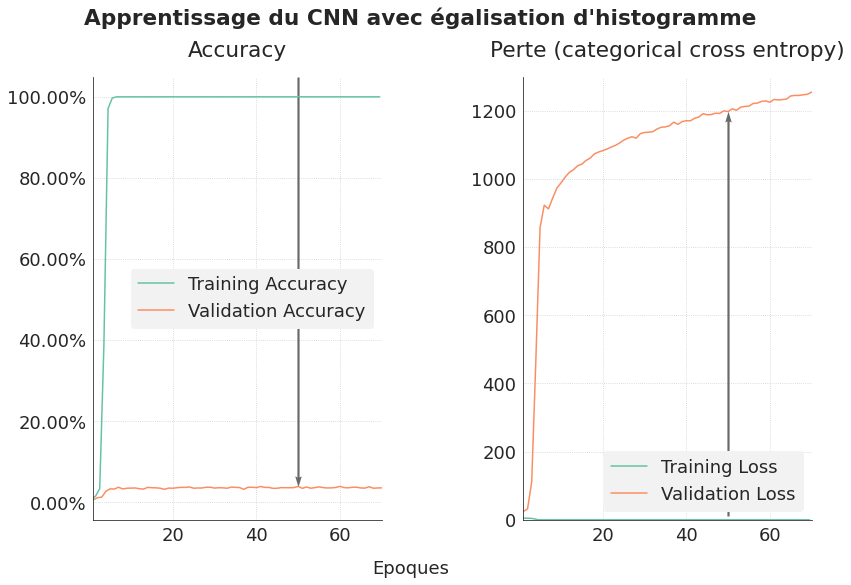

In [ ]:
fig, ax = graph_analysis_both("Apprentissage du CNN avec égalisation d'histogramme",
                              history_csv, is_csv=True)
ax[1].set_ylim([0, 1300])
plt.show()

L'égalisation n'aboutit pas à de bons résultats. Je vérifie si les résultats sont meilleurs en utilisant des données en noir et blanc.

In [ ]:
SUB_MODEL = "model2_equalization_nb"

In [ ]:
model2 = get_model_cnn(with_rescaling=False, first_activation_relu=True)
model2.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_6 (Conv2D)            (None, 256, 256, 32)      896       
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 128, 128, 64)      18496     
_________________________________________________________________
max_pooling2d_7 (MaxPooling2 (None, 64, 64, 64)        0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 64, 64, 128)       73856     
_________________________________________________________________
max_pooling2d_8 (MaxPooling2 (None, 32, 32, 128)       0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 131072)           

In [ ]:
es_patience = 20
logdir = os.path.join("logs", MODEL_NAME, SUB_MODEL)
tensorboard_callback = TensorBoard(logdir, histogram_freq=1)
checkpoint_callback = ModelCheckpoint("model_{}.h5".format(SUB_MODEL),
                                      monitor="val_accuracy", save_best_only=True)
earlystop_callback = EarlyStopping(monitor="val_accuracy", mode="max", patience=es_patience,
                                   restore_best_weights=True)

In [ ]:
def histo_adaptative_equal(image):
    # Line below is needed, because equalize_adapthist works in pixel value range (0,1)
    image = image / 255.
    image = rgb2gray(image)

    h, w = image.shape[:2]
    # Line below is required, because equalize_adapthist works on arrays with shape (h,w)
    # image = np.resize(image, (h,w))
    img_adapteq = exposure.equalize_adapthist(image, clip_limit=0.03)

    # I back-resize, because keras works with arrays with shape (h,w,channels)
    img_adapteq = np.resize(img_adapteq, (h, w, 1))

    return img_adapteq

In [ ]:
datagen = ImageDataGenerator(preprocessing_function=histo_adaptative_equal)

In [ ]:
epochs = 1000
history8 = model2.fit(datagen.flow(x_train, y_train, batch_size=BATCH_SIZE),
                      validation_data=data_valid, verbose=2,
                      epochs=epochs, callbacks=[checkpoint_callback,
                                                earlystop_callback,
                                                tensorboard_callback])

Epoch 1/1000
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
42/42 - 1480s - loss: 5.1228 - accuracy: 0.0074 - val_loss: 4.8195 - val_accuracy: 0.0112
Epoch 2/1000
42/42 - 32s - loss: 4.7907 - accuracy: 0.0119 - val_loss: 5.1164 - val_accuracy: 0.0146
Epoch 3/1000
42/42 - 30s - loss: 4.7788 - accuracy: 0.0231 - val_loss: 119.7120 - val_accuracy: 0.0076
Epoch 4/1000
42/42 - 31s - loss: 4.6895 - accuracy: 0.0327 - val_loss: 90.3112 - val_accuracy: 0.0182
Epoch 5/1000
42/42 - 31s - loss: 2.7648 - accuracy: 0.4479 - val_loss: 505.1569 - val_accuracy: 0.0334
Epoch 6/1000
42/42 - 31s - loss: 0.1321 - accuracy: 0.9688 - val_loss: 885.2485 - val_accuracy: 0.0391
Epoch 7/1000
42/42 - 31s - loss: 0.0089 - accuracy: 0.9985 - val_loss: 1017.6481 - val_accuracy: 0.0419
Epoch 8/1000
42/42 - 30s - loss: 8.8762e-04 - accuracy: 1.0000 - val_loss: 1062.4240 - val_accuracy: 0.0397
Epoch 9/1000
42/42 - 29s - loss: 2.0352e-04 - accuracy: 1.0000 - val_loss: 1103.9092 - val_accuracy: 

Je sauvegarde les résultats dans un fichier csv pour pouvoir y revenir facilement.

In [ ]:
history8_csv = pd.DataFrame(history8.history)
history8_csv.to_csv("history_{}.csv".format(SUB_MODEL))

In [ ]:
history_csv = pd.read_csv("history_model2_equalization_nb.csv", index_col=0)
history_csv.head()

,loss,accuracy,val_loss,val_accuracy
0,5.122805,0.007440,4.819494,0.011226
1,4.790678,0.011905,5.116425,0.014563
2,4.778821,0.023065,119.712036,0.007585
3,4.689532,0.032738,90.311195,0.018204
4,2.764822,0.447917,505.156891,0.033374


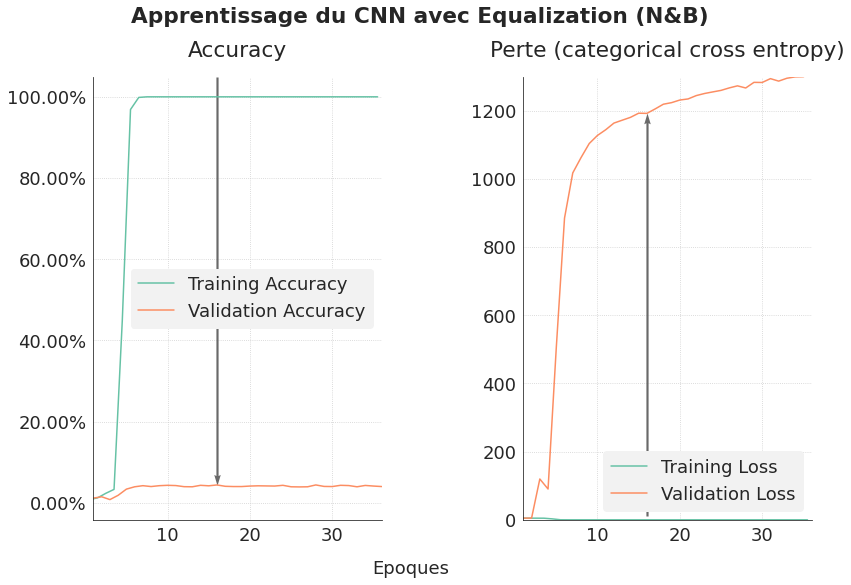

In [ ]:
fig, ax = graph_analysis_both("Apprentissage du CNN avec Equalization (N&B)",
                              history_csv, is_csv=True)
ax[1].set_ylim([0, 1300])
plt.show()

Les résultats ne sont pas meilleurs avec l'égalisation sur les données en N&B.

La normalisation ou l'égalisation ne semblent pas pertinents dans notre cas.

<a id='3_4'></a>

### 3.4. Intérêt de la data augmentation

In [ ]:
x_train = np.load("data_mini_x.npy")
y_train = np.load("data_mini_y.npy")

In [ ]:
MODEL_NAME = "05_cnn_data_augmentation"

Je réalise une data augmentation aléatoire avec l'objet Image Data Generator de Keras, qui effectue également le rescaling.  
Afin d'être le plus complet possible, j'autorise les transformations suivantes :
- rotation range = 20 -> rotation de l'image limitée à 20° ;
- width_shift_range = 0.2 -> décalage de l'image de 20% sur la largeur ;
- height_shift_range = 0.2 -> décalage de l'image de 20% sur la largeur ;
- brightness_range = [0.9 ; 1.1] -> changement de la luminosité entre -10% (assombrissement) et +10% (éclaircissement) de l'image originale ;
- zoom_range = [0.9 ; 1.1] -> zoom et "dé-zoom" entre +10% et -10% ;
- horizontal_flip = True -> retournement horizontal de l'image ;
- fill_mode = Nearest -> valeur par défaut : recopie les pixels les plus proches lorsqu'il y a des pixels manquant.


In [ ]:
datagen = ImageDataGenerator(rotation_range=20, width_shift_range=0.2,
                             height_shift_range=0.2, brightness_range=[0.9, 1.1],
                             zoom_range=[0.9, 1.1], horizontal_flip=True,
                             rescale=1./255)

In [ ]:
model2 = get_model_cnn(with_rescaling=False, first_activation_relu=True)
model2.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 256, 256, 32)      896       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 128, 128, 64)      18496     
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 64, 64, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 64, 64, 128)       73856     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 32, 32, 128)       0         
_________________________________________________________________
flatten (Flatten)            (None, 131072)            0

In [ ]:
es_patience = 20
logdir = os.path.join("logs", MODEL_NAME, datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = TensorBoard(logdir, histogram_freq=1)
checkpoint_callback = ModelCheckpoint("model_{}.h5".format(MODEL_NAME),
                                      monitor="val_accuracy", save_best_only=True)
earlystop_callback = EarlyStopping(monitor="val_accuracy", mode="max", patience=es_patience,
                                   restore_best_weights=True)

In [ ]:
epochs = 1000
history9 = model2.fit(datagen.flow(x_train, y_train, batch_size=BATCH_SIZE),
                      validation_data=data_valid, verbose=2,
                      epochs=epochs, callbacks=[checkpoint_callback,
                                                earlystop_callback,
                                                tensorboard_callback])

Epoch 1/1000
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
42/42 - 2189s - loss: 5.0135 - accuracy: 0.0060 - val_loss: 22.7633 - val_accuracy: 0.0094
Epoch 2/1000
42/42 - 46s - loss: 4.7714 - accuracy: 0.0164 - val_loss: 40.5493 - val_accuracy: 0.0124
Epoch 3/1000
42/42 - 43s - loss: 4.7611 - accuracy: 0.0156 - val_loss: 261.6186 - val_accuracy: 0.0073
Epoch 4/1000
42/42 - 43s - loss: 4.7204 - accuracy: 0.0238 - val_loss: 320.2321 - val_accuracy: 0.0079
Epoch 5/1000
42/42 - 42s - loss: 4.6616 - accuracy: 0.0283 - val_loss: 245.8608 - val_accuracy: 0.0121
Epoch 6/1000
42/42 - 44s - loss: 4.5724 - accuracy: 0.0357 - val_loss: 357.1966 - val_accuracy: 0.0225
Epoch 7/1000
42/42 - 43s - loss: 4.4887 - accuracy: 0.0432 - val_loss: 436.7012 - val_accuracy: 0.0203
Epoch 8/1000
42/42 - 44s - loss: 4.3761 - accuracy: 0.0476 - val_loss: 538.1357 - val_accuracy: 0.0218
Epoch 9/1000
42/42 - 44s - loss: 4.2828 - accuracy: 0.0595 - val_loss: 509.7021 - val_accuracy: 0.0231
E

Je sauvegarde les résultats dans un fichier csv pour pouvoir y revenir facilement.

In [ ]:
history9_csv = pd.DataFrame(history9.history)
history9_csv.to_csv("history_{}.csv".format(MODEL_NAME))

In [ ]:
history_csv = pd.read_csv("history_05_cnn_data_augmentation.csv", index_col=0)
history_csv.head()

,loss,accuracy,val_loss,val_accuracy
0,5.068691,0.009673,10.286198,0.015170
1,4.773494,0.010417,50.886581,0.014563
2,4.752160,0.023065,129.403488,0.013653
3,4.712201,0.020089,103.555702,0.012743
4,4.644791,0.027530,117.707748,0.016080


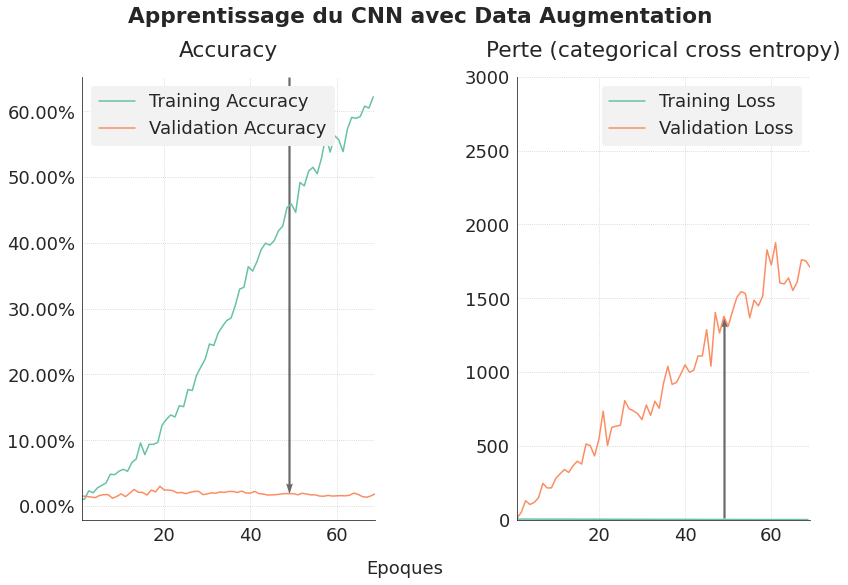

In [ ]:
fig, ax = graph_analysis_both("Apprentissage du CNN avec Data Augmentation",
                              history_csv, is_csv=True)
ax[1].set_ylim([0, 3000])
plt.show()

L'accuracy augmente beaucoup plus lentement du fait de l'utilisation de l'augmentation. Je refais une tentative avec une patience plus élevée (50 époques au lieu de 20) et en limitant l'angle de rotation à 10° afin d'avoir une augmentation moins agressive.

In [ ]:
datagen = ImageDataGenerator(rotation_range=10, width_shift_range=0.2,
                             height_shift_range=0.2, brightness_range=[0.9, 1.1],
                             zoom_range=[0.9, 1.1], horizontal_flip=True,
                             rescale=1./255)

In [ ]:
model2 = get_model_cnn(with_rescaling=False, first_activation_relu=True)
model2.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_12 (Conv2D)           (None, 256, 256, 32)      896       
_________________________________________________________________
max_pooling2d_12 (MaxPooling (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_13 (Conv2D)           (None, 128, 128, 64)      18496     
_________________________________________________________________
max_pooling2d_13 (MaxPooling (None, 64, 64, 64)        0         
_________________________________________________________________
conv2d_14 (Conv2D)           (None, 64, 64, 128)       73856     
_________________________________________________________________
max_pooling2d_14 (MaxPooling (None, 32, 32, 128)       0         
_________________________________________________________________
flatten_4 (Flatten)          (None, 131072)           

In [ ]:
es_patience = 50
logdir = os.path.join("logs", MODEL_NAME, datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = TensorBoard(logdir, histogram_freq=1)
checkpoint_callback = ModelCheckpoint("model_{}.h5".format(MODEL_NAME),
                                      monitor="val_accuracy", save_best_only=True)
earlystop_callback = EarlyStopping(monitor="val_accuracy", mode="max", patience=es_patience,
                                   restore_best_weights=True)

In [ ]:
epochs = 1000
history10 = model2.fit(datagen.flow(x_train, y_train, batch_size=BATCH_SIZE),
                       validation_data=data_valid, verbose=2,
                       epochs=epochs, callbacks=[checkpoint_callback,
                                                 earlystop_callback,
                                                 tensorboard_callback])

Epoch 1/1000
42/42 - 39s - loss: 5.0687 - accuracy: 0.0097 - val_loss: 10.2862 - val_accuracy: 0.0152
Epoch 2/1000
42/42 - 38s - loss: 4.7735 - accuracy: 0.0104 - val_loss: 50.8866 - val_accuracy: 0.0146
Epoch 3/1000
42/42 - 37s - loss: 4.7522 - accuracy: 0.0231 - val_loss: 129.4035 - val_accuracy: 0.0137
Epoch 4/1000
42/42 - 37s - loss: 4.7122 - accuracy: 0.0201 - val_loss: 103.5557 - val_accuracy: 0.0127
Epoch 5/1000
42/42 - 39s - loss: 4.6448 - accuracy: 0.0275 - val_loss: 117.7077 - val_accuracy: 0.0161
Epoch 6/1000
42/42 - 39s - loss: 4.5995 - accuracy: 0.0312 - val_loss: 149.2230 - val_accuracy: 0.0173
Epoch 7/1000
42/42 - 39s - loss: 4.5666 - accuracy: 0.0350 - val_loss: 246.6270 - val_accuracy: 0.0173
Epoch 8/1000
42/42 - 37s - loss: 4.5042 - accuracy: 0.0484 - val_loss: 215.5914 - val_accuracy: 0.0118
Epoch 9/1000
42/42 - 37s - loss: 4.4465 - accuracy: 0.0476 - val_loss: 216.2267 - val_accuracy: 0.0146
Epoch 10/1000
42/42 - 38s - loss: 4.4096 - accuracy: 0.0528 - val_loss: 280

Je sauvegarde les résultats dans un fichier csv pour pouvoir y revenir facilement.

In [ ]:
history10_csv = pd.DataFrame(history10.history)
history10_csv.to_csv("history_{}_bis.csv".format(MODEL_NAME))

In [ ]:
history_csv = pd.read_csv("history_05_cnn_data_augmentation_bis.csv", index_col=0)
history_csv.head()

,loss,accuracy,val_loss,val_accuracy
0,5.068691,0.009673,10.286198,0.015170
1,4.773494,0.010417,50.886581,0.014563
2,4.752160,0.023065,129.403488,0.013653
3,4.712201,0.020089,103.555702,0.012743
4,4.644791,0.027530,117.707748,0.016080


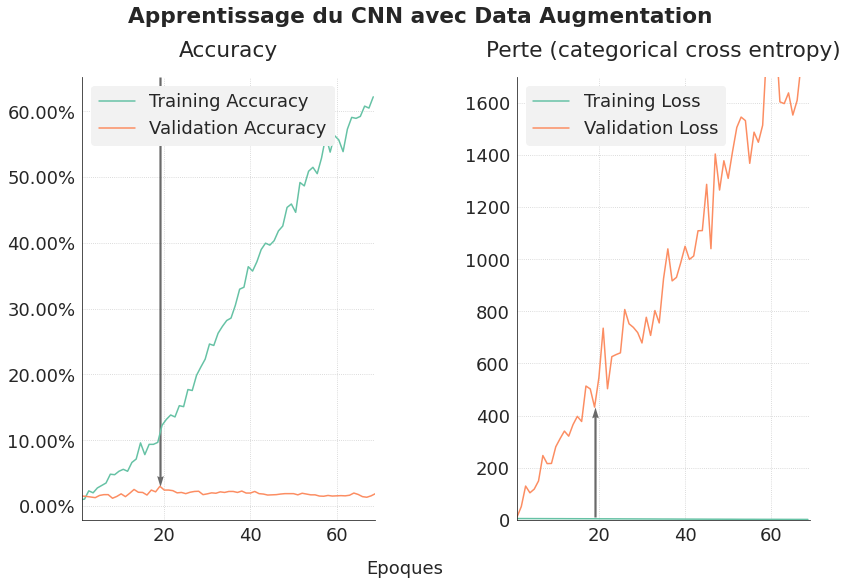

In [ ]:
fig, ax = graph_analysis_both("Apprentissage du CNN avec Data Augmentation",
                              history_csv, is_csv=True, es_patience=50)
ax[1].set_ylim([0, 1700])
plt.show()

L'accuracy de validation plafonne à un niveau décevant. La data augmentation ne paraît pas adaptée à notre cas. Cela peut être dû au fait que nous avons déjà des images très diversifiées, en terme de point de vue et de cadrage, dans notre jeu d'entraînement et de validation.

Je cherche d'autres méthodes pour améliorer mon réseau de neurones convolutif.

---
<a id='4_0'></a>

## <font color=blue> 4. Améliorer le modèle CNN sans couche dense intermédiaire</font>

Les résultats obtenus jusqu'à maintenant montrent que le meilleur modèle est obtenu avec le modèle CNN avec trois couches convolutionnelles et trois max pooling, sans preprocessing ou augmentation de données.

Je n'utilise que 10% des données pour l'entraînement, afin d'accélérer les temps de calcul.

In [ ]:
percent_data = 0.1
data_mini = data_train.take(int(np.ceil(percent_data * data_train.cardinality().numpy())))
print(data_mini.cardinality().numpy())

42


### 4.1. Réduire l'overfitting du modèle en le régularisant

Les résultats montraient un fort overfitting, avec une accuracy d'entraînement qui monte très rapidement aux environs de 100% et une accuracy de validation qui augmente doucement pour plafonner aux alentours de 45%.  
Cet overfitting élevé laisse présager de mauvaises performances de généralisation.

In [ ]:
history_csv = pd.read_csv("history_model2_alone.csv", index_col=0)

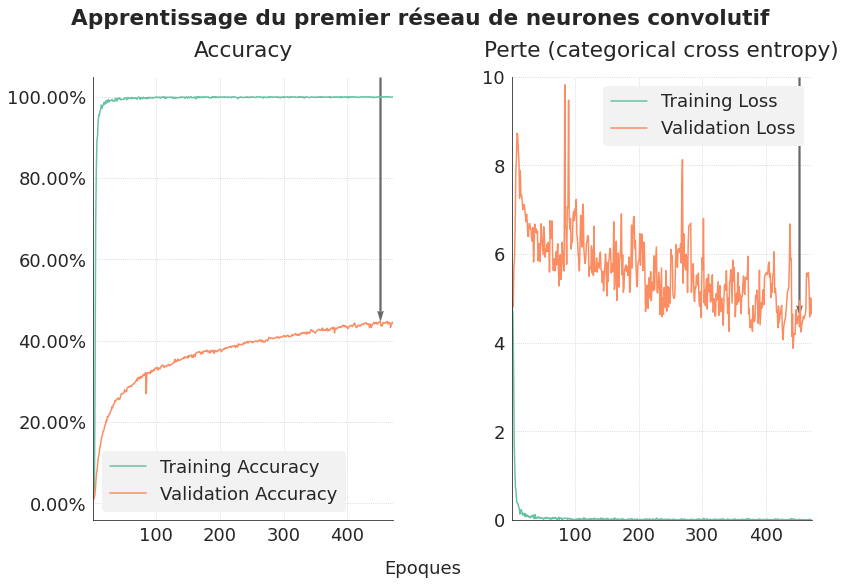

In [ ]:
fig, ax = graph_analysis_both("Apprentissage du premier réseau de neurones convolutif",
                              history_csv, is_csv=True)
plt.show()

J'étudie plusieurs possibilités pour limiter cet overfitting :
- ajouter un dropout ou un spatial dropout après la dernière couche convolutionnelle ;
- remplacer la couche Flatten() par une couche GlobalAveragePooling ;
- remplacer la couche Flatten() par une couche GlobalMaxPooling ;
- utiliser plusieurs fois un spatial dropout (après chaque couche convolutionnelle) ;
- mixer l'utilisation de plusieurs spatial dropouts et d'une sortie en Global Max Pooling.

#### 4.1.1. Utilisation d'une couche dropout

In [ ]:
MODEL_NAME = "04_cnn_regularization"
SUB_MODEL = "dropout"

In [ ]:
model2 = get_model_cnn(regularisation_method="dropout")

In [ ]:
model2.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling (Rescaling)        (None, 256, 256, 3)       0         
_________________________________________________________________
conv2d (Conv2D)              (None, 256, 256, 32)      896       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 128, 128, 64)      18496     
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 64, 64, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 64, 64, 128)       73856     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 32, 32, 128)       0

In [ ]:
es_patience = 20
logdir = os.path.join("logs", MODEL_NAME, SUB_MODEL)
tensorboard_callback = TensorBoard(logdir, histogram_freq=1)
checkpoint_callback = ModelCheckpoint("model_{}.h5".format(SUB_MODEL),
                                      monitor="val_accuracy", save_best_only=True)
earlystop_callback = EarlyStopping(monitor="val_accuracy", mode="max", patience=es_patience,
                                   restore_best_weights=True)

In [ ]:
epochs = 1000
history11 = model2.fit(data_mini, validation_data=data_valid, verbose=2,
                       epochs=epochs, callbacks=[checkpoint_callback,
                                                 earlystop_callback,
                                                 tensorboard_callback])

Epoch 1/1000
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
42/42 - 399s - loss: 4.8607 - accuracy: 0.0060 - val_loss: 4.7874 - val_accuracy: 0.0109
Epoch 2/1000
42/42 - 21s - loss: 4.7894 - accuracy: 0.0119 - val_loss: 4.7869 - val_accuracy: 0.0106
Epoch 3/1000
42/42 - 21s - loss: 4.7761 - accuracy: 0.0134 - val_loss: 4.7858 - val_accuracy: 0.0079
Epoch 4/1000
42/42 - 22s - loss: 4.7144 - accuracy: 0.0201 - val_loss: 4.7985 - val_accuracy: 0.0137
Epoch 5/1000
42/42 - 22s - loss: 3.9356 - accuracy: 0.1838 - val_loss: 4.8688 - val_accuracy: 0.0404
Epoch 6/1000
42/42 - 22s - loss: 1.9187 - accuracy: 0.6429 - val_loss: 6.2449 - val_accuracy: 0.0495
Epoch 7/1000
42/42 - 22s - loss: 1.0953 - accuracy: 0.8140 - val_loss: 6.5526 - val_accuracy: 0.0786
Epoch 8/1000
42/42 - 22s - loss: 0.7941 - accuracy: 0.8847 - val_loss: 7.6965 - val_accuracy: 0.0916
Epoch 9/1000
42/42 - 22s - loss: 0.5993 - accuracy: 0.9152 - val_loss: 8.3542 - val_accuracy: 0.1059
Epoch 10/1000
42/4

Je sauvegarde les résultats dans un fichier csv pour pouvoir y revenir facilement.

In [ ]:
history11_csv = pd.DataFrame(history11.history)
history11_csv.to_csv("history_{}.csv".format(SUB_MODEL))

In [ ]:
history_csv = pd.read_csv("history_dropout.csv", index_col=0)
history_csv.head()

,loss,accuracy,val_loss,val_accuracy
0,4.860712,0.005952,4.787392,0.010922
1,4.789412,0.011905,4.786863,0.010619
2,4.776055,0.013393,4.785775,0.007888
3,4.714414,0.020089,4.798466,0.013653
4,3.935578,0.183780,4.868754,0.040352


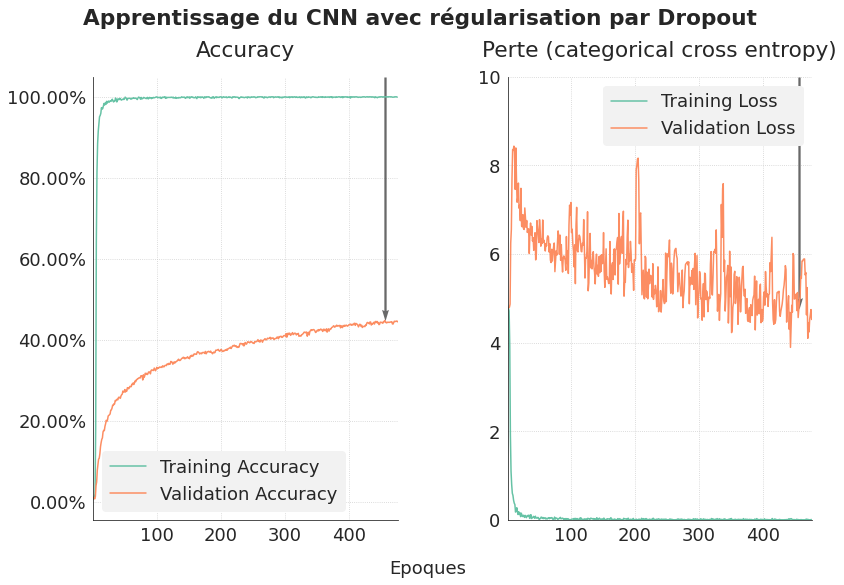

In [ ]:
fig, ax = graph_analysis_both("Apprentissage du CNN avec régularisation par Dropout",
                              history_csv, is_csv=True)
plt.show()

L'utilisation d'une seule couche dropout après la dernière couche convolutionnelle n'améliore pas notre problème d'overfitting.

#### 4.1.2. Utilisation d'une couche spatial dropout

In [ ]:
MODEL_NAME = "04_cnn_regularization"
SUB_MODEL = "spatial_dropout"

In [ ]:
model2 = get_model_cnn(regularisation_method="spatial_dropout")

In [ ]:
model2.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling (Rescaling)        (None, 256, 256, 3)       0         
_________________________________________________________________
conv2d (Conv2D)              (None, 256, 256, 32)      896       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 128, 128, 64)      18496     
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 64, 64, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 64, 64, 128)       73856     
_________________________________________________________________
spatial_dropout2d (SpatialDr (None, 64, 64, 128)       0

In [ ]:
es_patience = 20
logdir = os.path.join("logs", MODEL_NAME, SUB_MODEL)
tensorboard_callback = TensorBoard(logdir, histogram_freq=1)
checkpoint_callback = ModelCheckpoint("model_{}.h5".format(SUB_MODEL),
                                      monitor="val_accuracy", save_best_only=True)
earlystop_callback = EarlyStopping(monitor="val_accuracy", mode="max", patience=es_patience,
                                   restore_best_weights=True)

In [ ]:
epochs = 1000
history11b = model2.fit(data_mini, validation_data=data_valid, verbose=2,
                        epochs=epochs, callbacks=[checkpoint_callback,
                                                 earlystop_callback,
                                                 tensorboard_callback])

Epoch 1/1000
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
42/42 - 560s - loss: 5.2181 - accuracy: 0.0119 - val_loss: 4.7872 - val_accuracy: 0.0146
Epoch 2/1000
42/42 - 21s - loss: 4.7647 - accuracy: 0.0186 - val_loss: 4.7762 - val_accuracy: 0.0100
Epoch 3/1000
42/42 - 22s - loss: 4.3704 - accuracy: 0.1153 - val_loss: 4.8489 - val_accuracy: 0.0319
Epoch 4/1000
42/42 - 22s - loss: 2.8166 - accuracy: 0.4420 - val_loss: 5.2310 - val_accuracy: 0.0449
Epoch 5/1000
42/42 - 23s - loss: 1.7311 - accuracy: 0.6994 - val_loss: 6.2736 - val_accuracy: 0.0622
Epoch 6/1000
42/42 - 22s - loss: 1.2785 - accuracy: 0.7961 - val_loss: 7.3587 - val_accuracy: 0.0731
Epoch 7/1000
42/42 - 22s - loss: 0.8476 - accuracy: 0.8638 - val_loss: 8.2593 - val_accuracy: 0.0850
Epoch 8/1000
42/42 - 22s - loss: 0.9726 - accuracy: 0.8661 - val_loss: 8.2700 - val_accuracy: 0.0938
Epoch 9/1000
42/42 - 22s - loss: 0.6384 - accuracy: 0.9107 - val_loss: 9.9496 - val_accuracy: 0.1044
Epoch 10/1000
42/4

Je sauvegarde les résultats dans un fichier csv pour pouvoir y revenir facilement.

In [ ]:
history11b_csv = pd.DataFrame(history11b.history)
history11b_csv.to_csv("history_{}.csv".format(SUB_MODEL))

In [ ]:
history_csv = pd.read_csv("history_spatial_dropout.csv", index_col=0)
history_csv.head()

,loss,accuracy,val_loss,val_accuracy
0,5.218110,0.011905,4.787187,0.014563
1,4.764720,0.018601,4.776220,0.010012
2,4.370410,0.115327,4.848868,0.031857
3,2.816554,0.441964,5.231037,0.044903
4,1.731109,0.699405,6.273639,0.062197


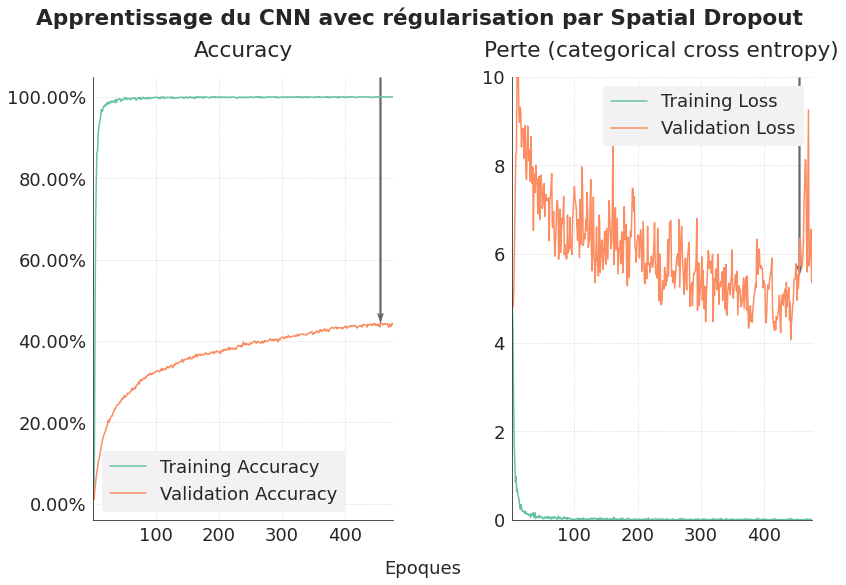

In [ ]:
fig, ax = graph_analysis_both("Apprentissage du CNN avec régularisation par Spatial Dropout",
                              history_csv, is_csv=True)
plt.show()

L'utilisation d'une seule couche spatial dropout après la dernière couche convolutionnelle n'améliore pas notre problème d'overfitting.

#### 4.1.3. Utilisation d'une couche Global Average Pooling - v1

In [ ]:
MODEL_NAME = "04_cnn_regularization"
SUB_MODEL = "GAP_v1"

In [ ]:
model2 = get_model_cnn(regularisation_method="GAP_v1")

In [ ]:
model2.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling_1 (Rescaling)      (None, 256, 256, 3)       0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 256, 256, 32)      896       
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 128, 128, 64)      18496     
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 64, 64, 64)        0         
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 64, 64, 128)       73856     
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 32, 32, 128)      

L'utilisation d'une couche Global Average Pooling permet de diminuer considérablement le nombre de paramètres à calculer (divisé par plus de 100), ce qui devrait limiter l'overfitting du modèle.

In [ ]:
es_patience = 20
logdir = os.path.join("logs", MODEL_NAME, SUB_MODEL)
tensorboard_callback = TensorBoard(logdir, histogram_freq=1)
checkpoint_callback = ModelCheckpoint("model_{}.h5".format(SUB_MODEL),
                                      monitor="val_accuracy", save_best_only=True)
earlystop_callback = EarlyStopping(monitor="val_accuracy", mode="max", patience=es_patience,
                                   restore_best_weights=True)

In [ ]:
epochs = 1000
history12 = model2.fit(data_mini, validation_data=data_valid, verbose=2,
                       epochs=epochs, callbacks=[checkpoint_callback,
                                                 earlystop_callback,
                                                 tensorboard_callback])

Epoch 1/1000
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
42/42 - 597s - loss: 4.7926 - accuracy: 0.0052 - val_loss: 4.7869 - val_accuracy: 0.0076
Epoch 2/1000
42/42 - 16s - loss: 4.7791 - accuracy: 0.0067 - val_loss: 4.7906 - val_accuracy: 0.0097
Epoch 3/1000
42/42 - 16s - loss: 4.7696 - accuracy: 0.0052 - val_loss: 4.8002 - val_accuracy: 0.0097
Epoch 4/1000
42/42 - 17s - loss: 4.7523 - accuracy: 0.0119 - val_loss: 4.8028 - val_accuracy: 0.0118
Epoch 5/1000
42/42 - 16s - loss: 4.7453 - accuracy: 0.0186 - val_loss: 4.8156 - val_accuracy: 0.0133
Epoch 6/1000
42/42 - 16s - loss: 4.7216 - accuracy: 0.0179 - val_loss: 4.8326 - val_accuracy: 0.0133
Epoch 7/1000
42/42 - 16s - loss: 4.7031 - accuracy: 0.0156 - val_loss: 4.8141 - val_accuracy: 0.0133
Epoch 8/1000
42/42 - 16s - loss: 4.6970 - accuracy: 0.0268 - val_loss: 4.7948 - val_accuracy: 0.0155
Epoch 9/1000
42/42 - 16s - loss: 4.6658 - accuracy: 0.0275 - val_loss: 4.8083 - val_accuracy: 0.0170
Epoch 10/1000
42/4

Je sauvegarde les résultats dans un fichier csv pour pouvoir y revenir facilement.

In [ ]:
history12_csv = pd.DataFrame(history12.history)
history12_csv.to_csv("history_{}.csv".format(SUB_MODEL))

In [ ]:
history_csv = pd.read_csv("history_GAP_v1.csv", index_col=0)
history_csv.head()

,loss,accuracy,val_loss,val_accuracy
0,4.792609,0.005208,4.786852,0.007585
1,4.779098,0.006696,4.790568,0.009709
2,4.769575,0.005208,4.800229,0.009709
3,4.752343,0.011905,4.802781,0.011833
4,4.745255,0.018601,4.815568,0.013350


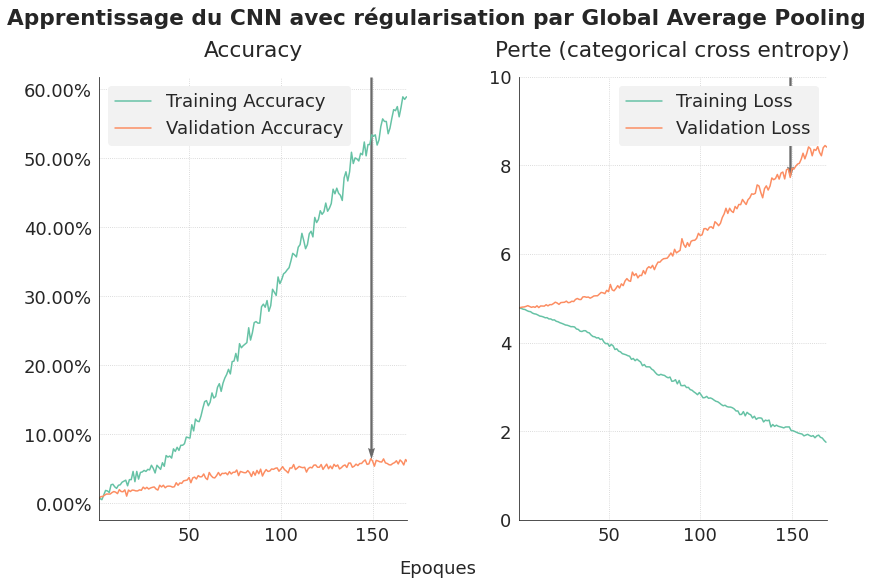

In [ ]:
fig, ax = graph_analysis_both("Apprentissage du CNN avec régularisation par Global Average Pooling",
                              history_csv, is_csv=True)
plt.show()

L'utilisation d'une sortie en Global Average Pooling diminue la différence entre l'accuracy de training et l'accuracy de validation, au prix d'une forte baisse de l'accuracy de validation.

#### 4.1.4. Utilisation d'une couche Global Average Pooling - v2

In [ ]:
MODEL_NAME = "04_cnn_regularization"
SUB_MODEL = "GAP_v2"

In [ ]:
model2 = get_model_cnn(regularisation_method="GAP_v2")

In [ ]:
model2.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling_2 (Rescaling)      (None, 256, 256, 3)       0         
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 256, 256, 32)      896       
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 128, 128, 64)      18496     
_________________________________________________________________
max_pooling2d_7 (MaxPooling2 (None, 64, 64, 64)        0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 64, 64, 128)       73856     
_________________________________________________________________
global_average_pooling2d_2 ( (None, 128)              

L'utilisation d'une couche Global Average Pooling permet de diminuer considérablement le nombre de paramètres à calculer (divisé par plus de 100), ce qui devrait limiter l'overfitting du modèle.

In [ ]:
es_patience = 20
logdir = os.path.join("logs", MODEL_NAME, SUB_MODEL)
tensorboard_callback = TensorBoard(logdir, histogram_freq=1)
checkpoint_callback = ModelCheckpoint("model_{}.h5".format(SUB_MODEL),
                                      monitor="val_accuracy", save_best_only=True)
earlystop_callback = EarlyStopping(monitor="val_accuracy", mode="max", patience=es_patience,
                                   restore_best_weights=True)

In [ ]:
epochs = 1000
history13 = model2.fit(data_mini, validation_data=data_valid, verbose=2,
                       epochs=epochs, callbacks=[checkpoint_callback,
                                                 earlystop_callback,
                                                 tensorboard_callback])

Epoch 1/1000
42/42 - 16s - loss: 4.7899 - accuracy: 0.0089 - val_loss: 4.7873 - val_accuracy: 0.0064
Epoch 2/1000
42/42 - 17s - loss: 4.7784 - accuracy: 0.0104 - val_loss: 4.7972 - val_accuracy: 0.0140
Epoch 3/1000
42/42 - 16s - loss: 4.7721 - accuracy: 0.0067 - val_loss: 4.8020 - val_accuracy: 0.0149
Epoch 4/1000
42/42 - 16s - loss: 4.7589 - accuracy: 0.0104 - val_loss: 4.8282 - val_accuracy: 0.0118
Epoch 5/1000
42/42 - 16s - loss: 4.7612 - accuracy: 0.0134 - val_loss: 4.8034 - val_accuracy: 0.0097
Epoch 6/1000
42/42 - 16s - loss: 4.7480 - accuracy: 0.0149 - val_loss: 4.8010 - val_accuracy: 0.0143
Epoch 7/1000
42/42 - 16s - loss: 4.7295 - accuracy: 0.0156 - val_loss: 4.8110 - val_accuracy: 0.0124
Epoch 8/1000
42/42 - 16s - loss: 4.6872 - accuracy: 0.0201 - val_loss: 4.7929 - val_accuracy: 0.0164
Epoch 9/1000
42/42 - 16s - loss: 4.6527 - accuracy: 0.0216 - val_loss: 4.8257 - val_accuracy: 0.0191
Epoch 10/1000
42/42 - 17s - loss: 4.6249 - accuracy: 0.0260 - val_loss: 4.8251 - val_accura

Je sauvegarde les résultats dans un fichier csv pour pouvoir y revenir facilement.

In [ ]:
history13_csv = pd.DataFrame(history13.history)
history13_csv.to_csv("history_{}.csv".format(SUB_MODEL))

In [ ]:
history_csv = pd.read_csv("history_GAP_v2.csv", index_col=0)
history_csv.head()

,loss,accuracy,val_loss,val_accuracy
0,4.789923,0.008929,4.787315,0.006371
1,4.778431,0.010417,4.797231,0.013956
2,4.772062,0.006696,4.802011,0.014867
3,4.758930,0.010417,4.828194,0.011833
4,4.761161,0.013393,4.803414,0.009709


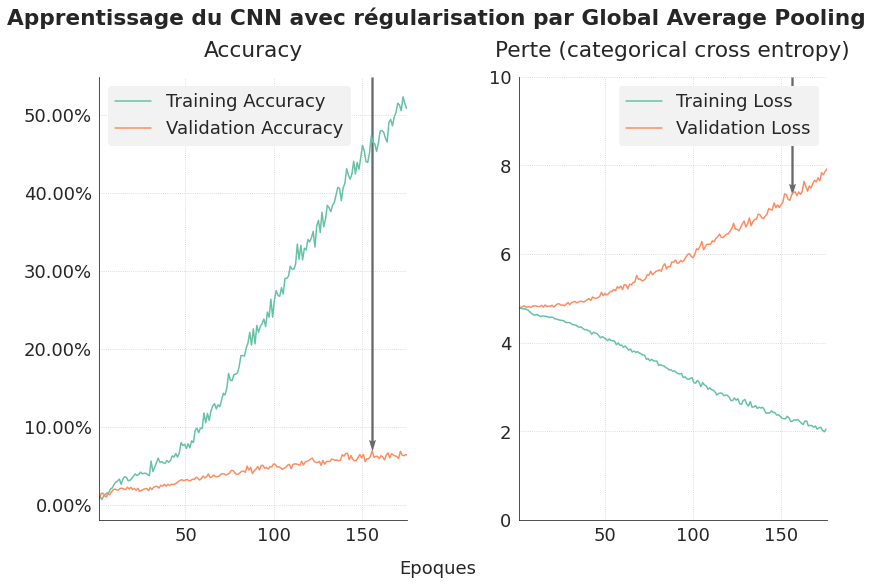

In [ ]:
fig, ax = graph_analysis_both("Apprentissage du CNN avec régularisation par Global Average Pooling",
                              history_csv, is_csv=True)
plt.show()

Nous arrivons à la même conclusion que l'utilisation d'une sortie en Global Average Pooling diminue la différence entre l'accuracy de training et l'accuracy de validation, au prix d'une forte baisse de l'accuracy de validation.

#### 4.1.5. Utilisation d'une couche Global Max Pooling

In [ ]:
MODEL_NAME = "04_cnn_regularization"
SUB_MODEL = "GMP"

In [ ]:
model2 = get_model_cnn(regularisation_method="GMP")

In [ ]:
model2.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling_3 (Rescaling)      (None, 256, 256, 3)       0         
_________________________________________________________________
conv2d_9 (Conv2D)            (None, 256, 256, 32)      896       
_________________________________________________________________
max_pooling2d_8 (MaxPooling2 (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_10 (Conv2D)           (None, 128, 128, 64)      18496     
_________________________________________________________________
max_pooling2d_9 (MaxPooling2 (None, 64, 64, 64)        0         
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 64, 64, 128)       73856     
_________________________________________________________________
global_max_pooling2d (Global (None, 128)              

In [ ]:
es_patience = 20
logdir = os.path.join("logs", MODEL_NAME, SUB_MODEL)
tensorboard_callback = TensorBoard(logdir, histogram_freq=1)
checkpoint_callback = ModelCheckpoint("model_{}.h5".format(SUB_MODEL),
                                      monitor="val_accuracy", save_best_only=True)
earlystop_callback = EarlyStopping(monitor="val_accuracy", mode="max", patience=es_patience,
                                   restore_best_weights=True)

In [ ]:
epochs = 1000
history14 = model2.fit(data_mini, validation_data=data_valid, verbose=2,
                       epochs=epochs, callbacks=[checkpoint_callback,
                                                 earlystop_callback,
                                                 tensorboard_callback])

Epoch 1/1000
42/42 - 16s - loss: 4.7906 - accuracy: 0.0104 - val_loss: 4.7891 - val_accuracy: 0.0112
Epoch 2/1000
42/42 - 16s - loss: 4.7667 - accuracy: 0.0141 - val_loss: 4.8011 - val_accuracy: 0.0115
Epoch 3/1000
42/42 - 16s - loss: 4.7583 - accuracy: 0.0141 - val_loss: 4.8029 - val_accuracy: 0.0149
Epoch 4/1000
42/42 - 16s - loss: 4.7489 - accuracy: 0.0112 - val_loss: 4.8077 - val_accuracy: 0.0100
Epoch 5/1000
42/42 - 16s - loss: 4.7400 - accuracy: 0.0119 - val_loss: 4.8340 - val_accuracy: 0.0097
Epoch 6/1000
42/42 - 16s - loss: 4.7298 - accuracy: 0.0104 - val_loss: 4.8541 - val_accuracy: 0.0137
Epoch 7/1000
42/42 - 16s - loss: 4.7082 - accuracy: 0.0186 - val_loss: 4.8908 - val_accuracy: 0.0158
Epoch 8/1000
42/42 - 16s - loss: 4.6862 - accuracy: 0.0179 - val_loss: 4.8445 - val_accuracy: 0.0176
Epoch 9/1000
42/42 - 16s - loss: 4.6431 - accuracy: 0.0223 - val_loss: 4.8396 - val_accuracy: 0.0176
Epoch 10/1000
42/42 - 16s - loss: 4.6143 - accuracy: 0.0327 - val_loss: 4.8161 - val_accura

Je sauvegarde les résultats dans un fichier csv pour pouvoir y revenir facilement.

In [ ]:
history14_csv = pd.DataFrame(history14.history)
history14_csv.to_csv("history_{}.csv".format(SUB_MODEL))

In [ ]:
history_csv = pd.read_csv("history_GMP.csv", index_col=0)
history_csv.head()

,loss,accuracy,val_loss,val_accuracy
0,4.790568,0.010417,4.789054,0.011226
1,4.766718,0.014137,4.801133,0.011529
2,4.758341,0.014137,4.802864,0.014867
3,4.748856,0.011161,4.807724,0.010012
4,4.740039,0.011905,4.833980,0.009709


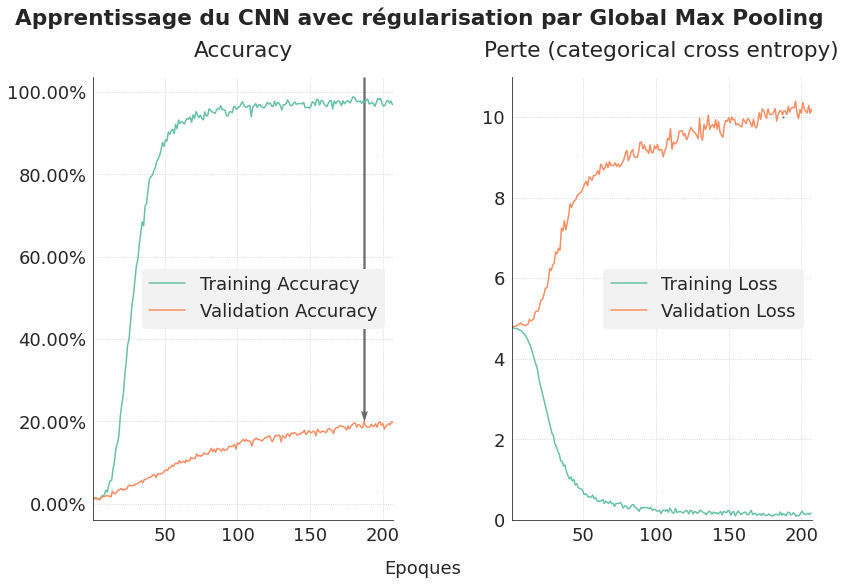

In [ ]:
fig, ax = graph_analysis_both("Apprentissage du CNN avec régularisation par Global Max Pooling",
                              history_csv, is_csv=True)
ax[1].set_ylim([0, 11])
plt.show()

Une sortie en Global Max Pooling permet un apprentissage plus progressif et préserve une plus grande partie de la performance, par rapport à la sortie en Global Average Pooling. Par contre, utilisée seule, elle ne permet pas de diminuer la différence entre l'accuracy de training et l'accuracy de validation.

#### 4.1.6. Multiples Spatial Dropout

Je tente d'appliquer un spatial dropout après chaque couche convolutionnelle.

In [ ]:
MODEL_NAME = "04_cnn_regularization"
SUB_MODEL = "multiples_spatial_dropout"

In [ ]:
model2 = Sequential()
model2.add(Rescaling(1./255, input_shape=(256, 256, 3)))
model2.add(Conv2D(32, (3, 3), padding="same", activation="relu"))
model2.add(SpatialDropout2D(0.2, seed=RANDOM_SEED))
model2.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))
model2.add(Conv2D(64, (3, 3), padding="same", activation="relu"))
model2.add(SpatialDropout2D(0.2, seed=RANDOM_SEED))
model2.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))
model2.add(Conv2D(128, (3, 3), padding="same", activation="relu"))
model2.add(SpatialDropout2D(0.2, seed=RANDOM_SEED))
model2.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))
model2.add(Flatten())
model2.add(Dense(120, activation="softmax"))

In [ ]:
model2.compile(loss="sparse_categorical_crossentropy",
               optimizer="adam",
               metrics=["accuracy"])

In [ ]:
model2.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling_2 (Rescaling)      (None, 256, 256, 3)       0         
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 256, 256, 32)      896       
_________________________________________________________________
spatial_dropout2d_4 (Spatial (None, 256, 256, 32)      0         
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 128, 128, 64)      18496     
_________________________________________________________________
spatial_dropout2d_5 (Spatial (None, 128, 128, 64)      0         
_________________________________________________________________
max_pooling2d_7 (MaxPooling2 (None, 64, 64, 64)       

In [ ]:
es_patience = 20
logdir = os.path.join("logs", MODEL_NAME, SUB_MODEL)
tensorboard_callback = TensorBoard(logdir, histogram_freq=1)
checkpoint_callback = ModelCheckpoint("model_{}.h5".format(SUB_MODEL),
                                      monitor="val_accuracy", save_best_only=True)
earlystop_callback = EarlyStopping(monitor="val_accuracy", mode="max", patience=es_patience,
                                   restore_best_weights=True)

In [ ]:
epochs = 1000
history15 = model2.fit(data_mini, validation_data=data_valid, verbose=2,
                        epochs=epochs, callbacks=[checkpoint_callback,
                                                 earlystop_callback,
                                                 tensorboard_callback])

Epoch 1/1000
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
42/42 - 465s - loss: 5.0135 - accuracy: 0.0074 - val_loss: 4.7874 - val_accuracy: 0.0112
Epoch 2/1000
42/42 - 19s - loss: 4.7869 - accuracy: 0.0097 - val_loss: 4.7870 - val_accuracy: 0.0103
Epoch 3/1000
42/42 - 18s - loss: 4.7830 - accuracy: 0.0119 - val_loss: 4.7869 - val_accuracy: 0.0097
Epoch 4/1000
42/42 - 18s - loss: 4.7801 - accuracy: 0.0141 - val_loss: 4.7843 - val_accuracy: 0.0070
Epoch 5/1000
42/42 - 19s - loss: 4.5942 - accuracy: 0.0618 - val_loss: 4.8030 - val_accuracy: 0.0240
Epoch 6/1000
42/42 - 19s - loss: 3.4365 - accuracy: 0.3356 - val_loss: 5.3023 - val_accuracy: 0.0437
Epoch 7/1000
42/42 - 19s - loss: 2.0107 - accuracy: 0.6376 - val_loss: 6.9394 - val_accuracy: 0.0622
Epoch 8/1000
42/42 - 19s - loss: 1.4095 - accuracy: 0.7812 - val_loss: 7.8421 - val_accuracy: 0.0783
Epoch 9/1000
42/42 - 19s - loss: 1.0761 - accuracy: 0.8430 - val_loss: 8.6010 - val_accuracy: 0.0883
Epoch 10/1000
42/4

Je sauvegarde les résultats dans un fichier csv pour pouvoir y revenir facilement.

In [ ]:
history15_csv = pd.DataFrame(history15.history)
history15_csv.to_csv("history_{}.csv".format(SUB_MODEL))

In [ ]:
history_csv = pd.read_csv("history_multiples_spatial_dropout.csv", index_col=0)
history_csv.head()


,loss,accuracy,val_loss,val_accuracy
0,5.013480,0.007440,4.787426,0.011226
1,4.786929,0.009673,4.787045,0.010316
2,4.782997,0.011905,4.786942,0.009709
3,4.780138,0.014137,4.784293,0.006978
4,4.594171,0.061756,4.803030,0.023968


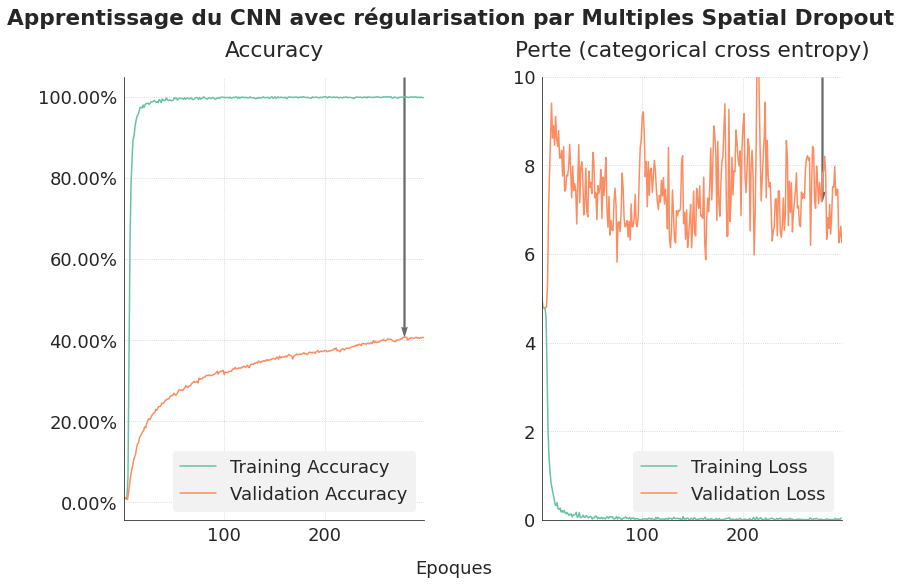

In [ ]:
fig, ax = graph_analysis_both("Apprentissage du CNN avec régularisation par Multiples Spatial Dropout",
                              history_csv, is_csv=True)
plt.show()

Avec plusieurs spatial dropouts, l'apprentissage est plus progressif et la performance quasiment intégralement conservée, mais le problème d'overfitting n'est pas résolu.

#### 4.1.7. Multiples Spatial Dropout + Global Max Pooling

Je mixe les deux approches d'avoir un spatial dropout après chaque couche convolutionnelle et une sortie en Global Max Pooling.

In [ ]:
MODEL_NAME = "04_cnn_regularization"
SUB_MODEL = "multiples_spatial_dropout_GMP"

In [ ]:
def get_cnn_regularise():
    model = Sequential()
    model.add(Rescaling(1./255, input_shape=(256, 256, 3)))
    model.add(Conv2D(32, (3, 3), padding="same", activation="relu"))
    model.add(SpatialDropout2D(0.2, seed=RANDOM_SEED))
    model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))
    model.add(Conv2D(64, (3, 3), padding="same", activation="relu"))
    model.add(SpatialDropout2D(0.2, seed=RANDOM_SEED))
    model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))
    model.add(Conv2D(128, (3, 3), padding="same", activation="relu"))
    model.add(SpatialDropout2D(0.2, seed=RANDOM_SEED))
    model.add(GlobalMaxPool2D())
    model.add(Dense(120, activation="softmax"))

    model.compile(loss="sparse_categorical_crossentropy",
                  optimizer="adam",
                  metrics=["accuracy"])
    return model

In [ ]:
model2 = get_cnn_regularise()
model2.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling_1 (Rescaling)      (None, 256, 256, 3)       0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 256, 256, 32)      896       
_________________________________________________________________
spatial_dropout2d_3 (Spatial (None, 256, 256, 32)      0         
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 128, 128, 64)      18496     
_________________________________________________________________
spatial_dropout2d_4 (Spatial (None, 128, 128, 64)      0         
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 64, 64, 64)       

In [ ]:
es_patience = 50
#logdir = os.path.join("logs", MODEL_NAME, SUB_MODEL)
#tensorboard_callback = TensorBoard(logdir, histogram_freq=1)
#checkpoint_callback = ModelCheckpoint("model_{}.h5".format(SUB_MODEL),
#                                      monitor="val_accuracy", save_best_only=True)
earlystop_callback = EarlyStopping(monitor="val_accuracy", mode="max", patience=es_patience,
                                   restore_best_weights=True)

In [ ]:
epochs = 1000
history16 = model2.fit(data_mini, validation_data=data_valid, verbose=2,
                        epochs=epochs, callbacks=[earlystop_callback])

Epoch 1/1000
42/42 - 353s - loss: 4.7978 - accuracy: 0.0097 - val_loss: 4.7872 - val_accuracy: 0.0106
Epoch 2/1000
42/42 - 19s - loss: 4.7795 - accuracy: 0.0112 - val_loss: 4.7905 - val_accuracy: 0.0103
Epoch 3/1000
42/42 - 19s - loss: 4.7730 - accuracy: 0.0074 - val_loss: 4.7956 - val_accuracy: 0.0058
Epoch 4/1000
42/42 - 18s - loss: 4.7605 - accuracy: 0.0126 - val_loss: 4.8010 - val_accuracy: 0.0121
Epoch 5/1000
42/42 - 19s - loss: 4.7591 - accuracy: 0.0112 - val_loss: 4.8088 - val_accuracy: 0.0133
Epoch 6/1000
42/42 - 19s - loss: 4.7534 - accuracy: 0.0119 - val_loss: 4.8121 - val_accuracy: 0.0143
Epoch 7/1000
42/42 - 19s - loss: 4.7518 - accuracy: 0.0134 - val_loss: 4.8301 - val_accuracy: 0.0106
Epoch 8/1000
42/42 - 19s - loss: 4.7553 - accuracy: 0.0060 - val_loss: 4.8164 - val_accuracy: 0.0118
Epoch 9/1000
42/42 - 19s - loss: 4.7413 - accuracy: 0.0164 - val_loss: 4.8196 - val_accuracy: 0.0088
Epoch 10/1000
42/42 - 19s - loss: 4.7413 - accuracy: 0.0126 - val_loss: 4.8118 - val_accur

Je sauvegarde les résultats dans un fichier csv pour pouvoir y revenir facilement.

In [ ]:
history16_csv = pd.DataFrame(history16.history)
history16_csv.to_csv("history_{}.csv".format(SUB_MODEL))

In [ ]:
history_csv = pd.read_csv("history_multiples_spatial_dropout_GMP.csv", index_col=0)
history_csv.head()

,loss,accuracy,val_loss,val_accuracy
0,4.797807,0.009673,4.787215,0.010619
1,4.779550,0.011161,4.790473,0.010316
2,4.773019,0.007440,4.795630,0.005765
3,4.760479,0.012649,4.801046,0.012136
4,4.759099,0.011161,4.808841,0.013350


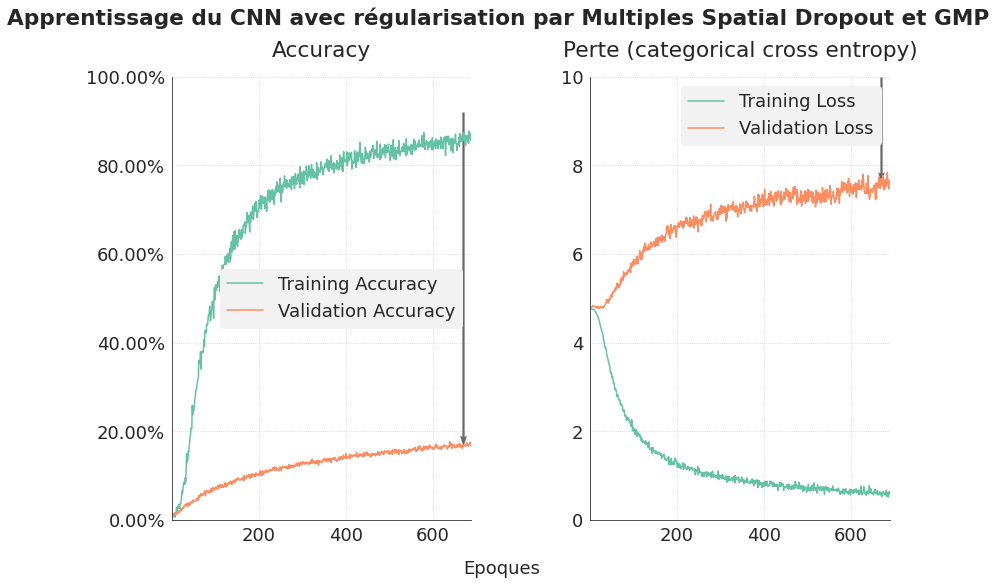

In [ ]:
fig, ax = graph_analysis_both("Apprentissage du CNN avec régularisation par Multiples Spatial Dropout et GMP",
                              history_csv, is_csv=True)
ax[0].set_ylim([0, 1])
save_fig("iml06_02_cnn_regularise")
plt.show()

L'apprentissage est beaucoup plus progressif. L'accuracy de training n'atteint plus 100%. L'accuracy de validation monte doucement et conserve une partie de sa performance. Ce cumul de spatial dropouts et d'une sortie en Global Max Pooling semble une bonne approche pour régulariser le modèle.

<a id='4_2'></a>

### 4.2. Optimiser la structure du modèle avec Keras Tuner

#### 4.2.1. Premier essai d'optimisation

Je vais chercher à optimiser ce modèle avec Keras Tuner, en cherchant les paramètres optimaux pour :
- la taille de l'image en entrée, entre 128 x 128 et 256 x 256 par pas de 32 ;
- la profondeur du réseau : le nombre de couches CNN et de pooling (entre 2 et 5 couches). Pour le pooling, je peux tester à chaque fois un average pooling et un max pooling ;
- la largeur du réseau : le nombre de filtres pour chaque couche CNN (entre 16 et 128 neurones) ;
- la taille du kernel pour la convolution : entre (1, 1) et (7, 7) par pas de 2, en gardant toujours un padding égal à same (pour avoir des tailles d'images toujours en multiples de deux) ;
- la fonction d'activation de chaque convolution : ReLU, tanh, sigmoid ou ELU ;
- le choix entre Flatten, GlobalAveragePooling2D ou GlobalMaxPool2D avant la couche dense de classification ;
- le taux d'apprentissage de l'algorithme d'optimisation : entre 1e-5 et 1e-2 , à l'échelle logarithmique.

In [ ]:
#hp = HyperParameters()

In [ ]:
def build_model(hp):
    model = Sequential()
    img_size = hp.Int("img_size", min_value=128, max_value=256, step=32, default=256)
    model.add(Resizing(img_size, img_size))
    model.add(Rescaling(1./255, input_shape=(img_size, img_size, 3)))
    for i in range(hp.Int("nb_layers", 2, 5)):
        model.add(Conv2D(filters=hp.Choice("filters_" + str(i),
                                           values=[16, 32, 64, 128],
                                           default=64),
                         kernel_size=hp.Int("kernel_size_" + str(i),
                                            min_value=1,
                                            max_value=7,
                                            step=2,
                                            default=3),
                         padding="same",
                         activation=hp.Choice("activation_" + str(i),
                                              values=["relu", "tanh", "sigmoid", "elu"],
                                              default="relu")))
        add_pooling = hp.Choice("pool_" + str(i),
                                values=["none", "MaxPool", "AvgPool"],
                                default="MaxPool")
        if add_pooling == "MaxPool":
            model.add(MaxPooling2D(pool_size=2))
        elif add_pooling == "AvgPool":
            model.add(AveragePooling2D(pool_size=2))
    global_pooling = hp.Choice("global_pool",
                               values=["none", "MaxPool", "AvgPool"],
                               default="MaxPool")
    if global_pooling == "MaxPool":
        model.add(GlobalMaxPool2D())
    if global_pooling == "AvgPool":
        model.add(GlobalAveragePooling2D())
    else:
        model.add(Flatten())
    model.add(Dense(120, activation="softmax"))
    model.compile(optimizer=Adam(learning_rate=hp.Float("learning_rate",
                                                        min_value=1e-5,
                                                        max_value=1e-2,
                                                        sampling='LOG',
                                                        default=1e-3)),
                  loss="sparse_categorical_crossentropy",
                  metrics=["accuracy"])
    return model

In [ ]:
tuner = BayesianOptimization(build_model,
                             objective="val_accuracy",
                             max_trials=100,
                             executions_per_trial=1,
                             directory="tuning",
                             project_name="cnn",
                             seed=RANDOM_SEED)

INFO:tensorflow:Reloading Oracle from existing project tuning/cnn/oracle.json


Les résultats obtenus jusqu'à maintenant montrent que l'on a déjà une bonne vision du potentiel d'un modèle avec sa performance après 20 époques. Cette performance est loin de la performance finale obtenue, mais elle donne une bonne indication du potentiel du modèle. Le classement des modèles après 20 époques reflète celui des modèles une fois l'entraînement terminé. Je me limite donc à un entraînement sur 20 époques pour économiser du temps de calcul.

In [ ]:
tuner.search(data_mini, validation_data=data_valid, verbose=1,
             epochs=20)

Epoch 1/20
42/42 [==============================] - 565s 13s/step - loss: 4.7931 - accuracy: 0.0126 - val_loss: 4.7873 - val_accuracy: 0.0085
Epoch 2/20
42/42 [==============================] - 17s 395ms/step - loss: 4.7766 - accuracy: 0.0097 - val_loss: 4.7875 - val_accuracy: 0.0106
Epoch 3/20
42/42 [==============================] - 16s 392ms/step - loss: 4.7678 - accuracy: 0.0112 - val_loss: 4.7958 - val_accuracy: 0.0088
Epoch 4/20
42/42 [==============================] - 17s 394ms/step - loss: 4.7594 - accuracy: 0.0097 - val_loss: 4.8029 - val_accuracy: 0.0082
Epoch 5/20
42/42 [==============================] - 16s 392ms/step - loss: 4.7546 - accuracy: 0.0097 - val_loss: 4.8079 - val_accuracy: 0.0088
Epoch 6/20
42/42 [==============================] - 17s 393ms/step - loss: 4.7456 - accuracy: 0.0112 - val_loss: 4.8104 - val_accuracy: 0.0109
Epoch 7/20
42/42 [==============================] - 17s 394ms/step - loss: 4.7466 - accuracy: 0.0126 - val_loss: 4.8105 - val_accuracy: 0.0097


Epoch 1/20
42/42 [==============================] - 18s 429ms/step - loss: 4.8097 - accuracy: 0.0052 - val_loss: 4.8064 - val_accuracy: 0.0070
Epoch 2/20
42/42 [==============================] - 18s 425ms/step - loss: 4.7915 - accuracy: 0.0104 - val_loss: 4.7993 - val_accuracy: 0.0085
Epoch 3/20
42/42 [==============================] - 18s 428ms/step - loss: 4.7814 - accuracy: 0.0149 - val_loss: 4.7975 - val_accuracy: 0.0094
Epoch 4/20
42/42 [==============================] - 18s 427ms/step - loss: 4.7776 - accuracy: 0.0134 - val_loss: 4.7964 - val_accuracy: 0.0103
Epoch 5/20
42/42 [==============================] - 18s 429ms/step - loss: 4.7742 - accuracy: 0.0156 - val_loss: 4.7951 - val_accuracy: 0.0103
Epoch 6/20
42/42 [==============================] - 18s 428ms/step - loss: 4.7683 - accuracy: 0.0134 - val_loss: 4.7962 - val_accuracy: 0.0097
Epoch 7/20
42/42 [==============================] - 18s 429ms/step - loss: 4.7671 - accuracy: 0.0149 - val_loss: 4.7964 - val_accuracy: 0.0085

Epoch 1/20
42/42 [==============================] - 17s 414ms/step - loss: 5.2079 - accuracy: 0.0060 - val_loss: 4.7891 - val_accuracy: 0.0103
Epoch 2/20
42/42 [==============================] - 17s 405ms/step - loss: 4.7733 - accuracy: 0.0104 - val_loss: 4.7909 - val_accuracy: 0.0085
Epoch 3/20
42/42 [==============================] - 17s 409ms/step - loss: 4.7689 - accuracy: 0.0104 - val_loss: 4.7941 - val_accuracy: 0.0079
Epoch 4/20
42/42 [==============================] - 17s 410ms/step - loss: 4.7598 - accuracy: 0.0104 - val_loss: 4.7966 - val_accuracy: 0.0106
Epoch 5/20
42/42 [==============================] - 17s 409ms/step - loss: 4.7581 - accuracy: 0.0112 - val_loss: 4.7986 - val_accuracy: 0.0106
Epoch 6/20
42/42 [==============================] - 17s 409ms/step - loss: 4.7551 - accuracy: 0.0082 - val_loss: 4.8016 - val_accuracy: 0.0106
Epoch 7/20
42/42 [==============================] - 17s 406ms/step - loss: 4.7514 - accuracy: 0.0126 - val_loss: 4.8036 - val_accuracy: 0.0100

Epoch 1/20
42/42 [==============================] - 16s 370ms/step - loss: 10.6864 - accuracy: 0.0112 - val_loss: 5.1604 - val_accuracy: 0.0127
Epoch 2/20
42/42 [==============================] - 15s 367ms/step - loss: 4.7044 - accuracy: 0.0320 - val_loss: 4.7401 - val_accuracy: 0.0221
Epoch 3/20
42/42 [==============================] - 15s 368ms/step - loss: 4.3236 - accuracy: 0.0818 - val_loss: 4.7593 - val_accuracy: 0.0279
Epoch 4/20
42/42 [==============================] - 16s 372ms/step - loss: 3.9654 - accuracy: 0.1384 - val_loss: 4.9903 - val_accuracy: 0.0285
Epoch 5/20
42/42 [==============================] - 15s 367ms/step - loss: 3.6448 - accuracy: 0.1979 - val_loss: 5.2516 - val_accuracy: 0.0340
Epoch 6/20
42/42 [==============================] - 15s 367ms/step - loss: 3.1287 - accuracy: 0.3155 - val_loss: 5.4985 - val_accuracy: 0.0404
Epoch 7/20
42/42 [==============================] - 15s 368ms/step - loss: 2.6809 - accuracy: 0.4100 - val_loss: 5.8366 - val_accuracy: 0.049

Epoch 1/20
42/42 [==============================] - 17s 412ms/step - loss: 4.8165 - accuracy: 0.0089 - val_loss: 4.8079 - val_accuracy: 0.0109
Epoch 2/20
42/42 [==============================] - 17s 412ms/step - loss: 4.7748 - accuracy: 0.0104 - val_loss: 4.8110 - val_accuracy: 0.0079
Epoch 3/20
42/42 [==============================] - 17s 407ms/step - loss: 4.7680 - accuracy: 0.0164 - val_loss: 4.8134 - val_accuracy: 0.0088
Epoch 4/20
42/42 [==============================] - 17s 411ms/step - loss: 4.7645 - accuracy: 0.0112 - val_loss: 4.8185 - val_accuracy: 0.0091
Epoch 5/20
42/42 [==============================] - 17s 412ms/step - loss: 4.7547 - accuracy: 0.0104 - val_loss: 4.8163 - val_accuracy: 0.0064
Epoch 6/20
42/42 [==============================] - 17s 415ms/step - loss: 4.7542 - accuracy: 0.0104 - val_loss: 4.8070 - val_accuracy: 0.0070
Epoch 7/20
42/42 [==============================] - 17s 416ms/step - loss: 4.7511 - accuracy: 0.0112 - val_loss: 4.8115 - val_accuracy: 0.0061

Epoch 1/20
42/42 [==============================] - 18s 425ms/step - loss: 4.8194 - accuracy: 0.0104 - val_loss: 4.8097 - val_accuracy: 0.0094
Epoch 2/20
42/42 [==============================] - 18s 422ms/step - loss: 4.7902 - accuracy: 0.0119 - val_loss: 4.8045 - val_accuracy: 0.0082
Epoch 3/20
42/42 [==============================] - 18s 421ms/step - loss: 4.7849 - accuracy: 0.0112 - val_loss: 4.8013 - val_accuracy: 0.0079
Epoch 4/20
42/42 [==============================] - 18s 426ms/step - loss: 4.7843 - accuracy: 0.0112 - val_loss: 4.7999 - val_accuracy: 0.0073
Epoch 5/20
42/42 [==============================] - 18s 427ms/step - loss: 4.7792 - accuracy: 0.0134 - val_loss: 4.7976 - val_accuracy: 0.0076
Epoch 6/20
42/42 [==============================] - 18s 428ms/step - loss: 4.7763 - accuracy: 0.0112 - val_loss: 4.7992 - val_accuracy: 0.0082
Epoch 7/20
42/42 [==============================] - 18s 428ms/step - loss: 4.7741 - accuracy: 0.0119 - val_loss: 4.8000 - val_accuracy: 0.0079

Epoch 1/20
42/42 [==============================] - 19s 463ms/step - loss: 47.5701 - accuracy: 0.0089 - val_loss: 5.3340 - val_accuracy: 0.0140
Epoch 2/20
42/42 [==============================] - 17s 404ms/step - loss: 4.9233 - accuracy: 0.0335 - val_loss: 4.9975 - val_accuracy: 0.0100
Epoch 3/20
42/42 [==============================] - 17s 400ms/step - loss: 4.8035 - accuracy: 0.0379 - val_loss: 4.9255 - val_accuracy: 0.0127
Epoch 4/20
42/42 [==============================] - 17s 397ms/step - loss: 4.7882 - accuracy: 0.0491 - val_loss: 4.8699 - val_accuracy: 0.0100
Epoch 5/20
42/42 [==============================] - 17s 397ms/step - loss: 4.7229 - accuracy: 0.0536 - val_loss: 4.8785 - val_accuracy: 0.0097
Epoch 6/20
42/42 [==============================] - 17s 398ms/step - loss: 4.6963 - accuracy: 0.0588 - val_loss: 4.8969 - val_accuracy: 0.0100
Epoch 7/20
42/42 [==============================] - 17s 396ms/step - loss: 4.6721 - accuracy: 0.0647 - val_loss: 4.9161 - val_accuracy: 0.009

Epoch 1/20
42/42 [==============================] - 17s 416ms/step - loss: 4.7887 - accuracy: 0.0074 - val_loss: 4.7894 - val_accuracy: 0.0070
Epoch 2/20
42/42 [==============================] - 17s 403ms/step - loss: 4.7841 - accuracy: 0.0060 - val_loss: 4.7898 - val_accuracy: 0.0067
Epoch 3/20
42/42 [==============================] - 17s 407ms/step - loss: 4.7834 - accuracy: 0.0089 - val_loss: 4.7894 - val_accuracy: 0.0082
Epoch 4/20
42/42 [==============================] - 18s 420ms/step - loss: 4.7805 - accuracy: 0.0149 - val_loss: 4.7905 - val_accuracy: 0.0058
Epoch 5/20
42/42 [==============================] - 17s 402ms/step - loss: 4.7774 - accuracy: 0.0134 - val_loss: 4.7922 - val_accuracy: 0.0064
Epoch 6/20
42/42 [==============================] - 17s 405ms/step - loss: 4.7781 - accuracy: 0.0126 - val_loss: 4.7935 - val_accuracy: 0.0070
Epoch 7/20
42/42 [==============================] - 17s 402ms/step - loss: 4.7790 - accuracy: 0.0126 - val_loss: 4.7931 - val_accuracy: 0.0055

Epoch 1/20
42/42 [==============================] - 17s 395ms/step - loss: 4.8004 - accuracy: 0.0030 - val_loss: 4.7883 - val_accuracy: 0.0082
Epoch 2/20
42/42 [==============================] - 16s 392ms/step - loss: 4.7802 - accuracy: 0.0082 - val_loss: 4.7954 - val_accuracy: 0.0082
Epoch 3/20
42/42 [==============================] - 16s 392ms/step - loss: 4.7752 - accuracy: 0.0171 - val_loss: 4.7976 - val_accuracy: 0.0082
Epoch 4/20
42/42 [==============================] - 17s 394ms/step - loss: 4.7674 - accuracy: 0.0119 - val_loss: 4.8082 - val_accuracy: 0.0082
Epoch 5/20
42/42 [==============================] - 17s 393ms/step - loss: 4.7623 - accuracy: 0.0119 - val_loss: 4.8194 - val_accuracy: 0.0085
Epoch 6/20
42/42 [==============================] - 17s 394ms/step - loss: 4.7611 - accuracy: 0.0074 - val_loss: 4.8176 - val_accuracy: 0.0070
Epoch 7/20
42/42 [==============================] - 17s 394ms/step - loss: 4.7591 - accuracy: 0.0060 - val_loss: 4.8147 - val_accuracy: 0.0100

Epoch 1/20
42/42 [==============================] - 32s 764ms/step - loss: 5.0007 - accuracy: 0.0149 - val_loss: 4.7715 - val_accuracy: 0.0215
Epoch 2/20
42/42 [==============================] - 34s 810ms/step - loss: 4.4694 - accuracy: 0.0781 - val_loss: 4.8090 - val_accuracy: 0.0279
Epoch 3/20
42/42 [==============================] - 36s 852ms/step - loss: 4.1008 - accuracy: 0.2128 - val_loss: 4.6930 - val_accuracy: 0.0434
Epoch 4/20
42/42 [==============================] - 34s 811ms/step - loss: 3.5925 - accuracy: 0.3512 - val_loss: 4.6597 - val_accuracy: 0.0410
Epoch 5/20
42/42 [==============================] - 32s 766ms/step - loss: 2.9063 - accuracy: 0.5290 - val_loss: 4.6722 - val_accuracy: 0.0552
Epoch 6/20
42/42 [==============================] - 64s 2s/step - loss: 2.1631 - accuracy: 0.6778 - val_loss: 4.7629 - val_accuracy: 0.0689
Epoch 7/20
42/42 [==============================] - 69s 2s/step - loss: 1.5141 - accuracy: 0.7894 - val_loss: 4.7545 - val_accuracy: 0.0819
Epoch

Epoch 1/20
42/42 [==============================] - 17s 416ms/step - loss: 4.8319 - accuracy: 0.0089 - val_loss: 4.7984 - val_accuracy: 0.0085
Epoch 2/20
42/42 [==============================] - 30s 725ms/step - loss: 4.7799 - accuracy: 0.0104 - val_loss: 4.7925 - val_accuracy: 0.0085
Epoch 3/20
42/42 [==============================] - 18s 420ms/step - loss: 4.7685 - accuracy: 0.0097 - val_loss: 4.7900 - val_accuracy: 0.0082
Epoch 4/20
42/42 [==============================] - 18s 422ms/step - loss: 4.7677 - accuracy: 0.0067 - val_loss: 4.7967 - val_accuracy: 0.0088
Epoch 5/20
42/42 [==============================] - 18s 421ms/step - loss: 4.7589 - accuracy: 0.0119 - val_loss: 4.8154 - val_accuracy: 0.0109
Epoch 6/20
42/42 [==============================] - 17s 416ms/step - loss: 4.7618 - accuracy: 0.0134 - val_loss: 4.8101 - val_accuracy: 0.0100
Epoch 7/20
42/42 [==============================] - 18s 438ms/step - loss: 4.7583 - accuracy: 0.0097 - val_loss: 4.8186 - val_accuracy: 0.0100

Epoch 1/20
42/42 [==============================] - 19s 444ms/step - loss: 4.7860 - accuracy: 0.0089 - val_loss: 4.7891 - val_accuracy: 0.0094
Epoch 2/20
42/42 [==============================] - 19s 441ms/step - loss: 4.7829 - accuracy: 0.0104 - val_loss: 4.7912 - val_accuracy: 0.0088
Epoch 3/20
42/42 [==============================] - 18s 440ms/step - loss: 4.7843 - accuracy: 0.0097 - val_loss: 4.7906 - val_accuracy: 0.0082
Epoch 4/20
42/42 [==============================] - 19s 459ms/step - loss: 4.7838 - accuracy: 0.0104 - val_loss: 4.7907 - val_accuracy: 0.0094
Epoch 5/20
42/42 [==============================] - 19s 442ms/step - loss: 4.7782 - accuracy: 0.0089 - val_loss: 4.7915 - val_accuracy: 0.0100
Epoch 6/20
42/42 [==============================] - 20s 472ms/step - loss: 4.7790 - accuracy: 0.0112 - val_loss: 4.7929 - val_accuracy: 0.0088
Epoch 7/20
42/42 [==============================] - 19s 445ms/step - loss: 4.7784 - accuracy: 0.0112 - val_loss: 4.7939 - val_accuracy: 0.0091

Epoch 1/20
42/42 [==============================] - 17s 399ms/step - loss: 5.4189 - accuracy: 0.0074 - val_loss: 4.9795 - val_accuracy: 0.0118
Epoch 2/20
42/42 [==============================] - 17s 395ms/step - loss: 4.7432 - accuracy: 0.0260 - val_loss: 4.7837 - val_accuracy: 0.0200
Epoch 3/20
42/42 [==============================] - 17s 396ms/step - loss: 4.4433 - accuracy: 0.0662 - val_loss: 4.8002 - val_accuracy: 0.0279
Epoch 4/20
42/42 [==============================] - 18s 427ms/step - loss: 4.2386 - accuracy: 0.0796 - val_loss: 4.7818 - val_accuracy: 0.0255
Epoch 5/20
42/42 [==============================] - 17s 394ms/step - loss: 4.0013 - accuracy: 0.1339 - val_loss: 4.8306 - val_accuracy: 0.0297
Epoch 6/20
42/42 [==============================] - 17s 413ms/step - loss: 3.7084 - accuracy: 0.1793 - val_loss: 4.9228 - val_accuracy: 0.0322
Epoch 7/20
42/42 [==============================] - 17s 396ms/step - loss: 3.4332 - accuracy: 0.2500 - val_loss: 5.1002 - val_accuracy: 0.0376

Epoch 1/20
42/42 [==============================] - 16s 376ms/step - loss: 4.8032 - accuracy: 0.0052 - val_loss: 4.7943 - val_accuracy: 0.0085
Epoch 2/20
42/42 [==============================] - 16s 383ms/step - loss: 4.7638 - accuracy: 0.0112 - val_loss: 4.7912 - val_accuracy: 0.0133
Epoch 3/20
42/42 [==============================] - 17s 410ms/step - loss: 4.7462 - accuracy: 0.0193 - val_loss: 4.7941 - val_accuracy: 0.0167
Epoch 4/20
42/42 [==============================] - 16s 378ms/step - loss: 4.7233 - accuracy: 0.0208 - val_loss: 4.8028 - val_accuracy: 0.0158
Epoch 5/20
42/42 [==============================] - 16s 383ms/step - loss: 4.7048 - accuracy: 0.0208 - val_loss: 4.8077 - val_accuracy: 0.0191
Epoch 6/20
42/42 [==============================] - 16s 378ms/step - loss: 4.6887 - accuracy: 0.0327 - val_loss: 4.8032 - val_accuracy: 0.0203
Epoch 7/20
42/42 [==============================] - 16s 378ms/step - loss: 4.6700 - accuracy: 0.0327 - val_loss: 4.7985 - val_accuracy: 0.0206

Epoch 1/20
42/42 [==============================] - 22s 528ms/step - loss: 4.7870 - accuracy: 0.0074 - val_loss: 4.7917 - val_accuracy: 0.0109
Epoch 2/20
42/42 [==============================] - 22s 517ms/step - loss: 4.7862 - accuracy: 0.0082 - val_loss: 4.7918 - val_accuracy: 0.0076
Epoch 3/20
42/42 [==============================] - 23s 556ms/step - loss: 4.7853 - accuracy: 0.0112 - val_loss: 4.7918 - val_accuracy: 0.0076
Epoch 4/20
42/42 [==============================] - 22s 517ms/step - loss: 4.7848 - accuracy: 0.0089 - val_loss: 4.7915 - val_accuracy: 0.0070
Epoch 5/20
42/42 [==============================] - 22s 516ms/step - loss: 4.7838 - accuracy: 0.0089 - val_loss: 4.7914 - val_accuracy: 0.0073
Epoch 6/20
42/42 [==============================] - 22s 515ms/step - loss: 4.7844 - accuracy: 0.0097 - val_loss: 4.7908 - val_accuracy: 0.0073
Epoch 7/20
42/42 [==============================] - 22s 515ms/step - loss: 4.7832 - accuracy: 0.0104 - val_loss: 4.7912 - val_accuracy: 0.0073

Epoch 1/20
42/42 [==============================] - 24s 563ms/step - loss: 4.8252 - accuracy: 0.0089 - val_loss: 4.7873 - val_accuracy: 0.0097
Epoch 2/20
42/42 [==============================] - 23s 556ms/step - loss: 4.7836 - accuracy: 0.0089 - val_loss: 4.7871 - val_accuracy: 0.0103
Epoch 3/20
42/42 [==============================] - 24s 571ms/step - loss: 4.7737 - accuracy: 0.0097 - val_loss: 4.8148 - val_accuracy: 0.0115
Epoch 4/20
42/42 [==============================] - 24s 580ms/step - loss: 4.7729 - accuracy: 0.0119 - val_loss: 4.8052 - val_accuracy: 0.0106
Epoch 5/20
42/42 [==============================] - 23s 536ms/step - loss: 4.7669 - accuracy: 0.0112 - val_loss: 4.7915 - val_accuracy: 0.0106
Epoch 6/20
42/42 [==============================] - 22s 535ms/step - loss: 4.7600 - accuracy: 0.0119 - val_loss: 4.7977 - val_accuracy: 0.0094
Epoch 7/20
42/42 [==============================] - 23s 536ms/step - loss: 4.7594 - accuracy: 0.0171 - val_loss: 4.7978 - val_accuracy: 0.0100

Epoch 1/20
42/42 [==============================] - 20s 477ms/step - loss: 4.7974 - accuracy: 0.0060 - val_loss: 4.7944 - val_accuracy: 0.0058
Epoch 2/20
42/42 [==============================] - 20s 477ms/step - loss: 4.7922 - accuracy: 0.0074 - val_loss: 4.7890 - val_accuracy: 0.0079
Epoch 3/20
42/42 [==============================] - 20s 476ms/step - loss: 4.7875 - accuracy: 0.0082 - val_loss: 4.7878 - val_accuracy: 0.0079
Epoch 4/20
42/42 [==============================] - 20s 473ms/step - loss: 4.7862 - accuracy: 0.0089 - val_loss: 4.7872 - val_accuracy: 0.0109
Epoch 5/20
42/42 [==============================] - 20s 479ms/step - loss: 4.7876 - accuracy: 0.0067 - val_loss: 4.7876 - val_accuracy: 0.0088
Epoch 6/20
42/42 [==============================] - 20s 471ms/step - loss: 4.7850 - accuracy: 0.0149 - val_loss: 4.7879 - val_accuracy: 0.0097
Epoch 7/20
42/42 [==============================] - 21s 509ms/step - loss: 4.7852 - accuracy: 0.0119 - val_loss: 4.7888 - val_accuracy: 0.0070

Epoch 1/20
42/42 [==============================] - 16s 375ms/step - loss: 5.3051 - accuracy: 0.0060 - val_loss: 5.2180 - val_accuracy: 0.0058
Epoch 2/20
42/42 [==============================] - 16s 371ms/step - loss: 5.0698 - accuracy: 0.0082 - val_loss: 5.0376 - val_accuracy: 0.0082
Epoch 3/20
42/42 [==============================] - 16s 373ms/step - loss: 4.9374 - accuracy: 0.0089 - val_loss: 4.8568 - val_accuracy: 0.0085
Epoch 4/20
42/42 [==============================] - 16s 376ms/step - loss: 4.7818 - accuracy: 0.0179 - val_loss: 4.7912 - val_accuracy: 0.0130
Epoch 5/20
42/42 [==============================] - 17s 404ms/step - loss: 4.6928 - accuracy: 0.0283 - val_loss: 4.7785 - val_accuracy: 0.0127
Epoch 6/20
42/42 [==============================] - 16s 374ms/step - loss: 4.6370 - accuracy: 0.0342 - val_loss: 4.7589 - val_accuracy: 0.0176
Epoch 7/20
42/42 [==============================] - 16s 374ms/step - loss: 4.5859 - accuracy: 0.0357 - val_loss: 4.7347 - val_accuracy: 0.0188

Epoch 1/20
42/42 [==============================] - 16s 372ms/step - loss: 4.7899 - accuracy: 0.0089 - val_loss: 4.7899 - val_accuracy: 0.0073
Epoch 2/20
42/42 [==============================] - 16s 373ms/step - loss: 4.7833 - accuracy: 0.0112 - val_loss: 4.7903 - val_accuracy: 0.0085
Epoch 3/20
42/42 [==============================] - 16s 376ms/step - loss: 4.7827 - accuracy: 0.0112 - val_loss: 4.7898 - val_accuracy: 0.0109
Epoch 4/20
42/42 [==============================] - 16s 381ms/step - loss: 4.7795 - accuracy: 0.0089 - val_loss: 4.7916 - val_accuracy: 0.0097
Epoch 5/20
42/42 [==============================] - 17s 409ms/step - loss: 4.7758 - accuracy: 0.0097 - val_loss: 4.7928 - val_accuracy: 0.0082
Epoch 6/20
42/42 [==============================] - 16s 374ms/step - loss: 4.7803 - accuracy: 0.0104 - val_loss: 4.7922 - val_accuracy: 0.0082
Epoch 7/20
42/42 [==============================] - 16s 372ms/step - loss: 4.7747 - accuracy: 0.0104 - val_loss: 4.7916 - val_accuracy: 0.0097

Epoch 1/20
42/42 [==============================] - 18s 418ms/step - loss: 819.3596 - accuracy: 0.0067 - val_loss: 39.8339 - val_accuracy: 0.0127
Epoch 2/20
42/42 [==============================] - 18s 435ms/step - loss: 17.4358 - accuracy: 0.0893 - val_loss: 16.2222 - val_accuracy: 0.0152
Epoch 3/20
42/42 [==============================] - 16s 388ms/step - loss: 8.3619 - accuracy: 0.1652 - val_loss: 11.1170 - val_accuracy: 0.0149
Epoch 4/20
42/42 [==============================] - 18s 422ms/step - loss: 6.0462 - accuracy: 0.1957 - val_loss: 9.0769 - val_accuracy: 0.0188
Epoch 5/20
42/42 [==============================] - 19s 460ms/step - loss: 5.1733 - accuracy: 0.2344 - val_loss: 7.9534 - val_accuracy: 0.0221
Epoch 6/20
42/42 [==============================] - 18s 420ms/step - loss: 4.7736 - accuracy: 0.2530 - val_loss: 7.5745 - val_accuracy: 0.0246
Epoch 7/20
42/42 [==============================] - 19s 459ms/step - loss: 4.4820 - accuracy: 0.2656 - val_loss: 7.2169 - val_accuracy: 

Epoch 1/20
42/42 [==============================] - 19s 461ms/step - loss: 4.7883 - accuracy: 0.0097 - val_loss: 4.7905 - val_accuracy: 0.0121
Epoch 2/20
42/42 [==============================] - 19s 452ms/step - loss: 4.7844 - accuracy: 0.0104 - val_loss: 4.7906 - val_accuracy: 0.0121
Epoch 3/20
42/42 [==============================] - 19s 451ms/step - loss: 4.7803 - accuracy: 0.0112 - val_loss: 4.7907 - val_accuracy: 0.0127
Epoch 4/20
42/42 [==============================] - 19s 452ms/step - loss: 4.7781 - accuracy: 0.0104 - val_loss: 4.7905 - val_accuracy: 0.0124
Epoch 5/20
42/42 [==============================] - 21s 495ms/step - loss: 4.7722 - accuracy: 0.0104 - val_loss: 4.7910 - val_accuracy: 0.0097
Epoch 6/20
42/42 [==============================] - 19s 455ms/step - loss: 4.7716 - accuracy: 0.0097 - val_loss: 4.7922 - val_accuracy: 0.0091
Epoch 7/20
42/42 [==============================] - 19s 453ms/step - loss: 4.7677 - accuracy: 0.0097 - val_loss: 4.7937 - val_accuracy: 0.0088

Epoch 1/20
42/42 [==============================] - 15s 369ms/step - loss: 4.8667 - accuracy: 0.0134 - val_loss: 4.8583 - val_accuracy: 0.0070
Epoch 2/20
42/42 [==============================] - 15s 367ms/step - loss: 4.8531 - accuracy: 0.0141 - val_loss: 4.8527 - val_accuracy: 0.0070
Epoch 3/20
42/42 [==============================] - 17s 398ms/step - loss: 4.8483 - accuracy: 0.0112 - val_loss: 4.8426 - val_accuracy: 0.0070
Epoch 4/20
42/42 [==============================] - 15s 364ms/step - loss: 4.8288 - accuracy: 0.0156 - val_loss: 4.8362 - val_accuracy: 0.0073
Epoch 5/20
42/42 [==============================] - 15s 362ms/step - loss: 4.8318 - accuracy: 0.0149 - val_loss: 4.8314 - val_accuracy: 0.0061
Epoch 6/20
42/42 [==============================] - 15s 363ms/step - loss: 4.8230 - accuracy: 0.0134 - val_loss: 4.8278 - val_accuracy: 0.0067
Epoch 7/20
42/42 [==============================] - 15s 362ms/step - loss: 4.8183 - accuracy: 0.0119 - val_loss: 4.8222 - val_accuracy: 0.0070

Epoch 1/20
42/42 [==============================] - 22s 518ms/step - loss: 5.3422 - accuracy: 0.0097 - val_loss: 4.8037 - val_accuracy: 0.0091
Epoch 2/20
42/42 [==============================] - 22s 514ms/step - loss: 4.7804 - accuracy: 0.0156 - val_loss: 4.8089 - val_accuracy: 0.0100
Epoch 3/20
42/42 [==============================] - 22s 528ms/step - loss: 4.7726 - accuracy: 0.0126 - val_loss: 4.8049 - val_accuracy: 0.0094
Epoch 4/20
42/42 [==============================] - 22s 528ms/step - loss: 4.7609 - accuracy: 0.0156 - val_loss: 4.8138 - val_accuracy: 0.0103
Epoch 5/20
42/42 [==============================] - 21s 508ms/step - loss: 4.7596 - accuracy: 0.0067 - val_loss: 4.8162 - val_accuracy: 0.0103
Epoch 6/20
42/42 [==============================] - 21s 503ms/step - loss: 4.7613 - accuracy: 0.0104 - val_loss: 4.8098 - val_accuracy: 0.0094
Epoch 7/20
42/42 [==============================] - 21s 507ms/step - loss: 4.7601 - accuracy: 0.0089 - val_loss: 4.8155 - val_accuracy: 0.0100

Epoch 1/20
42/42 [==============================] - 17s 402ms/step - loss: 4.9211 - accuracy: 0.0022 - val_loss: 4.8807 - val_accuracy: 0.0058
Epoch 2/20
42/42 [==============================] - 17s 398ms/step - loss: 4.8703 - accuracy: 0.0060 - val_loss: 4.8594 - val_accuracy: 0.0061
Epoch 3/20
42/42 [==============================] - 17s 409ms/step - loss: 4.8639 - accuracy: 0.0067 - val_loss: 4.8447 - val_accuracy: 0.0058
Epoch 4/20
42/42 [==============================] - 17s 403ms/step - loss: 4.8369 - accuracy: 0.0045 - val_loss: 4.8334 - val_accuracy: 0.0061
Epoch 5/20
42/42 [==============================] - 17s 405ms/step - loss: 4.8136 - accuracy: 0.0045 - val_loss: 4.8246 - val_accuracy: 0.0055
Epoch 6/20
42/42 [==============================] - 18s 438ms/step - loss: 4.8180 - accuracy: 0.0074 - val_loss: 4.8198 - val_accuracy: 0.0070
Epoch 7/20
42/42 [==============================] - 17s 400ms/step - loss: 4.8034 - accuracy: 0.0074 - val_loss: 4.8176 - val_accuracy: 0.0052

Epoch 1/20
42/42 [==============================] - 17s 407ms/step - loss: 4.9327 - accuracy: 0.0112 - val_loss: 4.8463 - val_accuracy: 0.0106
Epoch 2/20
42/42 [==============================] - 17s 403ms/step - loss: 4.7960 - accuracy: 0.0104 - val_loss: 4.8021 - val_accuracy: 0.0106
Epoch 3/20
42/42 [==============================] - 17s 402ms/step - loss: 4.7677 - accuracy: 0.0074 - val_loss: 4.8097 - val_accuracy: 0.0106
Epoch 4/20
42/42 [==============================] - 17s 403ms/step - loss: 4.7606 - accuracy: 0.0112 - val_loss: 4.8130 - val_accuracy: 0.0064
Epoch 5/20
42/42 [==============================] - 17s 402ms/step - loss: 4.7598 - accuracy: 0.0104 - val_loss: 4.8123 - val_accuracy: 0.0076
Epoch 6/20
42/42 [==============================] - 19s 446ms/step - loss: 4.7523 - accuracy: 0.0141 - val_loss: 4.8392 - val_accuracy: 0.0070
Epoch 7/20
42/42 [==============================] - 17s 404ms/step - loss: 4.7576 - accuracy: 0.0060 - val_loss: 4.8130 - val_accuracy: 0.0103

Epoch 1/20
42/42 [==============================] - 60s 1s/step - loss: 40.9553 - accuracy: 0.0052 - val_loss: 11.6975 - val_accuracy: 0.0064
Epoch 2/20
42/42 [==============================] - 58s 1s/step - loss: 10.0831 - accuracy: 0.0156 - val_loss: 6.4266 - val_accuracy: 0.0121
Epoch 3/20
42/42 [==============================] - 61s 1s/step - loss: 7.2282 - accuracy: 0.0164 - val_loss: 6.9180 - val_accuracy: 0.0143
Epoch 4/20
42/42 [==============================] - 29s 695ms/step - loss: 7.3063 - accuracy: 0.0208 - val_loss: 7.1660 - val_accuracy: 0.0140
Epoch 5/20
42/42 [==============================] - 28s 676ms/step - loss: 7.4651 - accuracy: 0.0275 - val_loss: 6.7889 - val_accuracy: 0.0109
Epoch 6/20
42/42 [==============================] - 30s 706ms/step - loss: 6.2778 - accuracy: 0.0260 - val_loss: 6.9717 - val_accuracy: 0.0124
Epoch 7/20
42/42 [==============================] - 28s 671ms/step - loss: 6.6350 - accuracy: 0.0357 - val_loss: 8.7570 - val_accuracy: 0.0118
Epoch

Epoch 1/20
42/42 [==============================] - 16s 371ms/step - loss: 4.7963 - accuracy: 0.0052 - val_loss: 4.7926 - val_accuracy: 0.0079
Epoch 2/20
42/42 [==============================] - 15s 367ms/step - loss: 4.7856 - accuracy: 0.0067 - val_loss: 4.7899 - val_accuracy: 0.0091
Epoch 3/20
42/42 [==============================] - 16s 372ms/step - loss: 4.7791 - accuracy: 0.0067 - val_loss: 4.7892 - val_accuracy: 0.0097
Epoch 4/20
42/42 [==============================] - 17s 403ms/step - loss: 4.7737 - accuracy: 0.0126 - val_loss: 4.7898 - val_accuracy: 0.0076
Epoch 5/20
42/42 [==============================] - 15s 365ms/step - loss: 4.7650 - accuracy: 0.0119 - val_loss: 4.7894 - val_accuracy: 0.0094
Epoch 6/20
42/42 [==============================] - 15s 365ms/step - loss: 4.7621 - accuracy: 0.0112 - val_loss: 4.7906 - val_accuracy: 0.0079
Epoch 7/20
42/42 [==============================] - 15s 367ms/step - loss: 4.7505 - accuracy: 0.0149 - val_loss: 4.7922 - val_accuracy: 0.0085

Epoch 1/20
42/42 [==============================] - 18s 418ms/step - loss: 4.8131 - accuracy: 0.0045 - val_loss: 4.7950 - val_accuracy: 0.0100
Epoch 2/20
42/42 [==============================] - 17s 401ms/step - loss: 4.7697 - accuracy: 0.0097 - val_loss: 4.7995 - val_accuracy: 0.0106
Epoch 3/20
42/42 [==============================] - 17s 404ms/step - loss: 4.7649 - accuracy: 0.0104 - val_loss: 4.8113 - val_accuracy: 0.0103
Epoch 4/20
42/42 [==============================] - 17s 401ms/step - loss: 4.7618 - accuracy: 0.0104 - val_loss: 4.8133 - val_accuracy: 0.0109
Epoch 5/20
42/42 [==============================] - 17s 414ms/step - loss: 4.7579 - accuracy: 0.0052 - val_loss: 4.8129 - val_accuracy: 0.0106
Epoch 6/20
42/42 [==============================] - 18s 422ms/step - loss: 4.7650 - accuracy: 0.0089 - val_loss: 4.8108 - val_accuracy: 0.0100
Epoch 7/20
42/42 [==============================] - 18s 420ms/step - loss: 4.7562 - accuracy: 0.0134 - val_loss: 4.8170 - val_accuracy: 0.0103

Epoch 1/20
42/42 [==============================] - 20s 478ms/step - loss: 4.7897 - accuracy: 0.0052 - val_loss: 4.7885 - val_accuracy: 0.0061
Epoch 2/20
42/42 [==============================] - 20s 467ms/step - loss: 4.7862 - accuracy: 0.0052 - val_loss: 4.7877 - val_accuracy: 0.0064
Epoch 3/20
42/42 [==============================] - 20s 465ms/step - loss: 4.7841 - accuracy: 0.0060 - val_loss: 4.7874 - val_accuracy: 0.0076
Epoch 4/20
42/42 [==============================] - 19s 459ms/step - loss: 4.7813 - accuracy: 0.0089 - val_loss: 4.7872 - val_accuracy: 0.0061
Epoch 5/20
42/42 [==============================] - 20s 466ms/step - loss: 4.7771 - accuracy: 0.0149 - val_loss: 4.7896 - val_accuracy: 0.0033
Epoch 6/20
42/42 [==============================] - 19s 450ms/step - loss: 4.7744 - accuracy: 0.0067 - val_loss: 4.7893 - val_accuracy: 0.0058
Epoch 7/20
42/42 [==============================] - 20s 466ms/step - loss: 4.7718 - accuracy: 0.0097 - val_loss: 4.7910 - val_accuracy: 0.0076

Epoch 1/20
42/42 [==============================] - 17s 412ms/step - loss: 49.8977 - accuracy: 0.0074 - val_loss: 83.8547 - val_accuracy: 0.0094
Epoch 2/20
42/42 [==============================] - 17s 394ms/step - loss: 73.4120 - accuracy: 0.0089 - val_loss: 72.8866 - val_accuracy: 0.0091
Epoch 3/20
42/42 [==============================] - 17s 412ms/step - loss: 67.2960 - accuracy: 0.0082 - val_loss: 68.2581 - val_accuracy: 0.0076
Epoch 4/20
42/42 [==============================] - 17s 412ms/step - loss: 64.9069 - accuracy: 0.0082 - val_loss: 51.0772 - val_accuracy: 0.0106
Epoch 5/20
42/42 [==============================] - 18s 428ms/step - loss: 70.3008 - accuracy: 0.0074 - val_loss: 65.8038 - val_accuracy: 0.0127
Epoch 6/20
42/42 [==============================] - 17s 399ms/step - loss: 75.3251 - accuracy: 0.0082 - val_loss: 69.5701 - val_accuracy: 0.0076
Epoch 7/20
42/42 [==============================] - 16s 391ms/step - loss: 74.7216 - accuracy: 0.0149 - val_loss: 96.3250 - val_ac

Epoch 1/20
42/42 [==============================] - 20s 486ms/step - loss: 4.8357 - accuracy: 0.0089 - val_loss: 4.8114 - val_accuracy: 0.0103
Epoch 2/20
42/42 [==============================] - 20s 487ms/step - loss: 4.7713 - accuracy: 0.0104 - val_loss: 4.8156 - val_accuracy: 0.0106
Epoch 3/20
42/42 [==============================] - 21s 488ms/step - loss: 4.7598 - accuracy: 0.0126 - val_loss: 4.8247 - val_accuracy: 0.0100
Epoch 4/20
42/42 [==============================] - 20s 480ms/step - loss: 4.7627 - accuracy: 0.0112 - val_loss: 4.8402 - val_accuracy: 0.0091
Epoch 5/20
42/42 [==============================] - 20s 474ms/step - loss: 4.7766 - accuracy: 0.0134 - val_loss: 4.8373 - val_accuracy: 0.0097
Epoch 6/20
42/42 [==============================] - 20s 480ms/step - loss: 4.7635 - accuracy: 0.0141 - val_loss: 4.8227 - val_accuracy: 0.0103
Epoch 7/20
42/42 [==============================] - 21s 493ms/step - loss: 4.7634 - accuracy: 0.0164 - val_loss: 4.8160 - val_accuracy: 0.0097

Epoch 1/20
42/42 [==============================] - 27s 637ms/step - loss: 4.8104 - accuracy: 0.0112 - val_loss: 4.8084 - val_accuracy: 0.0100
Epoch 2/20
42/42 [==============================] - 27s 632ms/step - loss: 4.8129 - accuracy: 0.0104 - val_loss: 4.8040 - val_accuracy: 0.0100
Epoch 3/20
42/42 [==============================] - 28s 658ms/step - loss: 4.8122 - accuracy: 0.0089 - val_loss: 4.8015 - val_accuracy: 0.0097
Epoch 4/20
42/42 [==============================] - 28s 658ms/step - loss: 4.8050 - accuracy: 0.0119 - val_loss: 4.7983 - val_accuracy: 0.0100
Epoch 5/20
42/42 [==============================] - 27s 638ms/step - loss: 4.8056 - accuracy: 0.0119 - val_loss: 4.7977 - val_accuracy: 0.0103
Epoch 6/20
42/42 [==============================] - 27s 652ms/step - loss: 4.8016 - accuracy: 0.0119 - val_loss: 4.7975 - val_accuracy: 0.0097
Epoch 7/20
42/42 [==============================] - 27s 643ms/step - loss: 4.8012 - accuracy: 0.0104 - val_loss: 4.7975 - val_accuracy: 0.0094

Epoch 1/20
42/42 [==============================] - 17s 409ms/step - loss: 5.1639 - accuracy: 0.0030 - val_loss: 4.8024 - val_accuracy: 0.0103
Epoch 2/20
42/42 [==============================] - 18s 418ms/step - loss: 4.7782 - accuracy: 0.0104 - val_loss: 4.7962 - val_accuracy: 0.0073
Epoch 3/20
42/42 [==============================] - 18s 419ms/step - loss: 4.7631 - accuracy: 0.0074 - val_loss: 4.8071 - val_accuracy: 0.0070
Epoch 4/20
42/42 [==============================] - 18s 425ms/step - loss: 4.7633 - accuracy: 0.0097 - val_loss: 4.8131 - val_accuracy: 0.0067
Epoch 5/20
42/42 [==============================] - 18s 420ms/step - loss: 4.7566 - accuracy: 0.0119 - val_loss: 4.8153 - val_accuracy: 0.0115
Epoch 6/20
42/42 [==============================] - 18s 427ms/step - loss: 4.7562 - accuracy: 0.0052 - val_loss: 4.8113 - val_accuracy: 0.0094
Epoch 7/20
42/42 [==============================] - 18s 419ms/step - loss: 4.7579 - accuracy: 0.0082 - val_loss: 4.8156 - val_accuracy: 0.0064

Epoch 1/20
42/42 [==============================] - 19s 441ms/step - loss: 5.2988 - accuracy: 0.0067 - val_loss: 5.0192 - val_accuracy: 0.0115
Epoch 2/20
42/42 [==============================] - 18s 431ms/step - loss: 5.0245 - accuracy: 0.0082 - val_loss: 5.0086 - val_accuracy: 0.0091
Epoch 3/20
42/42 [==============================] - 19s 441ms/step - loss: 4.9672 - accuracy: 0.0097 - val_loss: 4.9434 - val_accuracy: 0.0112
Epoch 4/20
42/42 [==============================] - 18s 431ms/step - loss: 4.9502 - accuracy: 0.0112 - val_loss: 4.9344 - val_accuracy: 0.0112
Epoch 5/20
42/42 [==============================] - 18s 427ms/step - loss: 4.9254 - accuracy: 0.0060 - val_loss: 4.9275 - val_accuracy: 0.0106
Epoch 6/20
42/42 [==============================] - 18s 425ms/step - loss: 4.9113 - accuracy: 0.0089 - val_loss: 4.8947 - val_accuracy: 0.0067
Epoch 7/20
42/42 [==============================] - 18s 419ms/step - loss: 4.8838 - accuracy: 0.0045 - val_loss: 4.8710 - val_accuracy: 0.0070

Epoch 1/20
42/42 [==============================] - 20s 467ms/step - loss: 4.8702 - accuracy: 0.0067 - val_loss: 4.8276 - val_accuracy: 0.0109
Epoch 2/20
42/42 [==============================] - 19s 453ms/step - loss: 4.7938 - accuracy: 0.0164 - val_loss: 4.8203 - val_accuracy: 0.0103
Epoch 3/20
42/42 [==============================] - 19s 455ms/step - loss: 4.7785 - accuracy: 0.0126 - val_loss: 4.8383 - val_accuracy: 0.0106
Epoch 4/20
42/42 [==============================] - 19s 459ms/step - loss: 4.7800 - accuracy: 0.0074 - val_loss: 4.8137 - val_accuracy: 0.0112
Epoch 5/20
42/42 [==============================] - 19s 456ms/step - loss: 4.7688 - accuracy: 0.0134 - val_loss: 4.8074 - val_accuracy: 0.0115
Epoch 6/20
42/42 [==============================] - 21s 488ms/step - loss: 4.7575 - accuracy: 0.0097 - val_loss: 4.8175 - val_accuracy: 0.0115
Epoch 7/20
42/42 [==============================] - 20s 468ms/step - loss: 4.7517 - accuracy: 0.0141 - val_loss: 4.8243 - val_accuracy: 0.0088

Epoch 1/20
42/42 [==============================] - 18s 432ms/step - loss: 4.7912 - accuracy: 0.0104 - val_loss: 4.7925 - val_accuracy: 0.0088
Epoch 2/20
42/42 [==============================] - 18s 421ms/step - loss: 4.7814 - accuracy: 0.0119 - val_loss: 4.7885 - val_accuracy: 0.0070
Epoch 3/20
42/42 [==============================] - 18s 434ms/step - loss: 4.7779 - accuracy: 0.0164 - val_loss: 4.7888 - val_accuracy: 0.0085
Epoch 4/20
42/42 [==============================] - 18s 437ms/step - loss: 4.7696 - accuracy: 0.0112 - val_loss: 4.8027 - val_accuracy: 0.0088
Epoch 5/20
42/42 [==============================] - 19s 452ms/step - loss: 4.7661 - accuracy: 0.0112 - val_loss: 4.7913 - val_accuracy: 0.0100
Epoch 6/20
42/42 [==============================] - 19s 445ms/step - loss: 4.7632 - accuracy: 0.0164 - val_loss: 4.7897 - val_accuracy: 0.0100
Epoch 7/20
42/42 [==============================] - 19s 453ms/step - loss: 4.7570 - accuracy: 0.0097 - val_loss: 4.7937 - val_accuracy: 0.0112

Epoch 1/20
42/42 [==============================] - 24s 575ms/step - loss: 4.8898 - accuracy: 0.0074 - val_loss: 4.8507 - val_accuracy: 0.0058
Epoch 2/20
42/42 [==============================] - 24s 572ms/step - loss: 4.8191 - accuracy: 0.0089 - val_loss: 4.8392 - val_accuracy: 0.0079
Epoch 3/20
42/42 [==============================] - 24s 570ms/step - loss: 4.7935 - accuracy: 0.0149 - val_loss: 4.8282 - val_accuracy: 0.0100
Epoch 4/20
42/42 [==============================] - 25s 606ms/step - loss: 4.7944 - accuracy: 0.0097 - val_loss: 4.8301 - val_accuracy: 0.0097
Epoch 5/20
42/42 [==============================] - 25s 602ms/step - loss: 4.7852 - accuracy: 0.0112 - val_loss: 4.8331 - val_accuracy: 0.0097
Epoch 6/20
42/42 [==============================] - 24s 582ms/step - loss: 4.7952 - accuracy: 0.0097 - val_loss: 4.8329 - val_accuracy: 0.0106
Epoch 7/20
42/42 [==============================] - 25s 602ms/step - loss: 4.7755 - accuracy: 0.0097 - val_loss: 4.8319 - val_accuracy: 0.0097

Epoch 1/20
42/42 [==============================] - 18s 422ms/step - loss: 4.7965 - accuracy: 0.0134 - val_loss: 4.7978 - val_accuracy: 0.0079
Epoch 2/20
42/42 [==============================] - 18s 421ms/step - loss: 4.7800 - accuracy: 0.0082 - val_loss: 4.7959 - val_accuracy: 0.0121
Epoch 3/20
42/42 [==============================] - 18s 426ms/step - loss: 4.7670 - accuracy: 0.0141 - val_loss: 4.8080 - val_accuracy: 0.0106
Epoch 4/20
42/42 [==============================] - 17s 407ms/step - loss: 4.7634 - accuracy: 0.0119 - val_loss: 4.8286 - val_accuracy: 0.0106
Epoch 5/20
42/42 [==============================] - 17s 415ms/step - loss: 4.7597 - accuracy: 0.0082 - val_loss: 4.8216 - val_accuracy: 0.0076
Epoch 6/20
42/42 [==============================] - 17s 402ms/step - loss: 4.7535 - accuracy: 0.0126 - val_loss: 4.8690 - val_accuracy: 0.0103
Epoch 7/20
42/42 [==============================] - 17s 415ms/step - loss: 4.7617 - accuracy: 0.0149 - val_loss: 4.8211 - val_accuracy: 0.0137

Epoch 1/20
42/42 [==============================] - 26s 616ms/step - loss: 4.8359 - accuracy: 0.0082 - val_loss: 4.7876 - val_accuracy: 0.0143
Epoch 2/20
42/42 [==============================] - 26s 611ms/step - loss: 4.7706 - accuracy: 0.0119 - val_loss: 4.7961 - val_accuracy: 0.0091
Epoch 3/20
42/42 [==============================] - 26s 609ms/step - loss: 4.7526 - accuracy: 0.0156 - val_loss: 4.7908 - val_accuracy: 0.0082
Epoch 4/20
42/42 [==============================] - 26s 616ms/step - loss: 4.7273 - accuracy: 0.0186 - val_loss: 4.7904 - val_accuracy: 0.0100
Epoch 5/20
42/42 [==============================] - 26s 612ms/step - loss: 4.7092 - accuracy: 0.0186 - val_loss: 4.8128 - val_accuracy: 0.0115
Epoch 6/20
42/42 [==============================] - 26s 613ms/step - loss: 4.6957 - accuracy: 0.0201 - val_loss: 4.8002 - val_accuracy: 0.0109
Epoch 7/20
42/42 [==============================] - 26s 625ms/step - loss: 4.6628 - accuracy: 0.0238 - val_loss: 4.8195 - val_accuracy: 0.0097

Epoch 1/20
42/42 [==============================] - 21s 504ms/step - loss: 10.9080 - accuracy: 0.0141 - val_loss: 6.7677 - val_accuracy: 0.0221
Epoch 2/20
42/42 [==============================] - 22s 535ms/step - loss: 5.0330 - accuracy: 0.1116 - val_loss: 5.3987 - val_accuracy: 0.0352
Epoch 3/20
42/42 [==============================] - 23s 556ms/step - loss: 3.5737 - accuracy: 0.2641 - val_loss: 5.1444 - val_accuracy: 0.0492
Epoch 4/20
42/42 [==============================] - 24s 575ms/step - loss: 2.8178 - accuracy: 0.4085 - val_loss: 5.1186 - val_accuracy: 0.0552
Epoch 5/20
42/42 [==============================] - 23s 544ms/step - loss: 2.1015 - accuracy: 0.5811 - val_loss: 5.1276 - val_accuracy: 0.0655
Epoch 6/20
42/42 [==============================] - 23s 540ms/step - loss: 1.4515 - accuracy: 0.7225 - val_loss: 5.3305 - val_accuracy: 0.0792
Epoch 7/20
42/42 [==============================] - 20s 478ms/step - loss: 1.1265 - accuracy: 0.7902 - val_loss: 5.5769 - val_accuracy: 0.078

Epoch 1/20
42/42 [==============================] - 21s 492ms/step - loss: 4.8002 - accuracy: 0.0074 - val_loss: 4.7871 - val_accuracy: 0.0106
Epoch 2/20
42/42 [==============================] - 20s 473ms/step - loss: 4.7831 - accuracy: 0.0104 - val_loss: 4.7869 - val_accuracy: 0.0106
Epoch 3/20
42/42 [==============================] - 20s 477ms/step - loss: 4.7803 - accuracy: 0.0067 - val_loss: 4.7866 - val_accuracy: 0.0073
Epoch 4/20
42/42 [==============================] - 20s 474ms/step - loss: 4.7762 - accuracy: 0.0112 - val_loss: 4.7865 - val_accuracy: 0.0085
Epoch 5/20
42/42 [==============================] - 20s 477ms/step - loss: 4.7748 - accuracy: 0.0126 - val_loss: 4.7865 - val_accuracy: 0.0076
Epoch 6/20
42/42 [==============================] - 20s 478ms/step - loss: 4.7711 - accuracy: 0.0089 - val_loss: 4.7868 - val_accuracy: 0.0073
Epoch 7/20
42/42 [==============================] - 20s 475ms/step - loss: 4.7703 - accuracy: 0.0141 - val_loss: 4.7870 - val_accuracy: 0.0076

Epoch 1/20
42/42 [==============================] - 23s 549ms/step - loss: 4.7885 - accuracy: 0.0119 - val_loss: 4.7901 - val_accuracy: 0.0091
Epoch 2/20
42/42 [==============================] - 23s 556ms/step - loss: 4.7830 - accuracy: 0.0097 - val_loss: 4.7900 - val_accuracy: 0.0106
Epoch 3/20
42/42 [==============================] - 23s 542ms/step - loss: 4.7818 - accuracy: 0.0104 - val_loss: 4.7890 - val_accuracy: 0.0115
Epoch 4/20
42/42 [==============================] - 23s 538ms/step - loss: 4.7812 - accuracy: 0.0149 - val_loss: 4.7892 - val_accuracy: 0.0097
Epoch 5/20
42/42 [==============================] - 23s 542ms/step - loss: 4.7797 - accuracy: 0.0126 - val_loss: 4.7901 - val_accuracy: 0.0106
Epoch 6/20
42/42 [==============================] - 23s 545ms/step - loss: 4.7757 - accuracy: 0.0134 - val_loss: 4.7912 - val_accuracy: 0.0112
Epoch 7/20
42/42 [==============================] - 23s 538ms/step - loss: 4.7749 - accuracy: 0.0134 - val_loss: 4.7909 - val_accuracy: 0.0115

Epoch 1/20
42/42 [==============================] - 19s 446ms/step - loss: 4.8050 - accuracy: 0.0104 - val_loss: 4.7693 - val_accuracy: 0.0146
Epoch 2/20
42/42 [==============================] - 19s 443ms/step - loss: 4.6889 - accuracy: 0.0275 - val_loss: 4.7169 - val_accuracy: 0.0194
Epoch 3/20
42/42 [==============================] - 19s 447ms/step - loss: 4.3798 - accuracy: 0.0670 - val_loss: 4.7469 - val_accuracy: 0.0370
Epoch 4/20
42/42 [==============================] - 19s 441ms/step - loss: 3.9542 - accuracy: 0.1295 - val_loss: 4.8733 - val_accuracy: 0.0364
Epoch 5/20
42/42 [==============================] - 19s 447ms/step - loss: 3.3215 - accuracy: 0.2359 - val_loss: 5.5871 - val_accuracy: 0.0452
Epoch 6/20
42/42 [==============================] - 19s 445ms/step - loss: 2.6878 - accuracy: 0.3951 - val_loss: 6.0701 - val_accuracy: 0.0513
Epoch 7/20
42/42 [==============================] - 19s 445ms/step - loss: 1.9940 - accuracy: 0.5662 - val_loss: 6.3659 - val_accuracy: 0.0652

Epoch 1/20
42/42 [==============================] - 20s 468ms/step - loss: 4.8114 - accuracy: 0.0060 - val_loss: 4.7877 - val_accuracy: 0.0097
Epoch 2/20
42/42 [==============================] - 20s 468ms/step - loss: 4.7861 - accuracy: 0.0141 - val_loss: 4.7880 - val_accuracy: 0.0103
Epoch 3/20
42/42 [==============================] - 19s 461ms/step - loss: 4.7845 - accuracy: 0.0134 - val_loss: 4.7877 - val_accuracy: 0.0103
Epoch 4/20
42/42 [==============================] - 19s 461ms/step - loss: 4.7816 - accuracy: 0.0149 - val_loss: 4.7875 - val_accuracy: 0.0103
Epoch 5/20
42/42 [==============================] - 19s 462ms/step - loss: 4.7780 - accuracy: 0.0141 - val_loss: 4.7927 - val_accuracy: 0.0097
Epoch 6/20
42/42 [==============================] - 19s 461ms/step - loss: 4.7804 - accuracy: 0.0149 - val_loss: 4.7918 - val_accuracy: 0.0103
Epoch 7/20
42/42 [==============================] - 20s 465ms/step - loss: 4.7795 - accuracy: 0.0149 - val_loss: 4.7961 - val_accuracy: 0.0109

Epoch 1/20
42/42 [==============================] - 17s 416ms/step - loss: 4.7935 - accuracy: 0.0119 - val_loss: 4.7868 - val_accuracy: 0.0058
Epoch 2/20
42/42 [==============================] - 18s 431ms/step - loss: 4.7842 - accuracy: 0.0089 - val_loss: 4.7893 - val_accuracy: 0.0061
Epoch 3/20
42/42 [==============================] - 18s 420ms/step - loss: 4.7794 - accuracy: 0.0082 - val_loss: 4.7918 - val_accuracy: 0.0094
Epoch 4/20
42/42 [==============================] - 17s 415ms/step - loss: 4.7705 - accuracy: 0.0097 - val_loss: 4.7992 - val_accuracy: 0.0082
Epoch 5/20
42/42 [==============================] - 17s 415ms/step - loss: 4.7570 - accuracy: 0.0141 - val_loss: 4.7952 - val_accuracy: 0.0133
Epoch 6/20
42/42 [==============================] - 18s 425ms/step - loss: 4.7422 - accuracy: 0.0164 - val_loss: 4.8019 - val_accuracy: 0.0137
Epoch 7/20
42/42 [==============================] - 17s 417ms/step - loss: 4.7258 - accuracy: 0.0201 - val_loss: 4.8022 - val_accuracy: 0.0140

Epoch 1/20
42/42 [==============================] - 18s 422ms/step - loss: 4.7963 - accuracy: 0.0082 - val_loss: 4.7872 - val_accuracy: 0.0070
Epoch 2/20
42/42 [==============================] - 18s 420ms/step - loss: 4.7846 - accuracy: 0.0134 - val_loss: 4.7870 - val_accuracy: 0.0115
Epoch 3/20
42/42 [==============================] - 18s 423ms/step - loss: 4.7824 - accuracy: 0.0104 - val_loss: 4.7871 - val_accuracy: 0.0073
Epoch 4/20
42/42 [==============================] - 18s 421ms/step - loss: 4.7786 - accuracy: 0.0112 - val_loss: 4.7885 - val_accuracy: 0.0064
Epoch 5/20
42/42 [==============================] - 18s 421ms/step - loss: 4.7743 - accuracy: 0.0126 - val_loss: 4.7935 - val_accuracy: 0.0067
Epoch 6/20
42/42 [==============================] - 18s 423ms/step - loss: 4.7677 - accuracy: 0.0119 - val_loss: 4.7993 - val_accuracy: 0.0106
Epoch 7/20
42/42 [==============================] - 18s 425ms/step - loss: 4.7686 - accuracy: 0.0134 - val_loss: 4.7992 - val_accuracy: 0.0103

Epoch 1/20
42/42 [==============================] - 23s 538ms/step - loss: 4.8028 - accuracy: 0.0097 - val_loss: 4.7886 - val_accuracy: 0.0088
Epoch 2/20
42/42 [==============================] - 22s 531ms/step - loss: 4.7800 - accuracy: 0.0089 - val_loss: 4.7927 - val_accuracy: 0.0088
Epoch 3/20
42/42 [==============================] - 22s 527ms/step - loss: 4.7685 - accuracy: 0.0141 - val_loss: 4.8027 - val_accuracy: 0.0073
Epoch 4/20
42/42 [==============================] - 23s 540ms/step - loss: 4.7634 - accuracy: 0.0119 - val_loss: 4.8300 - val_accuracy: 0.0064
Epoch 5/20
42/42 [==============================] - 22s 531ms/step - loss: 4.7607 - accuracy: 0.0164 - val_loss: 4.8171 - val_accuracy: 0.0097
Epoch 6/20
42/42 [==============================] - 22s 519ms/step - loss: 4.7604 - accuracy: 0.0112 - val_loss: 4.8360 - val_accuracy: 0.0106
Epoch 7/20
42/42 [==============================] - 22s 527ms/step - loss: 4.7616 - accuracy: 0.0134 - val_loss: 4.8240 - val_accuracy: 0.0103

Epoch 1/20
42/42 [==============================] - 18s 439ms/step - loss: 4.7934 - accuracy: 0.0060 - val_loss: 4.7885 - val_accuracy: 0.0091
Epoch 2/20
42/42 [==============================] - 18s 436ms/step - loss: 4.7656 - accuracy: 0.0074 - val_loss: 4.7896 - val_accuracy: 0.0088
Epoch 3/20
42/42 [==============================] - 19s 447ms/step - loss: 4.7445 - accuracy: 0.0104 - val_loss: 4.7955 - val_accuracy: 0.0115
Epoch 4/20
42/42 [==============================] - 19s 464ms/step - loss: 4.7103 - accuracy: 0.0201 - val_loss: 4.8061 - val_accuracy: 0.0149
Epoch 5/20
42/42 [==============================] - 19s 455ms/step - loss: 4.6876 - accuracy: 0.0216 - val_loss: 4.7958 - val_accuracy: 0.0133
Epoch 6/20
42/42 [==============================] - 19s 455ms/step - loss: 4.6482 - accuracy: 0.0312 - val_loss: 4.7859 - val_accuracy: 0.0209
Epoch 7/20
42/42 [==============================] - 20s 465ms/step - loss: 4.5976 - accuracy: 0.0454 - val_loss: 4.7712 - val_accuracy: 0.0228

Epoch 1/20
42/42 [==============================] - 18s 436ms/step - loss: 4.8366 - accuracy: 0.0089 - val_loss: 4.8186 - val_accuracy: 0.0115
Epoch 2/20
42/42 [==============================] - 18s 429ms/step - loss: 4.8028 - accuracy: 0.0112 - val_loss: 4.7986 - val_accuracy: 0.0118
Epoch 3/20
42/42 [==============================] - 18s 429ms/step - loss: 4.7850 - accuracy: 0.0112 - val_loss: 4.7930 - val_accuracy: 0.0109
Epoch 4/20
42/42 [==============================] - 18s 430ms/step - loss: 4.7798 - accuracy: 0.0112 - val_loss: 4.7934 - val_accuracy: 0.0100
Epoch 5/20
42/42 [==============================] - 19s 444ms/step - loss: 4.7807 - accuracy: 0.0097 - val_loss: 4.7917 - val_accuracy: 0.0103
Epoch 6/20
42/42 [==============================] - 18s 428ms/step - loss: 4.7764 - accuracy: 0.0112 - val_loss: 4.7915 - val_accuracy: 0.0109
Epoch 7/20
42/42 [==============================] - 18s 435ms/step - loss: 4.7746 - accuracy: 0.0104 - val_loss: 4.7921 - val_accuracy: 0.0106

Epoch 1/20
42/42 [==============================] - 19s 441ms/step - loss: 6.3079 - accuracy: 0.0134 - val_loss: 4.8909 - val_accuracy: 0.0103
Epoch 2/20
42/42 [==============================] - 18s 434ms/step - loss: 4.9139 - accuracy: 0.0082 - val_loss: 4.8682 - val_accuracy: 0.0061
Epoch 3/20
42/42 [==============================] - 18s 436ms/step - loss: 4.8451 - accuracy: 0.0126 - val_loss: 4.9456 - val_accuracy: 0.0103
Epoch 4/20
42/42 [==============================] - 18s 435ms/step - loss: 4.8764 - accuracy: 0.0104 - val_loss: 4.9277 - val_accuracy: 0.0076
Epoch 5/20
42/42 [==============================] - 18s 437ms/step - loss: 4.8823 - accuracy: 0.0104 - val_loss: 4.8228 - val_accuracy: 0.0112
Epoch 6/20
42/42 [==============================] - 19s 448ms/step - loss: 4.8486 - accuracy: 0.0112 - val_loss: 5.0095 - val_accuracy: 0.0109
Epoch 7/20
42/42 [==============================] - 18s 432ms/step - loss: 4.8710 - accuracy: 0.0134 - val_loss: 4.8844 - val_accuracy: 0.0085

Epoch 1/20
42/42 [==============================] - 22s 520ms/step - loss: 20.1323 - accuracy: 0.0149 - val_loss: 6.1147 - val_accuracy: 0.0231
Epoch 2/20
42/42 [==============================] - 21s 511ms/step - loss: 4.4605 - accuracy: 0.1213 - val_loss: 5.0181 - val_accuracy: 0.0413
Epoch 3/20
42/42 [==============================] - 21s 505ms/step - loss: 3.1656 - accuracy: 0.4048 - val_loss: 5.7340 - val_accuracy: 0.0504
Epoch 4/20
42/42 [==============================] - 21s 510ms/step - loss: 2.0942 - accuracy: 0.6079 - val_loss: 6.8302 - val_accuracy: 0.0649
Epoch 5/20
42/42 [==============================] - 21s 506ms/step - loss: 1.4983 - accuracy: 0.7374 - val_loss: 7.4627 - val_accuracy: 0.0792
Epoch 6/20
42/42 [==============================] - 23s 538ms/step - loss: 1.1237 - accuracy: 0.8103 - val_loss: 8.4160 - val_accuracy: 0.0837
Epoch 7/20
42/42 [==============================] - 21s 508ms/step - loss: 0.8648 - accuracy: 0.8743 - val_loss: 8.5609 - val_accuracy: 0.105

Epoch 1/20
42/42 [==============================] - 21s 505ms/step - loss: 4.7914 - accuracy: 0.0104 - val_loss: 4.8029 - val_accuracy: 0.0067
Epoch 2/20
42/42 [==============================] - 20s 483ms/step - loss: 4.7865 - accuracy: 0.0104 - val_loss: 4.7995 - val_accuracy: 0.0073
Epoch 3/20
42/42 [==============================] - 20s 480ms/step - loss: 4.7846 - accuracy: 0.0074 - val_loss: 4.7970 - val_accuracy: 0.0070
Epoch 4/20
42/42 [==============================] - 20s 480ms/step - loss: 4.7823 - accuracy: 0.0097 - val_loss: 4.7984 - val_accuracy: 0.0091
Epoch 5/20
42/42 [==============================] - 20s 486ms/step - loss: 4.7775 - accuracy: 0.0104 - val_loss: 4.7993 - val_accuracy: 0.0088
Epoch 6/20
42/42 [==============================] - 20s 484ms/step - loss: 4.7801 - accuracy: 0.0141 - val_loss: 4.7987 - val_accuracy: 0.0103
Epoch 7/20
42/42 [==============================] - 20s 480ms/step - loss: 4.7781 - accuracy: 0.0171 - val_loss: 4.7991 - val_accuracy: 0.0106

Epoch 1/20
42/42 [==============================] - 18s 428ms/step - loss: 4.7928 - accuracy: 0.0089 - val_loss: 4.7913 - val_accuracy: 0.0115
Epoch 2/20
42/42 [==============================] - 18s 422ms/step - loss: 4.7787 - accuracy: 0.0082 - val_loss: 4.7949 - val_accuracy: 0.0115
Epoch 3/20
42/42 [==============================] - 18s 424ms/step - loss: 4.7698 - accuracy: 0.0112 - val_loss: 4.8030 - val_accuracy: 0.0112
Epoch 4/20
42/42 [==============================] - 19s 444ms/step - loss: 4.7643 - accuracy: 0.0149 - val_loss: 4.8039 - val_accuracy: 0.0088
Epoch 5/20
42/42 [==============================] - 19s 444ms/step - loss: 4.7592 - accuracy: 0.0074 - val_loss: 4.8156 - val_accuracy: 0.0088
Epoch 6/20
42/42 [==============================] - 18s 424ms/step - loss: 4.7548 - accuracy: 0.0149 - val_loss: 4.8023 - val_accuracy: 0.0103
Epoch 7/20
42/42 [==============================] - 18s 422ms/step - loss: 4.7483 - accuracy: 0.0156 - val_loss: 4.8112 - val_accuracy: 0.0088

Epoch 1/20
42/42 [==============================] - 19s 441ms/step - loss: 4.8143 - accuracy: 0.0045 - val_loss: 4.8181 - val_accuracy: 0.0070
Epoch 2/20
42/42 [==============================] - 18s 436ms/step - loss: 4.7919 - accuracy: 0.0082 - val_loss: 4.8089 - val_accuracy: 0.0064
Epoch 3/20
42/42 [==============================] - 18s 434ms/step - loss: 4.7883 - accuracy: 0.0067 - val_loss: 4.8089 - val_accuracy: 0.0103
Epoch 4/20
42/42 [==============================] - 18s 436ms/step - loss: 4.7836 - accuracy: 0.0074 - val_loss: 4.8084 - val_accuracy: 0.0070
Epoch 5/20
42/42 [==============================] - 18s 431ms/step - loss: 4.7788 - accuracy: 0.0067 - val_loss: 4.8118 - val_accuracy: 0.0109
Epoch 6/20
42/42 [==============================] - 18s 431ms/step - loss: 4.7682 - accuracy: 0.0074 - val_loss: 4.8112 - val_accuracy: 0.0055
Epoch 7/20
42/42 [==============================] - 19s 445ms/step - loss: 4.7703 - accuracy: 0.0141 - val_loss: 4.8100 - val_accuracy: 0.0091

Epoch 1/20
42/42 [==============================] - 21s 502ms/step - loss: 4.8180 - accuracy: 0.0074 - val_loss: 4.8058 - val_accuracy: 0.0091
Epoch 2/20
42/42 [==============================] - 21s 499ms/step - loss: 4.7871 - accuracy: 0.0126 - val_loss: 4.7918 - val_accuracy: 0.0115
Epoch 3/20
42/42 [==============================] - 21s 496ms/step - loss: 4.7806 - accuracy: 0.0134 - val_loss: 4.7906 - val_accuracy: 0.0112
Epoch 4/20
42/42 [==============================] - 21s 495ms/step - loss: 4.7771 - accuracy: 0.0126 - val_loss: 4.7912 - val_accuracy: 0.0112
Epoch 5/20


In [ ]:
tuner.results_summary()

L'optimisation n'a pas eu le temps de finir par manque de temps sur la session Google Colab. Un autre problème est la place prise par les logs sur le stockage Google Drive.  
Je vérifie les résultats visibles dans la cellule de sortie.

Les points communs aux 4 résultats avec une val_accuracy supérieure à 15% après 20 époques sont :
- pas de global pooling : nous avons donc beaucoup de paramètres et une tendance à overfitter ;
- les deux meilleurs scores sont obtenus avec seulement deux couches convolutionnelles, et aucun pooling après la première couche ;
- il semble important d'avoir au moins une couche convolutionnelle non suivie d'un pooling. Je force le fait qu'il ait un pooling après la dernière couche convolutionnelle. Pour les autres couches convolutionnelles, je force le fait qu'il n'y ait pas de pooling après les couches impaires ;
- la taille d'entrée de l'image ne semble pas si déterminante dans le résultat ;
- la fonction sigmoïde ne semble pas figurer dans les fonctions d'activation intéressantes pour ce problème. Il semble que ReLU et ELU soient les deux fonctions d'activation les plus intéressantes et aboutissent à des résultats similaires ;
- il semble important de conserver un nombre important de filtres dès le début.

Des conclusions précédentes, et de l'observation du modèle VGG16, je déduis les règles suivantes :
- je définis un niveau convolutionnel comme la succession de deux couches convolutionnelles suivies d'une couche de pooling (average ou max) ;
- je teste les réseaux avec 2 ou 3 niveaux convolutionnels ;
- je décide de régler les deux couches convolutionnelles à l'intérieur d'un niveau convolutionnel avec le même nombre de filtres et la même taille de noyau. Je limite le choix à 128 ou 64 filtres pour le premier niveau convolutionnel. Puis j'élargis les possibilités à 32 et enfin à 16 filtres ;
- les fonctions d'activation ne semblent pas si déterminantes pour le résultat. Comme mes données d'entrée sont normalisées entre 0 et 1, je me limite à la fonctions d'activation relu ;
- j'ajoute un SpatialDropout dans chaque niveau convolutionnel pour limiter l'overfitting. Je n'optimise pas son paramètre, car plus le taux sera élevé, plus l'apprentissage sera lent. L'optimiseur aura donc tendance à choisir le taux de dropout le plus faible.  
  
Afin de me concentrer sur la construction du réseau, j'optimiserai le learning rate dans un second temps.  
Afin d'accélérer les calculs, je limite l'optimisation à 10 époques.

#### 4.2.2. Optimisation plus ciblée

In [ ]:
percent_data = 0.1
data_mini = data_train.take(int(np.ceil(percent_data * data_train.cardinality().numpy())))
print(data_mini.cardinality().numpy())

42


In [ ]:
def build_cnn(hp):
    inputs = tf.keras.Input(shape=(256, 256, 3))
    x = Rescaling(1./255)(inputs)
    for i in range(hp.Int("nb_levels", min_value=2, max_value=3)):
        if i == 0:
            nb_filters = hp.Choice("{}0_filters".format(i+1),
                                  values=[64, 128],
                                  default=128)
        elif i == 1:
            nb_filters = hp.Choice("{}0_filters".format(i+1),
                                  values=[32, 64, 128],
                                  default=64)
        else:
            nb_filters = hp.Choice("{}0_filters".format(i+1),
                                  values=[16, 32, 64, 128],
                                  default=32)
        kernel_size = hp.Int("{}1_kernel_size".format(i+1),
                             min_value=1, max_value=7, step=2,
                             default=3)
        add_pooling = hp.Choice("{}2_pooling".format(i+1),
                                values=["MaxPool", "AvgPool"],
                                default="MaxPool")
        x = Conv2D(filters=nb_filters,
                   kernel_size=kernel_size,
                   padding="same",
                   activation="relu")(x)
        x = Conv2D(filters=nb_filters,
                   kernel_size=kernel_size,
                   padding="same",
                   activation="relu")(x)
        x = SpatialDropout2D(rate=0.2,
                             seed=RANDOM_SEED)(x)
        if add_pooling == "MaxPool":
            x = MaxPooling2D(pool_size=2)(x)
        else:
            x = AveragePooling2D(pool_size=2)(x)
    x = Flatten()(x)
    outputs = Dense(120, activation="softmax")(x)
    model = tf.keras.Model(inputs, outputs)
    model.compile(optimizer="adam",
                  loss="sparse_categorical_crossentropy",
                  metrics=["accuracy"])
    return model

In [ ]:
tuner = BayesianOptimization(build_cnn,
                             objective="val_accuracy",
                             max_trials=25,
                             executions_per_trial=1,
                             directory="tuning",
                             project_name="cnn2",
                             seed=RANDOM_SEED)

In [ ]:
tuner.search(data_mini, validation_data=data_valid, verbose=2,
             epochs=10)

Epoch 1/10
42/42 - 680s - loss: 4.7939 - accuracy: 0.0060 - val_loss: 4.7873 - val_accuracy: 0.0079
Epoch 2/10
42/42 - 44s - loss: 4.7851 - accuracy: 0.0067 - val_loss: 4.7890 - val_accuracy: 0.0143
Epoch 3/10
42/42 - 45s - loss: 4.7743 - accuracy: 0.0112 - val_loss: 4.7886 - val_accuracy: 0.0143
Epoch 4/10
42/42 - 44s - loss: 4.7656 - accuracy: 0.0119 - val_loss: 4.7941 - val_accuracy: 0.0100
Epoch 5/10
42/42 - 44s - loss: 4.7560 - accuracy: 0.0134 - val_loss: 4.7913 - val_accuracy: 0.0115
Epoch 6/10
42/42 - 44s - loss: 4.7629 - accuracy: 0.0171 - val_loss: 4.7925 - val_accuracy: 0.0100
Epoch 7/10
42/42 - 44s - loss: 4.7670 - accuracy: 0.0119 - val_loss: 4.8154 - val_accuracy: 0.0109
Epoch 8/10
42/42 - 44s - loss: 4.7714 - accuracy: 0.0171 - val_loss: 4.8010 - val_accuracy: 0.0073
Epoch 9/10
42/42 - 43s - loss: 4.7586 - accuracy: 0.0134 - val_loss: 4.8206 - val_accuracy: 0.0070
Epoch 10/10
42/42 - 43s - loss: 4.7627 - accuracy: 0.0112 - val_loss: 4.8149 - val_accuracy: 0.0097


Epoch 1/10
42/42 - 164s - loss: 6.5326 - accuracy: 0.0104 - val_loss: 4.7872 - val_accuracy: 0.0064
Epoch 2/10
42/42 - 162s - loss: 4.7855 - accuracy: 0.0082 - val_loss: 4.7871 - val_accuracy: 0.0091
Epoch 3/10
42/42 - 163s - loss: 4.7839 - accuracy: 0.0126 - val_loss: 4.7870 - val_accuracy: 0.0109
Epoch 4/10
42/42 - 164s - loss: 4.7822 - accuracy: 0.0119 - val_loss: 4.7868 - val_accuracy: 0.0112
Epoch 5/10
42/42 - 160s - loss: 4.7801 - accuracy: 0.0149 - val_loss: 4.7869 - val_accuracy: 0.0085
Epoch 6/10
42/42 - 160s - loss: 4.7782 - accuracy: 0.0126 - val_loss: 4.7866 - val_accuracy: 0.0088
Epoch 7/10
42/42 - 164s - loss: 4.7776 - accuracy: 0.0104 - val_loss: 4.7867 - val_accuracy: 0.0115
Epoch 8/10
42/42 - 161s - loss: 4.7758 - accuracy: 0.0149 - val_loss: 4.7867 - val_accuracy: 0.0112
Epoch 9/10
42/42 - 160s - loss: 4.7741 - accuracy: 0.0126 - val_loss: 4.7868 - val_accuracy: 0.0109
Epoch 10/10
42/42 - 161s - loss: 4.7735 - accuracy: 0.0134 - val_loss: 4.7867 - val_accuracy: 0.0112

Epoch 1/10
42/42 - 203s - loss: 5.0819 - accuracy: 0.0045 - val_loss: 4.7874 - val_accuracy: 0.0106
Epoch 2/10
42/42 - 200s - loss: 4.7854 - accuracy: 0.0074 - val_loss: 4.7873 - val_accuracy: 0.0088
Epoch 3/10
42/42 - 200s - loss: 4.7838 - accuracy: 0.0082 - val_loss: 4.7873 - val_accuracy: 0.0109
Epoch 4/10
42/42 - 199s - loss: 4.7820 - accuracy: 0.0104 - val_loss: 4.7873 - val_accuracy: 0.0103
Epoch 5/10
42/42 - 199s - loss: 4.7799 - accuracy: 0.0112 - val_loss: 4.7871 - val_accuracy: 0.0100
Epoch 6/10
42/42 - 199s - loss: 4.7795 - accuracy: 0.0104 - val_loss: 4.7870 - val_accuracy: 0.0103
Epoch 7/10
42/42 - 200s - loss: 4.7783 - accuracy: 0.0141 - val_loss: 4.7873 - val_accuracy: 0.0100
Epoch 8/10
42/42 - 199s - loss: 4.7761 - accuracy: 0.0126 - val_loss: 4.7872 - val_accuracy: 0.0109
Epoch 9/10
42/42 - 199s - loss: 4.7754 - accuracy: 0.0126 - val_loss: 4.7875 - val_accuracy: 0.0106
Epoch 10/10
42/42 - 200s - loss: 4.7748 - accuracy: 0.0149 - val_loss: 4.7875 - val_accuracy: 0.0100

Epoch 1/10
42/42 - 80s - loss: 5.5074 - accuracy: 0.0097 - val_loss: 4.7873 - val_accuracy: 0.0115
Epoch 2/10
42/42 - 77s - loss: 4.7854 - accuracy: 0.0104 - val_loss: 4.7868 - val_accuracy: 0.0094
Epoch 3/10
42/42 - 77s - loss: 4.7958 - accuracy: 0.0119 - val_loss: 4.7870 - val_accuracy: 0.0112
Epoch 4/10
42/42 - 77s - loss: 4.7828 - accuracy: 0.0179 - val_loss: 4.7867 - val_accuracy: 0.0100
Epoch 5/10
42/42 - 77s - loss: 4.7743 - accuracy: 0.0134 - val_loss: 4.7885 - val_accuracy: 0.0091
Epoch 6/10
42/42 - 77s - loss: 4.8074 - accuracy: 0.0104 - val_loss: 4.7866 - val_accuracy: 0.0112
Epoch 7/10
42/42 - 77s - loss: 4.8025 - accuracy: 0.0126 - val_loss: 4.7865 - val_accuracy: 0.0082
Epoch 8/10
42/42 - 76s - loss: 4.7764 - accuracy: 0.0067 - val_loss: 4.7864 - val_accuracy: 0.0088
Epoch 9/10
42/42 - 77s - loss: 4.7763 - accuracy: 0.0149 - val_loss: 4.7869 - val_accuracy: 0.0085
Epoch 10/10
42/42 - 77s - loss: 4.7854 - accuracy: 0.0089 - val_loss: 4.7867 - val_accuracy: 0.0097


Epoch 1/10
42/42 - 84s - loss: 5.1468 - accuracy: 0.0097 - val_loss: 4.7868 - val_accuracy: 0.0127
Epoch 2/10
42/42 - 82s - loss: 4.7957 - accuracy: 0.0149 - val_loss: 4.7871 - val_accuracy: 0.0112
Epoch 3/10
42/42 - 83s - loss: 4.7833 - accuracy: 0.0134 - val_loss: 4.7870 - val_accuracy: 0.0112
Epoch 4/10
42/42 - 82s - loss: 4.7820 - accuracy: 0.0156 - val_loss: 4.7869 - val_accuracy: 0.0109
Epoch 5/10
42/42 - 82s - loss: 4.7801 - accuracy: 0.0141 - val_loss: 4.7866 - val_accuracy: 0.0115
Epoch 6/10
42/42 - 83s - loss: 4.7789 - accuracy: 0.0119 - val_loss: 4.7870 - val_accuracy: 0.0103
Epoch 7/10
42/42 - 82s - loss: 4.7776 - accuracy: 0.0126 - val_loss: 4.7868 - val_accuracy: 0.0109
Epoch 8/10
42/42 - 82s - loss: 4.7766 - accuracy: 0.0141 - val_loss: 4.7869 - val_accuracy: 0.0112
Epoch 9/10
42/42 - 82s - loss: 4.7746 - accuracy: 0.0141 - val_loss: 4.7869 - val_accuracy: 0.0118
Epoch 10/10
42/42 - 82s - loss: 4.7740 - accuracy: 0.0126 - val_loss: 4.7869 - val_accuracy: 0.0103


Epoch 1/10
42/42 - 60s - loss: 4.9050 - accuracy: 0.0060 - val_loss: 4.7874 - val_accuracy: 0.0112
Epoch 2/10
42/42 - 59s - loss: 4.7844 - accuracy: 0.0134 - val_loss: 4.7867 - val_accuracy: 0.0070
Epoch 3/10
42/42 - 59s - loss: 4.7806 - accuracy: 0.0112 - val_loss: 4.7872 - val_accuracy: 0.0109
Epoch 4/10
42/42 - 59s - loss: 4.7789 - accuracy: 0.0119 - val_loss: 4.7923 - val_accuracy: 0.0085
Epoch 5/10
42/42 - 59s - loss: 4.7804 - accuracy: 0.0134 - val_loss: 4.7871 - val_accuracy: 0.0112
Epoch 6/10
42/42 - 58s - loss: 4.7791 - accuracy: 0.0134 - val_loss: 4.7872 - val_accuracy: 0.0112
Epoch 7/10
42/42 - 58s - loss: 4.7777 - accuracy: 0.0149 - val_loss: 4.7870 - val_accuracy: 0.0106
Epoch 8/10
42/42 - 58s - loss: 4.7765 - accuracy: 0.0149 - val_loss: 4.7873 - val_accuracy: 0.0100
Epoch 9/10
42/42 - 59s - loss: 4.7757 - accuracy: 0.0134 - val_loss: 4.7871 - val_accuracy: 0.0100
Epoch 10/10
42/42 - 61s - loss: 4.7748 - accuracy: 0.0149 - val_loss: 4.7870 - val_accuracy: 0.0103


Epoch 1/10
42/42 - 43s - loss: 4.7936 - accuracy: 0.0067 - val_loss: 4.7872 - val_accuracy: 0.0109
Epoch 2/10
42/42 - 42s - loss: 4.7809 - accuracy: 0.0112 - val_loss: 4.7849 - val_accuracy: 0.0109
Epoch 3/10
42/42 - 42s - loss: 4.7600 - accuracy: 0.0149 - val_loss: 4.7827 - val_accuracy: 0.0088
Epoch 4/10
42/42 - 42s - loss: 4.7461 - accuracy: 0.0186 - val_loss: 4.7770 - val_accuracy: 0.0106
Epoch 5/10
42/42 - 43s - loss: 4.6999 - accuracy: 0.0312 - val_loss: 4.7597 - val_accuracy: 0.0203
Epoch 6/10
42/42 - 42s - loss: 4.5550 - accuracy: 0.0446 - val_loss: 4.7393 - val_accuracy: 0.0246
Epoch 7/10
42/42 - 42s - loss: 4.3553 - accuracy: 0.0967 - val_loss: 4.7412 - val_accuracy: 0.0237
Epoch 8/10
42/42 - 42s - loss: 4.0137 - accuracy: 0.1510 - val_loss: 4.8311 - val_accuracy: 0.0267
Epoch 9/10
42/42 - 43s - loss: 3.7784 - accuracy: 0.2143 - val_loss: 4.9118 - val_accuracy: 0.0264
Epoch 10/10
42/42 - 42s - loss: 3.5230 - accuracy: 0.2887 - val_loss: 4.7945 - val_accuracy: 0.0297


Epoch 1/10
42/42 - 198s - loss: 6.2548 - accuracy: 0.0060 - val_loss: 4.7873 - val_accuracy: 0.0112
Epoch 2/10
42/42 - 193s - loss: 4.7925 - accuracy: 0.0112 - val_loss: 4.7870 - val_accuracy: 0.0109
Epoch 3/10
42/42 - 191s - loss: 4.7840 - accuracy: 0.0164 - val_loss: 4.7869 - val_accuracy: 0.0112
Epoch 4/10
42/42 - 191s - loss: 4.7821 - accuracy: 0.0112 - val_loss: 4.7867 - val_accuracy: 0.0106
Epoch 5/10
42/42 - 191s - loss: 4.7803 - accuracy: 0.0149 - val_loss: 4.7869 - val_accuracy: 0.0103
Epoch 6/10
42/42 - 190s - loss: 4.7786 - accuracy: 0.0164 - val_loss: 4.7868 - val_accuracy: 0.0109
Epoch 7/10
42/42 - 191s - loss: 4.7771 - accuracy: 0.0134 - val_loss: 4.7865 - val_accuracy: 0.0097
Epoch 8/10
42/42 - 191s - loss: 4.7761 - accuracy: 0.0126 - val_loss: 4.7869 - val_accuracy: 0.0106
Epoch 9/10
42/42 - 191s - loss: 4.7757 - accuracy: 0.0149 - val_loss: 4.7871 - val_accuracy: 0.0106
Epoch 10/10
42/42 - 190s - loss: 4.7740 - accuracy: 0.0149 - val_loss: 4.7869 - val_accuracy: 0.0112

Epoch 1/10
42/42 - 46s - loss: 4.8082 - accuracy: 0.0052 - val_loss: 4.7873 - val_accuracy: 0.0088
Epoch 2/10
42/42 - 46s - loss: 4.7855 - accuracy: 0.0134 - val_loss: 4.7873 - val_accuracy: 0.0091
Epoch 3/10
42/42 - 46s - loss: 4.7836 - accuracy: 0.0082 - val_loss: 4.7871 - val_accuracy: 0.0109
Epoch 4/10
42/42 - 45s - loss: 4.7825 - accuracy: 0.0164 - val_loss: 4.7868 - val_accuracy: 0.0109
Epoch 5/10
42/42 - 46s - loss: 4.7791 - accuracy: 0.0141 - val_loss: 4.7873 - val_accuracy: 0.0112
Epoch 6/10
42/42 - 46s - loss: 4.7871 - accuracy: 0.0141 - val_loss: 4.7869 - val_accuracy: 0.0106
Epoch 7/10
42/42 - 45s - loss: 4.7750 - accuracy: 0.0119 - val_loss: 4.7862 - val_accuracy: 0.0103
Epoch 8/10
42/42 - 45s - loss: 4.7627 - accuracy: 0.0097 - val_loss: 4.7985 - val_accuracy: 0.0094
Epoch 9/10
42/42 - 45s - loss: 4.7386 - accuracy: 0.0201 - val_loss: 4.8151 - val_accuracy: 0.0124
Epoch 10/10
42/42 - 46s - loss: 4.6410 - accuracy: 0.0402 - val_loss: 4.8155 - val_accuracy: 0.0158


Epoch 1/10
42/42 - 50s - loss: 6.3967 - accuracy: 0.0060 - val_loss: 4.7915 - val_accuracy: 0.0112
Epoch 2/10
42/42 - 50s - loss: 4.7571 - accuracy: 0.0208 - val_loss: 4.7591 - val_accuracy: 0.0179
Epoch 3/10
42/42 - 49s - loss: 4.5387 - accuracy: 0.0499 - val_loss: 4.7687 - val_accuracy: 0.0316
Epoch 4/10
42/42 - 50s - loss: 4.0802 - accuracy: 0.1600 - val_loss: 4.9259 - val_accuracy: 0.0349
Epoch 5/10
42/42 - 51s - loss: 3.4738 - accuracy: 0.3080 - val_loss: 5.3972 - val_accuracy: 0.0391
Epoch 6/10
42/42 - 51s - loss: 2.7165 - accuracy: 0.4613 - val_loss: 6.2103 - val_accuracy: 0.0467
Epoch 7/10
42/42 - 49s - loss: 2.1930 - accuracy: 0.5744 - val_loss: 6.9953 - val_accuracy: 0.0583
Epoch 8/10
42/42 - 50s - loss: 1.8652 - accuracy: 0.6726 - val_loss: 8.0337 - val_accuracy: 0.0643
Epoch 9/10
42/42 - 49s - loss: 1.6027 - accuracy: 0.7143 - val_loss: 9.1927 - val_accuracy: 0.0661
Epoch 10/10
42/42 - 50s - loss: 1.4314 - accuracy: 0.7604 - val_loss: 9.3396 - val_accuracy: 0.0758


Epoch 1/10
42/42 - 40s - loss: 5.0677 - accuracy: 0.0074 - val_loss: 4.7822 - val_accuracy: 0.0130
Epoch 2/10
42/42 - 39s - loss: 4.7024 - accuracy: 0.0260 - val_loss: 4.7746 - val_accuracy: 0.0152
Epoch 3/10
42/42 - 39s - loss: 4.5142 - accuracy: 0.0551 - val_loss: 4.7521 - val_accuracy: 0.0237
Epoch 4/10
42/42 - 40s - loss: 4.0986 - accuracy: 0.1324 - val_loss: 5.0415 - val_accuracy: 0.0306
Epoch 5/10
42/42 - 39s - loss: 3.5359 - accuracy: 0.2671 - val_loss: 5.4581 - val_accuracy: 0.0343
Epoch 6/10
42/42 - 39s - loss: 2.8328 - accuracy: 0.4144 - val_loss: 6.1125 - val_accuracy: 0.0440
Epoch 7/10
42/42 - 40s - loss: 2.2462 - accuracy: 0.5707 - val_loss: 6.8508 - val_accuracy: 0.0498
Epoch 8/10
42/42 - 39s - loss: 1.7186 - accuracy: 0.6830 - val_loss: 7.1677 - val_accuracy: 0.0625
Epoch 9/10
42/42 - 39s - loss: 1.4467 - accuracy: 0.7403 - val_loss: 8.1810 - val_accuracy: 0.0628
Epoch 10/10
42/42 - 40s - loss: 1.1704 - accuracy: 0.7865 - val_loss: 8.2163 - val_accuracy: 0.0801


Epoch 1/10
42/42 - 78s - loss: 5.2419 - accuracy: 0.0097 - val_loss: 4.7873 - val_accuracy: 0.0070
Epoch 2/10
42/42 - 79s - loss: 4.7855 - accuracy: 0.0156 - val_loss: 4.7872 - val_accuracy: 0.0073
Epoch 3/10
42/42 - 77s - loss: 4.7840 - accuracy: 0.0134 - val_loss: 4.7871 - val_accuracy: 0.0061
Epoch 4/10
42/42 - 78s - loss: 4.7821 - accuracy: 0.0104 - val_loss: 4.7870 - val_accuracy: 0.0082
Epoch 5/10
42/42 - 78s - loss: 4.7807 - accuracy: 0.0149 - val_loss: 4.7870 - val_accuracy: 0.0085
Epoch 6/10
42/42 - 78s - loss: 4.7798 - accuracy: 0.0119 - val_loss: 4.7869 - val_accuracy: 0.0091
Epoch 7/10
42/42 - 77s - loss: 4.7792 - accuracy: 0.0126 - val_loss: 4.7869 - val_accuracy: 0.0085
Epoch 8/10
42/42 - 79s - loss: 4.7765 - accuracy: 0.0104 - val_loss: 4.7871 - val_accuracy: 0.0094
Epoch 9/10
42/42 - 77s - loss: 4.7754 - accuracy: 0.0082 - val_loss: 4.7871 - val_accuracy: 0.0091
Epoch 10/10
42/42 - 78s - loss: 4.7745 - accuracy: 0.0104 - val_loss: 4.7870 - val_accuracy: 0.0070


Epoch 1/10
42/42 - 40s - loss: 5.0521 - accuracy: 0.0074 - val_loss: 4.7876 - val_accuracy: 0.0091
Epoch 2/10
42/42 - 41s - loss: 4.7869 - accuracy: 0.0186 - val_loss: 4.7895 - val_accuracy: 0.0097
Epoch 3/10
42/42 - 39s - loss: 4.7733 - accuracy: 0.0186 - val_loss: 4.7819 - val_accuracy: 0.0124
Epoch 4/10
42/42 - 39s - loss: 4.7286 - accuracy: 0.0275 - val_loss: 4.7780 - val_accuracy: 0.0167
Epoch 5/10
42/42 - 40s - loss: 4.5817 - accuracy: 0.0603 - val_loss: 4.8231 - val_accuracy: 0.0243
Epoch 6/10
42/42 - 39s - loss: 4.1736 - accuracy: 0.1384 - val_loss: 4.8834 - val_accuracy: 0.0282
Epoch 7/10
42/42 - 39s - loss: 3.5989 - accuracy: 0.2641 - val_loss: 5.2590 - val_accuracy: 0.0388
Epoch 8/10
42/42 - 40s - loss: 3.0674 - accuracy: 0.3839 - val_loss: 5.7501 - val_accuracy: 0.0434
Epoch 9/10
42/42 - 40s - loss: 2.4347 - accuracy: 0.5193 - val_loss: 5.8842 - val_accuracy: 0.0510
Epoch 10/10
42/42 - 39s - loss: 2.0160 - accuracy: 0.6049 - val_loss: 6.7460 - val_accuracy: 0.0576


Epoch 1/10
42/42 - 50s - loss: 5.7553 - accuracy: 0.0074 - val_loss: 4.7820 - val_accuracy: 0.0149
Epoch 2/10
42/42 - 47s - loss: 4.7429 - accuracy: 0.0208 - val_loss: 4.7670 - val_accuracy: 0.0130
Epoch 3/10
42/42 - 51s - loss: 4.4904 - accuracy: 0.0588 - val_loss: 4.7336 - val_accuracy: 0.0303
Epoch 4/10
42/42 - 50s - loss: 3.8472 - accuracy: 0.1949 - val_loss: 4.9665 - val_accuracy: 0.0373
Epoch 5/10
42/42 - 50s - loss: 2.9690 - accuracy: 0.4062 - val_loss: 5.4288 - val_accuracy: 0.0428
Epoch 6/10
42/42 - 49s - loss: 2.3328 - accuracy: 0.5484 - val_loss: 5.9298 - val_accuracy: 0.0586
Epoch 7/10
42/42 - 50s - loss: 1.9063 - accuracy: 0.6555 - val_loss: 6.8720 - val_accuracy: 0.0677
Epoch 8/10
42/42 - 51s - loss: 1.5629 - accuracy: 0.7269 - val_loss: 7.8032 - val_accuracy: 0.0731
Epoch 9/10
42/42 - 49s - loss: 1.3280 - accuracy: 0.7865 - val_loss: 8.7711 - val_accuracy: 0.0749
Epoch 10/10
42/42 - 50s - loss: 1.0115 - accuracy: 0.8281 - val_loss: 8.7226 - val_accuracy: 0.0810


Epoch 1/10
42/42 - 60s - loss: 5.0308 - accuracy: 0.0074 - val_loss: 4.7869 - val_accuracy: 0.0091
Epoch 2/10
42/42 - 60s - loss: 4.7883 - accuracy: 0.0089 - val_loss: 4.7870 - val_accuracy: 0.0097
Epoch 3/10
42/42 - 59s - loss: 4.7707 - accuracy: 0.0112 - val_loss: 4.7817 - val_accuracy: 0.0097
Epoch 4/10
42/42 - 60s - loss: 4.7245 - accuracy: 0.0260 - val_loss: 4.8116 - val_accuracy: 0.0218
Epoch 5/10
42/42 - 60s - loss: 4.5659 - accuracy: 0.0647 - val_loss: 4.7369 - val_accuracy: 0.0249
Epoch 6/10
42/42 - 59s - loss: 4.2677 - accuracy: 0.1079 - val_loss: 4.8492 - val_accuracy: 0.0231
Epoch 7/10
42/42 - 61s - loss: 3.8206 - accuracy: 0.2113 - val_loss: 4.9155 - val_accuracy: 0.0279
Epoch 8/10
42/42 - 61s - loss: 3.2809 - accuracy: 0.3304 - val_loss: 5.8336 - val_accuracy: 0.0322
Epoch 9/10
42/42 - 61s - loss: 2.7177 - accuracy: 0.4621 - val_loss: 5.5130 - val_accuracy: 0.0367
Epoch 10/10
42/42 - 60s - loss: 2.3020 - accuracy: 0.5610 - val_loss: 5.4932 - val_accuracy: 0.0388


Epoch 1/10
42/42 - 50s - loss: 4.8533 - accuracy: 0.0067 - val_loss: 4.7855 - val_accuracy: 0.0146
Epoch 2/10
42/42 - 49s - loss: 4.7634 - accuracy: 0.0134 - val_loss: 4.7818 - val_accuracy: 0.0149
Epoch 3/10
42/42 - 49s - loss: 4.7059 - accuracy: 0.0238 - val_loss: 4.7767 - val_accuracy: 0.0170
Epoch 4/10
42/42 - 49s - loss: 4.5248 - accuracy: 0.0439 - val_loss: 4.7877 - val_accuracy: 0.0225
Epoch 5/10
42/42 - 49s - loss: 4.1572 - accuracy: 0.1094 - val_loss: 4.8713 - val_accuracy: 0.0267
Epoch 6/10
42/42 - 51s - loss: 3.6636 - accuracy: 0.2135 - val_loss: 5.1007 - val_accuracy: 0.0367
Epoch 7/10
42/42 - 47s - loss: 3.1157 - accuracy: 0.3467 - val_loss: 5.3586 - val_accuracy: 0.0334
Epoch 8/10
42/42 - 47s - loss: 2.6272 - accuracy: 0.4568 - val_loss: 5.8348 - val_accuracy: 0.0349
Epoch 9/10
42/42 - 48s - loss: 2.0632 - accuracy: 0.5833 - val_loss: 6.0698 - val_accuracy: 0.0410
Epoch 10/10
42/42 - 48s - loss: 1.9218 - accuracy: 0.6384 - val_loss: 7.1031 - val_accuracy: 0.0531


Epoch 1/10
42/42 - 50s - loss: 6.2085 - accuracy: 0.0074 - val_loss: 4.7860 - val_accuracy: 0.0079
Epoch 2/10
42/42 - 51s - loss: 4.7403 - accuracy: 0.0141 - val_loss: 4.7822 - val_accuracy: 0.0158
Epoch 3/10
42/42 - 50s - loss: 4.4974 - accuracy: 0.0551 - val_loss: 4.8128 - val_accuracy: 0.0182
Epoch 4/10
42/42 - 50s - loss: 3.9653 - accuracy: 0.1838 - val_loss: 5.0248 - val_accuracy: 0.0258
Epoch 5/10
42/42 - 51s - loss: 3.2166 - accuracy: 0.3460 - val_loss: 5.4944 - val_accuracy: 0.0346
Epoch 6/10
42/42 - 50s - loss: 2.6272 - accuracy: 0.4993 - val_loss: 5.5631 - val_accuracy: 0.0443
Epoch 7/10
42/42 - 51s - loss: 2.1678 - accuracy: 0.5960 - val_loss: 6.2475 - val_accuracy: 0.0534
Epoch 8/10
42/42 - 51s - loss: 1.8560 - accuracy: 0.6689 - val_loss: 6.8955 - val_accuracy: 0.0583
Epoch 9/10
42/42 - 50s - loss: 1.6249 - accuracy: 0.7329 - val_loss: 8.7725 - val_accuracy: 0.0634
Epoch 10/10
42/42 - 52s - loss: 1.3706 - accuracy: 0.7589 - val_loss: 9.0916 - val_accuracy: 0.0771


Epoch 1/10
42/42 - 73s - loss: 5.7727 - accuracy: 0.0074 - val_loss: 4.7860 - val_accuracy: 0.0091
Epoch 2/10
42/42 - 72s - loss: 4.7757 - accuracy: 0.0186 - val_loss: 4.7801 - val_accuracy: 0.0100
Epoch 3/10
42/42 - 72s - loss: 4.7202 - accuracy: 0.0186 - val_loss: 4.7628 - val_accuracy: 0.0191
Epoch 4/10
42/42 - 74s - loss: 4.5207 - accuracy: 0.0491 - val_loss: 4.7914 - val_accuracy: 0.0200
Epoch 5/10
42/42 - 74s - loss: 4.0579 - accuracy: 0.1518 - val_loss: 4.9299 - val_accuracy: 0.0276
Epoch 6/10
42/42 - 72s - loss: 3.3468 - accuracy: 0.3110 - val_loss: 5.1736 - val_accuracy: 0.0452
Epoch 7/10
42/42 - 73s - loss: 2.6309 - accuracy: 0.4665 - val_loss: 5.6216 - val_accuracy: 0.0552
Epoch 8/10
42/42 - 72s - loss: 2.0187 - accuracy: 0.6049 - val_loss: 6.7875 - val_accuracy: 0.0589
Epoch 9/10
42/42 - 73s - loss: 1.5898 - accuracy: 0.7061 - val_loss: 6.8879 - val_accuracy: 0.0698
Epoch 10/10
42/42 - 72s - loss: 1.4013 - accuracy: 0.7426 - val_loss: 7.2659 - val_accuracy: 0.0749


Epoch 1/10
42/42 - 51s - loss: 6.3881 - accuracy: 0.0119 - val_loss: 4.7796 - val_accuracy: 0.0130
Epoch 2/10
42/42 - 51s - loss: 4.6971 - accuracy: 0.0290 - val_loss: 4.7697 - val_accuracy: 0.0225
Epoch 3/10
42/42 - 53s - loss: 4.3968 - accuracy: 0.0796 - val_loss: 4.9134 - val_accuracy: 0.0249
Epoch 4/10
42/42 - 51s - loss: 3.8171 - accuracy: 0.2225 - val_loss: 5.5885 - val_accuracy: 0.0291
Epoch 5/10
42/42 - 51s - loss: 3.1801 - accuracy: 0.3936 - val_loss: 6.3086 - val_accuracy: 0.0361
Epoch 6/10
42/42 - 52s - loss: 2.6105 - accuracy: 0.5283 - val_loss: 6.4997 - val_accuracy: 0.0425
Epoch 7/10
42/42 - 50s - loss: 2.2022 - accuracy: 0.5967 - val_loss: 7.1423 - val_accuracy: 0.0513
Epoch 8/10
42/42 - 50s - loss: 1.9029 - accuracy: 0.6882 - val_loss: 7.9832 - val_accuracy: 0.0573
Epoch 9/10
42/42 - 51s - loss: 1.6467 - accuracy: 0.7217 - val_loss: 9.2828 - val_accuracy: 0.0598
Epoch 10/10
42/42 - 51s - loss: 1.6467 - accuracy: 0.7530 - val_loss: 9.3603 - val_accuracy: 0.0728


Epoch 1/10
42/42 - 50s - loss: 7.0967 - accuracy: 0.0097 - val_loss: 4.7760 - val_accuracy: 0.0073
Epoch 2/10
42/42 - 50s - loss: 4.6895 - accuracy: 0.0201 - val_loss: 4.7819 - val_accuracy: 0.0149
Epoch 3/10
42/42 - 50s - loss: 4.2683 - accuracy: 0.1034 - val_loss: 5.0121 - val_accuracy: 0.0258
Epoch 4/10
42/42 - 50s - loss: 3.5829 - accuracy: 0.2917 - val_loss: 5.2673 - val_accuracy: 0.0312
Epoch 5/10
42/42 - 51s - loss: 2.8762 - accuracy: 0.4807 - val_loss: 6.6026 - val_accuracy: 0.0340
Epoch 6/10
42/42 - 50s - loss: 2.3917 - accuracy: 0.5997 - val_loss: 7.0353 - val_accuracy: 0.0416
Epoch 7/10
42/42 - 50s - loss: 2.0489 - accuracy: 0.6607 - val_loss: 7.9325 - val_accuracy: 0.0498
Epoch 8/10
42/42 - 50s - loss: 1.8123 - accuracy: 0.7143 - val_loss: 8.5510 - val_accuracy: 0.0567
Epoch 9/10
42/42 - 50s - loss: 1.6419 - accuracy: 0.7552 - val_loss: 9.8681 - val_accuracy: 0.0610
Epoch 10/10
42/42 - 52s - loss: 1.4042 - accuracy: 0.7924 - val_loss: 11.2091 - val_accuracy: 0.0628


/usr/local/lib/python3.6/dist-packages/sklearn/gaussian_process/_gpr.py:494: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


Epoch 1/10
42/42 - 95s - loss: 6.3530 - accuracy: 0.0082 - val_loss: 4.7873 - val_accuracy: 0.0082
Epoch 2/10
42/42 - 93s - loss: 4.7853 - accuracy: 0.0112 - val_loss: 4.7871 - val_accuracy: 0.0103
Epoch 3/10
42/42 - 91s - loss: 4.7835 - accuracy: 0.0126 - val_loss: 4.7870 - val_accuracy: 0.0103
Epoch 4/10
42/42 - 93s - loss: 4.7818 - accuracy: 0.0156 - val_loss: 4.7869 - val_accuracy: 0.0112
Epoch 5/10
42/42 - 90s - loss: 4.7806 - accuracy: 0.0126 - val_loss: 4.7868 - val_accuracy: 0.0109
Epoch 6/10
42/42 - 90s - loss: 4.7795 - accuracy: 0.0134 - val_loss: 4.7869 - val_accuracy: 0.0103
Epoch 7/10
42/42 - 89s - loss: 4.7774 - accuracy: 0.0141 - val_loss: 4.7867 - val_accuracy: 0.0109
Epoch 8/10
42/42 - 89s - loss: 4.7755 - accuracy: 0.0141 - val_loss: 4.7869 - val_accuracy: 0.0103
Epoch 9/10
42/42 - 90s - loss: 4.7745 - accuracy: 0.0149 - val_loss: 4.7868 - val_accuracy: 0.0109
Epoch 10/10
42/42 - 89s - loss: 4.7731 - accuracy: 0.0134 - val_loss: 4.7869 - val_accuracy: 0.0106


Epoch 1/10
42/42 - 39s - loss: 4.9704 - accuracy: 0.0089 - val_loss: 4.7857 - val_accuracy: 0.0143
Epoch 2/10
42/42 - 38s - loss: 4.7555 - accuracy: 0.0186 - val_loss: 4.7788 - val_accuracy: 0.0140
Epoch 3/10
42/42 - 39s - loss: 4.5335 - accuracy: 0.0565 - val_loss: 4.7901 - val_accuracy: 0.0234
Epoch 4/10
42/42 - 38s - loss: 4.0311 - accuracy: 0.1711 - val_loss: 5.1261 - val_accuracy: 0.0297
Epoch 5/10
42/42 - 39s - loss: 3.4629 - accuracy: 0.3237 - val_loss: 5.5610 - val_accuracy: 0.0370
Epoch 6/10
42/42 - 38s - loss: 2.9510 - accuracy: 0.4405 - val_loss: 6.2392 - val_accuracy: 0.0413
Epoch 7/10
42/42 - 39s - loss: 2.4478 - accuracy: 0.5640 - val_loss: 6.7600 - val_accuracy: 0.0482
Epoch 8/10
42/42 - 39s - loss: 2.2866 - accuracy: 0.6049 - val_loss: 7.0328 - val_accuracy: 0.0601
Epoch 9/10
42/42 - 40s - loss: 1.8431 - accuracy: 0.6763 - val_loss: 7.7776 - val_accuracy: 0.0677
Epoch 10/10
42/42 - 40s - loss: 1.6188 - accuracy: 0.7396 - val_loss: 8.4395 - val_accuracy: 0.0783


Epoch 1/10
42/42 - 48s - loss: 4.7905 - accuracy: 0.0082 - val_loss: 4.7874 - val_accuracy: 0.0112
Epoch 2/10
42/42 - 48s - loss: 4.7913 - accuracy: 0.0149 - val_loss: 4.7872 - val_accuracy: 0.0112
Epoch 3/10
42/42 - 48s - loss: 4.7835 - accuracy: 0.0119 - val_loss: 4.7871 - val_accuracy: 0.0067
Epoch 4/10
42/42 - 48s - loss: 4.7821 - accuracy: 0.0134 - val_loss: 4.7870 - val_accuracy: 0.0070
Epoch 5/10
42/42 - 47s - loss: 4.7803 - accuracy: 0.0141 - val_loss: 4.7867 - val_accuracy: 0.0070
Epoch 6/10
42/42 - 47s - loss: 4.7793 - accuracy: 0.0141 - val_loss: 4.7867 - val_accuracy: 0.0067
Epoch 7/10
42/42 - 47s - loss: 4.7780 - accuracy: 0.0134 - val_loss: 4.7867 - val_accuracy: 0.0073
Epoch 8/10
42/42 - 47s - loss: 4.7755 - accuracy: 0.0119 - val_loss: 4.7869 - val_accuracy: 0.0067
Epoch 9/10
42/42 - 49s - loss: 4.7743 - accuracy: 0.0104 - val_loss: 4.7868 - val_accuracy: 0.0103
Epoch 10/10
42/42 - 47s - loss: 4.7729 - accuracy: 0.0119 - val_loss: 4.7869 - val_accuracy: 0.0109


/usr/local/lib/python3.6/dist-packages/sklearn/gaussian_process/_gpr.py:494: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  _check_optimize_result("lbfgs", opt_res)


Epoch 1/10
42/42 - 71s - loss: 5.7826 - accuracy: 0.0074 - val_loss: 4.7904 - val_accuracy: 0.0118
Epoch 2/10
42/42 - 72s - loss: 4.7857 - accuracy: 0.0141 - val_loss: 4.7756 - val_accuracy: 0.0133
Epoch 3/10
42/42 - 72s - loss: 4.7679 - accuracy: 0.0238 - val_loss: 4.7849 - val_accuracy: 0.0167
Epoch 4/10
42/42 - 72s - loss: 4.7184 - accuracy: 0.0260 - val_loss: 4.7963 - val_accuracy: 0.0221
Epoch 5/10
42/42 - 68s - loss: 4.5145 - accuracy: 0.0670 - val_loss: 4.9554 - val_accuracy: 0.0221
Epoch 6/10
42/42 - 72s - loss: 4.1233 - accuracy: 0.1719 - val_loss: 5.3121 - val_accuracy: 0.0361
Epoch 7/10
42/42 - 72s - loss: 3.8032 - accuracy: 0.2693 - val_loss: 5.5727 - val_accuracy: 0.0379
Epoch 8/10
42/42 - 71s - loss: 3.2565 - accuracy: 0.3906 - val_loss: 6.0532 - val_accuracy: 0.0455
Epoch 9/10
42/42 - 72s - loss: 2.6687 - accuracy: 0.4978 - val_loss: 6.2620 - val_accuracy: 0.0485
Epoch 10/10
42/42 - 72s - loss: 2.2187 - accuracy: 0.5759 - val_loss: 7.2125 - val_accuracy: 0.0649


Epoch 1/10
42/42 - 41s - loss: 5.0437 - accuracy: 0.0089 - val_loss: 4.7873 - val_accuracy: 0.0085
Epoch 2/10
42/42 - 40s - loss: 4.7866 - accuracy: 0.0141 - val_loss: 4.7859 - val_accuracy: 0.0079
Epoch 3/10
42/42 - 40s - loss: 4.7671 - accuracy: 0.0149 - val_loss: 4.7832 - val_accuracy: 0.0112
Epoch 4/10
42/42 - 41s - loss: 4.7209 - accuracy: 0.0260 - val_loss: 4.7688 - val_accuracy: 0.0176
Epoch 5/10
42/42 - 39s - loss: 4.5966 - accuracy: 0.0588 - val_loss: 4.7431 - val_accuracy: 0.0243
Epoch 6/10
42/42 - 41s - loss: 4.3679 - accuracy: 0.0960 - val_loss: 4.6972 - val_accuracy: 0.0285
Epoch 7/10
42/42 - 39s - loss: 3.8956 - accuracy: 0.1920 - val_loss: 4.8841 - val_accuracy: 0.0246
Epoch 8/10
42/42 - 39s - loss: 3.4430 - accuracy: 0.2932 - val_loss: 4.8770 - val_accuracy: 0.0394
Epoch 9/10
42/42 - 40s - loss: 2.8811 - accuracy: 0.4055 - val_loss: 5.3392 - val_accuracy: 0.0440
Epoch 10/10
42/42 - 41s - loss: 2.3792 - accuracy: 0.5394 - val_loss: 5.7668 - val_accuracy: 0.0561


INFO:tensorflow:Oracle triggered exit


In [ ]:
tuner.results_summary()

Les meilleurs résultats sont obtenus avec :
- 2 niveaux convolutionnels ;
- une kernel size de 1x1 pour chaque niveau ;
- 64 filtres avec un average pooling pour le premier niveau convolutionnel ;
- 128 filtres avec un max pooling pour le deuxième niveau convolutionnel.

Je peux aussi tester la même structure mais avec 128 filtres puis 256 filtres pour voir si cela améliore les résultats.

<a id='4_3'></a>

### 4.3. Comparaison de la performance des modèles optimisés et du modèle original

J'entraîne ces deux modèles, ainsi que le modèle d'origine, avec les données mini et un early stopping.  
Puis je ferai un entraînement sur toutes les données d'entraînement avec un early stopping pour le modèle le plus prometteur.


In [ ]:
def final_cnn(first_filters=64, with_dropouts=True, global_max_pool=False):
    second_filters = first_filters * 2
    model = Sequential()
    model.add(Rescaling(1./255, input_shape=(256, 256, 3)))
    model.add(Conv2D(filters=first_filters, kernel_size=1, padding="same", activation="relu"))
    model.add(Conv2D(filters=first_filters, kernel_size=1, padding="same", activation="relu"))
    if with_dropouts:
        model.add(SpatialDropout2D(0.2, seed=RANDOM_SEED))
    model.add(AveragePooling2D(pool_size=2))
    model.add(Conv2D(filters=second_filters, kernel_size=1, padding="same", activation="relu"))
    model.add(Conv2D(filters=second_filters, kernel_size=1, padding="same", activation="relu"))
    if with_dropouts:
        model.add(SpatialDropout2D(0.2, seed=RANDOM_SEED))
    if global_max_pool:
        model.add(GlobalMaxPool2D())
    else:
        model.add(MaxPooling2D(pool_size=2))
        model.add(Flatten())
    model.add(Dense(120, activation="softmax"))

    model.compile(loss="sparse_categorical_crossentropy",
                  optimizer="adam",
                  metrics=["accuracy"])
    return model

In [ ]:
percent_data = 0.1
data_mini = data_train.take(int(np.ceil(percent_data * data_train.cardinality().numpy())))
print(data_mini.cardinality().numpy())

42


#### 4.3.1. Permière version avec 64 filtres sur le premier niveau convolutionnel

In [ ]:
MODEL_NAME = "finalcnn"
SUB_MODEL = "firsttry"

In [ ]:
model = final_cnn(first_filters=64)

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling (Rescaling)        (None, 256, 256, 3)       0         
_________________________________________________________________
conv2d (Conv2D)              (None, 256, 256, 64)      256       
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 256, 256, 64)      4160      
_________________________________________________________________
spatial_dropout2d (SpatialDr (None, 256, 256, 64)      0         
_________________________________________________________________
average_pooling2d (AveragePo (None, 128, 128, 64)      0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 128, 128, 128)     8320      
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 128, 128, 128)     1

In [ ]:
es_patience = 20
logdir = os.path.join("logs", MODEL_NAME, SUB_MODEL)
tensorboard_callback = TensorBoard(logdir, histogram_freq=1)
checkpoint_callback = ModelCheckpoint("model_{}.h5".format(SUB_MODEL),
                                      monitor="val_accuracy", save_best_only=True)
earlystop_callback = EarlyStopping(monitor="val_accuracy", mode="max", patience=es_patience,
                                   restore_best_weights=True)

In [ ]:
epochs = 1000
history21 = model.fit(data_mini, validation_data=data_valid, verbose=2,
                      epochs=epochs, callbacks=[checkpoint_callback,
                                                earlystop_callback,
                                                tensorboard_callback])

Epoch 1/1000
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
42/42 - 603s - loss: 6.6124 - accuracy: 0.0126 - val_loss: 4.7877 - val_accuracy: 0.0112
Epoch 2/1000
42/42 - 30s - loss: 4.7850 - accuracy: 0.0141 - val_loss: 4.7853 - val_accuracy: 0.0121
Epoch 3/1000
42/42 - 29s - loss: 4.7683 - accuracy: 0.0126 - val_loss: 4.7739 - val_accuracy: 0.0149
Epoch 4/1000
42/42 - 29s - loss: 4.5885 - accuracy: 0.0402 - val_loss: 4.8469 - val_accuracy: 0.0194
Epoch 5/1000
42/42 - 29s - loss: 4.0986 - accuracy: 0.1540 - val_loss: 4.9940 - val_accuracy: 0.0322
Epoch 6/1000
42/42 - 29s - loss: 3.3425 - accuracy: 0.3482 - val_loss: 5.3771 - val_accuracy: 0.0446
Epoch 7/1000
42/42 - 30s - loss: 2.5233 - accuracy: 0.5246 - val_loss: 5.8310 - val_accuracy: 0.0528
Epoch 8/1000
42/42 - 30s - loss: 2.0145 - accuracy: 0.6436 - val_loss: 6.2231 - val_accuracy: 0.0631
Epoch 9/1000
42/42 - 29s - loss: 1.6364 - accuracy: 0.7143 - val_loss: 7.1553 - val_accuracy: 0.0737
Epoch 10/1000
42/4

Je sauvegarde les résultats dans un fichier csv pour pouvoir y revenir facilement.

In [ ]:
history21_csv = pd.DataFrame(history21.history)
history21_csv.to_csv("history_{}.csv".format(SUB_MODEL))

In [ ]:
history_csv = pd.read_csv("history_firsttry.csv", index_col=0)
history_csv.head()

,loss,accuracy,val_loss,val_accuracy
0,6.612354,0.012649,4.787667,0.011226
1,4.784959,0.014137,4.785270,0.012136
2,4.768330,0.012649,4.773897,0.014867
3,4.588474,0.040179,4.846877,0.019417
4,4.098552,0.154018,4.993980,0.032160


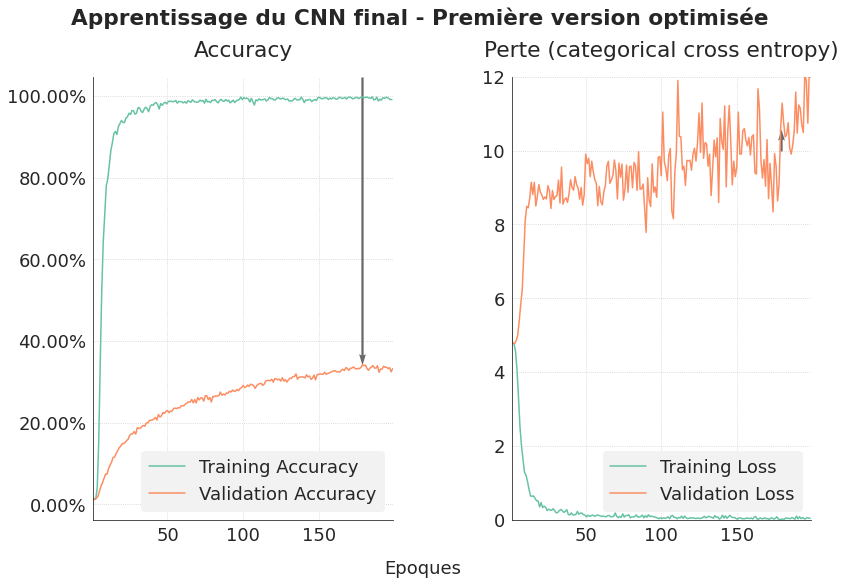

In [ ]:
fig, ax = graph_analysis_both("Apprentissage du CNN final - Première version optimisée",
                              history_csv, is_csv=True)
ax[1].set_ylim([0, 12])
plt.show()

L'accuracy de validation est un peu moins élevée qu'avec notre modèle de base, et le problème d'overfitting n'est pas réglé malgré un apprentissage plus progressif.

#### 4.3.2. Deuxième version avec 128 filtres sur le premier niveau convolutionnel

In [ ]:
MODEL_NAME = "finalcnn"
SUB_MODEL = "secondtry"

In [ ]:
model = final_cnn(first_filters=128)

In [ ]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling_1 (Rescaling)      (None, 256, 256, 3)       0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 256, 256, 128)     512       
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 256, 256, 128)     16512     
_________________________________________________________________
spatial_dropout2d_2 (Spatial (None, 256, 256, 128)     0         
_________________________________________________________________
average_pooling2d_1 (Average (None, 128, 128, 128)     0         
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 128, 128, 256)     33024     
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 128, 128, 256)    

In [ ]:
es_patience = 20
logdir = os.path.join("logs", MODEL_NAME, SUB_MODEL)
tensorboard_callback = TensorBoard(logdir, histogram_freq=1)
checkpoint_callback = ModelCheckpoint("model_{}.h5".format(SUB_MODEL),
                                      monitor="val_accuracy", save_best_only=True)
earlystop_callback = EarlyStopping(monitor="val_accuracy", mode="max", patience=es_patience,
                                   restore_best_weights=True)

In [ ]:
epochs = 1000
history22 = model.fit(data_mini, validation_data=data_valid, verbose=2,
                      epochs=epochs, callbacks=[checkpoint_callback,
                                                earlystop_callback,
                                                tensorboard_callback])

Epoch 1/1000
42/42 - 45s - loss: 5.4871 - accuracy: 0.0074 - val_loss: 4.7760 - val_accuracy: 0.0064
Epoch 2/1000
42/42 - 47s - loss: 4.6899 - accuracy: 0.0193 - val_loss: 4.7565 - val_accuracy: 0.0191
Epoch 3/1000
42/42 - 45s - loss: 4.3186 - accuracy: 0.1168 - val_loss: 4.9159 - val_accuracy: 0.0264
Epoch 4/1000
42/42 - 46s - loss: 3.6437 - accuracy: 0.2738 - val_loss: 5.5872 - val_accuracy: 0.0288
Epoch 5/1000
42/42 - 46s - loss: 3.1598 - accuracy: 0.4048 - val_loss: 5.6242 - val_accuracy: 0.0364
Epoch 6/1000
42/42 - 45s - loss: 2.7504 - accuracy: 0.4821 - val_loss: 6.7902 - val_accuracy: 0.0488
Epoch 7/1000
42/42 - 46s - loss: 2.3801 - accuracy: 0.5818 - val_loss: 7.2549 - val_accuracy: 0.0492
Epoch 8/1000
42/42 - 47s - loss: 1.9467 - accuracy: 0.6496 - val_loss: 8.7077 - val_accuracy: 0.0576
Epoch 9/1000
42/42 - 46s - loss: 1.9937 - accuracy: 0.6607 - val_loss: 8.8181 - val_accuracy: 0.0686
Epoch 10/1000
42/42 - 47s - loss: 1.8817 - accuracy: 0.6957 - val_loss: 9.5125 - val_accura

Je sauvegarde les résultats dans un fichier csv pour pouvoir y revenir facilement.

In [ ]:
history22_csv = pd.DataFrame(history22.history)
history22_csv.to_csv("history_{}.csv".format(SUB_MODEL))

In [ ]:
history_csv = pd.read_csv("history_secondtry.csv", index_col=0)
history_csv.head()

,loss,accuracy,val_loss,val_accuracy
0,5.487093,0.007440,4.776045,0.006371
1,4.689909,0.019345,4.756478,0.019114
2,4.318592,0.116815,4.915939,0.026396
3,3.643733,0.273810,5.587174,0.028823
4,3.159774,0.404762,5.624161,0.036408


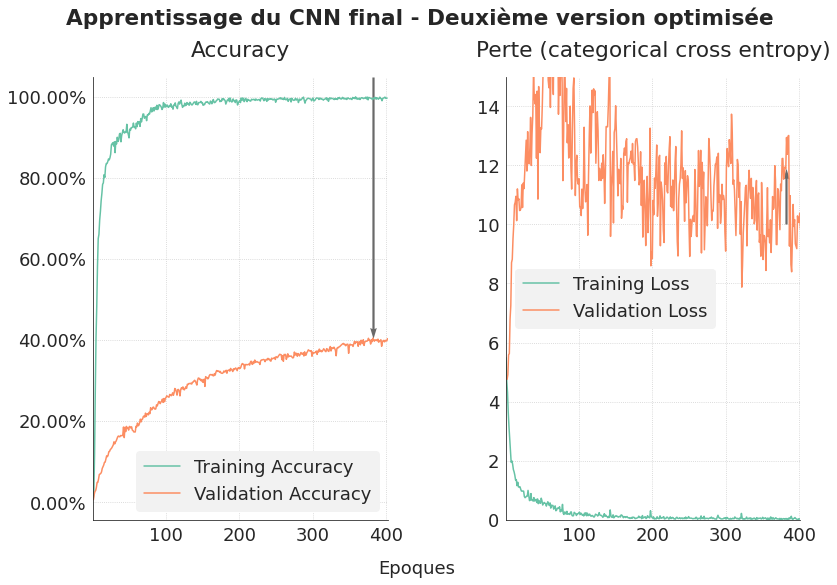

In [ ]:
fig, ax = graph_analysis_both("Apprentissage du CNN final - Deuxième version optimisée",
                              history_csv, is_csv=True)
ax[1].set_ylim([0, 15])
save_fig("iml06_02_cnn_optimise")
plt.show()

Nous retrouvons quasiment la performance de notre modèle de base. Encore une fois, notre problème d'overfitting n'est pas réglé malgré un apprentissage plus progressif.  
Le nombre très élevé de paramètres (plus de 125 millions) par rapport au nombre d'images dont nous disposons pour l'entraînement laisse penser que cet overfitting sera très problématique pour la généralisation.  
Je tente de diminuer le nombre de paramètres grâce à une sortie en Global Max Pooling.

#### 4.3.3. Deuxième version avec 128 filtres sur le premier niveau convolutionnel et une sortie en Global Max Pooling

In [ ]:
MODEL_NAME = "finalcnn"
SUB_MODEL = "secondtry_gmp"

In [ ]:
model = final_cnn(first_filters=128, global_max_pool=True)

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling (Rescaling)        (None, 256, 256, 3)       0         
_________________________________________________________________
conv2d (Conv2D)              (None, 256, 256, 128)     512       
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 256, 256, 128)     16512     
_________________________________________________________________
spatial_dropout2d (SpatialDr (None, 256, 256, 128)     0         
_________________________________________________________________
average_pooling2d (AveragePo (None, 128, 128, 128)     0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 128, 128, 256)     33024     
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 128, 128, 256)     6

In [ ]:
es_patience = 50
#logdir = os.path.join("logs", MODEL_NAME, SUB_MODEL)
#tensorboard_callback = TensorBoard(logdir, histogram_freq=1)
#checkpoint_callback = ModelCheckpoint("model_{}.h5".format(SUB_MODEL),
#                                      monitor="val_accuracy", save_best_only=True)
earlystop_callback = EarlyStopping(monitor="val_accuracy", mode="max", patience=es_patience,
                                   restore_best_weights=True)

In [ ]:
epochs = 1000
history22 = model.fit(data_mini, validation_data=data_valid, verbose=2,
                      epochs=epochs, callbacks=[earlystop_callback])

Epoch 1/1000
42/42 - 656s - loss: 4.7913 - accuracy: 0.0089 - val_loss: 4.7892 - val_accuracy: 0.0079
Epoch 2/1000
42/42 - 80s - loss: 4.7766 - accuracy: 0.0074 - val_loss: 4.7935 - val_accuracy: 0.0079
Epoch 3/1000
42/42 - 80s - loss: 4.7650 - accuracy: 0.0074 - val_loss: 4.8080 - val_accuracy: 0.0100
Epoch 4/1000
42/42 - 80s - loss: 4.7591 - accuracy: 0.0104 - val_loss: 4.8136 - val_accuracy: 0.0103
Epoch 5/1000
42/42 - 80s - loss: 4.7556 - accuracy: 0.0074 - val_loss: 4.8376 - val_accuracy: 0.0118
Epoch 6/1000
42/42 - 80s - loss: 4.7559 - accuracy: 0.0134 - val_loss: 4.8085 - val_accuracy: 0.0082
Epoch 7/1000
42/42 - 80s - loss: 4.7525 - accuracy: 0.0134 - val_loss: 4.8226 - val_accuracy: 0.0085
Epoch 8/1000
42/42 - 80s - loss: 4.7582 - accuracy: 0.0112 - val_loss: 4.8145 - val_accuracy: 0.0079
Epoch 9/1000
42/42 - 80s - loss: 4.7406 - accuracy: 0.0171 - val_loss: 4.8257 - val_accuracy: 0.0088
Epoch 10/1000
42/42 - 80s - loss: 4.7312 - accuracy: 0.0134 - val_loss: 4.8262 - val_accur

L'apprentissage de ce réseau est particulièrement long, même sur seulement 10% des données. Je suis déconnecté de Colab après 12 heures d'entraînement et 366 époques. L'accuracy n'est que de 34,67% sur les données d'entraînement et 5,13% sur les données de validation.  
De ce fait, si je dois opter pour un modèle très régularisé, je préfèrerai le modèle original avec Multiples Spatial Dropout et une sortie en Global Max Pooling.

#### 4.3.4. Version originale (modèle de base)

Je recharge les données d'apprentissage du modèle de base, pour rappel.

In [ ]:
history_csv = pd.read_csv("history_model2_alone.csv", index_col=0)

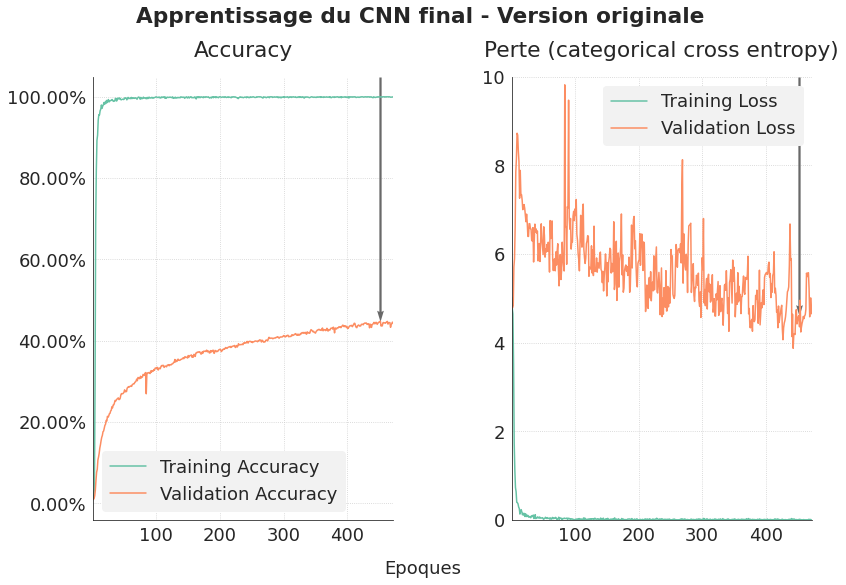

In [ ]:
fig, ax = graph_analysis_both("Apprentissage du CNN final - Version originale",
                              history_csv, is_csv=True)
plt.show()

Le modèle original reste le meilleur. Il a un overfitting plus agressif (l'accuracy de training atteint plus vite 100%), mais son accuracy de validation est supérieure (environ 45% contre 40%) et sa perte de validation inférieure.  
Mes tentatives de diminution de cet overfitting se sont toujours conclues de deux façons : soit l'overfitting et la performance du modèle restent similaires, soit la différence entre les accuracies de validation et d'entraînement a diminué au prix d'une forte baisse de ces deux performances (accuracy de validation égale à 20% au mieux).  
Je compte sur le tranfer learning pour améliorer les résultats. En attendant, je ré-entraîne le modèle sur toutes les données.

---
<a id='5_0'></a>

## <font color=blue>5. Entraînement des modèles potentiels sur toutes les données</font>

Le fait d'utiliser plus de données va diversifier les images utilisées pour l'entraînement. Cela peut enrichir notre modèle et donner une idée sur la capacité de généralisation.  
J'entraîne 3 modèles sur toutes les données :
- le modèle de base : CNN original ;
- le modèle optimisé avec 128 filtres sur le premier niveau convolutionnel ;
- le modèle régularisé avec plusieurs Spatial Dropout et une sortie en Global Max Pooling.

### 5.1. Entraînement du CNN original

In [ ]:
MODEL_NAME = "finalcnn"
SUB_MODEL = "cnn_original"

In [ ]:
reset_random_seeds()
model = get_model_cnn()
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling (Rescaling)        (None, 256, 256, 3)       0         
_________________________________________________________________
conv2d (Conv2D)              (None, 256, 256, 32)      896       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 128, 128, 64)      18496     
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 64, 64, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 64, 64, 128)       73856     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 32, 32, 128)       0

In [ ]:
es_patience = 20
logdir = os.path.join("logs", MODEL_NAME, SUB_MODEL)
checkpoint_callback = ModelCheckpoint("model_{}.h5".format(SUB_MODEL),
                                      monitor="val_accuracy", save_best_only=True)
earlystop_callback = EarlyStopping(monitor="val_accuracy", mode="max", patience=es_patience,
                                   restore_best_weights=True)

In [ ]:
epochs = 1000
history91 = model.fit(data_train, validation_data=data_valid, verbose=2,
                      epochs=epochs, callbacks=[checkpoint_callback,
                                                earlystop_callback])

Epoch 1/1000
412/412 - 4468s - loss: 4.7868 - accuracy: 0.0147 - val_loss: 4.6739 - val_accuracy: 0.0237
Epoch 2/1000
412/412 - 73s - loss: 4.3140 - accuracy: 0.0712 - val_loss: 4.8922 - val_accuracy: 0.0452
Epoch 3/1000
412/412 - 72s - loss: 2.6237 - accuracy: 0.3938 - val_loss: 6.1414 - val_accuracy: 0.0567
Epoch 4/1000
412/412 - 72s - loss: 1.3011 - accuracy: 0.7006 - val_loss: 9.6255 - val_accuracy: 0.0595
Epoch 5/1000
412/412 - 73s - loss: 0.7275 - accuracy: 0.8388 - val_loss: 14.9334 - val_accuracy: 0.0719
Epoch 6/1000
412/412 - 71s - loss: 0.5023 - accuracy: 0.8969 - val_loss: 19.6932 - val_accuracy: 0.0789
Epoch 7/1000
412/412 - 72s - loss: 0.3640 - accuracy: 0.9323 - val_loss: 19.1388 - val_accuracy: 0.0968
Epoch 8/1000
412/412 - 72s - loss: 0.2746 - accuracy: 0.9517 - val_loss: 22.5826 - val_accuracy: 0.1089
Epoch 9/1000
412/412 - 72s - loss: 0.2109 - accuracy: 0.9666 - val_loss: 23.9681 - val_accuracy: 0.1174
Epoch 10/1000
412/412 - 73s - loss: 0.1692 - accuracy: 0.9742 - va

Je sauvegarde les résultats dans un fichier csv pour pouvoir y revenir facilement.

In [ ]:
history91_csv = pd.DataFrame(history91.history)
history91_csv.to_csv("history_{}.csv".format(SUB_MODEL))
model.save("cnn_original")
model.save_weights("weights/cnn_original")

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
INFO:tensorflow:Assets written to: cnn_original/assets


In [ ]:
history_csv = pd.read_csv("history_cnn_original.csv", index_col=0)
history_csv.head()

,loss,accuracy,val_loss,val_accuracy
0,4.786795,0.014657,4.673931,0.023665
1,4.314004,0.071157,4.892248,0.045206
2,2.623750,0.393758,6.141394,0.056735
3,1.301109,0.700562,9.625496,0.059466
4,0.727494,0.838776,14.933402,0.071905


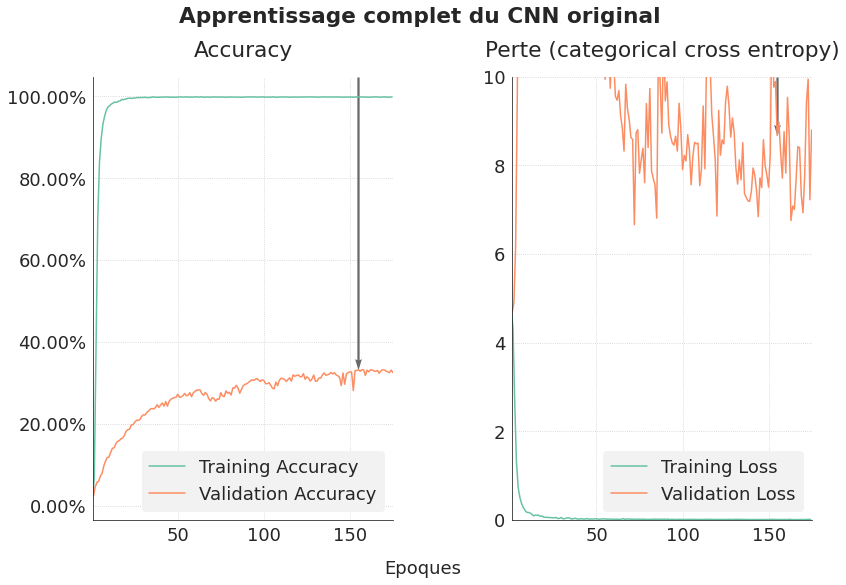

In [ ]:
fig, ax = graph_analysis_both("Apprentissage complet du CNN original",
                              history_csv, is_csv=True)
plt.show()

In [ ]:
history_mini = pd.read_csv("history_model2_alone.csv", index_col=0)
history_mini.head()

,loss,accuracy,val_loss,val_accuracy
0,5.016328,0.008929,4.788666,0.009405
1,4.773577,0.019345,4.783146,0.011833
2,4.645268,0.037946,4.831415,0.018507
3,3.510624,0.290179,5.703714,0.033070
4,1.724344,0.686756,5.892240,0.057342


In [ ]:
compar_train = pd.DataFrame({"val_loss_mini": history_mini.val_loss,
                             "val_accuracy_mini": history_mini.val_accuracy,
                             "val_loss_all": history_csv.val_loss,
                             "val_accuracy_all": history_csv.val_accuracy,})
compar_train.head()

,val_loss_mini,val_accuracy_mini,val_loss_all,val_accuracy_all
0,4.788666,0.009405,4.673931,0.023665
1,4.783146,0.011833,4.892248,0.045206
2,4.831415,0.018507,6.141394,0.056735
3,5.703714,0.033070,9.625496,0.059466
4,5.892240,0.057342,14.933402,0.071905


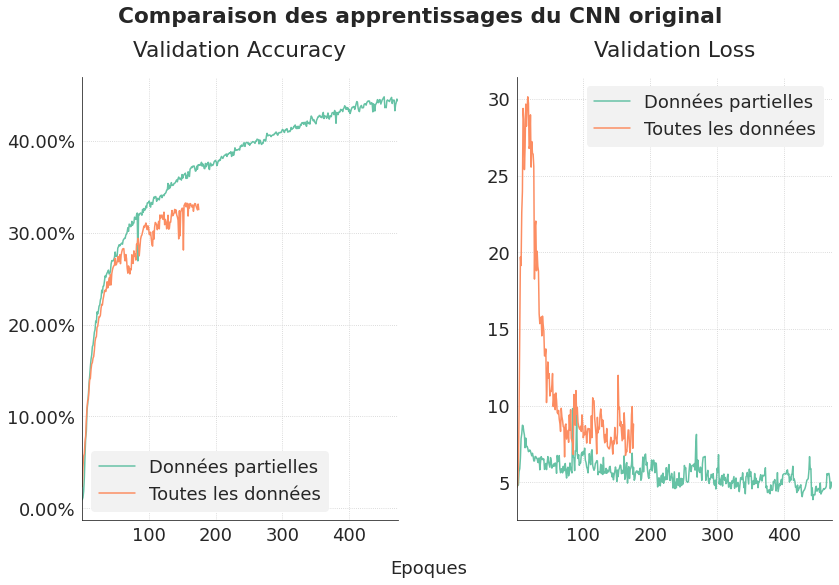

In [ ]:
fig, ax = graph_analysis_compar("Comparaison des apprentissages du CNN original",
                              compar_train)
save_fig("iml06_compar_cnn_original")
plt.show()

Le modèle de base obtient une moins bonne accuracy de validation avec toutes les données : elle croît moins vite et stagne plus vite. La perte de validation est également supérieure avec toutes les données (par rapport à la perte de validation avec 10% des données d'entraînement).  
Cette baisse de performance en utilisant toutes les données et l'overfitting résultent du grand nombre de paramètres du modèle, par rapport au nombre d'images d'entraînement à notre disposition.  
Cela ne laisse pas présager d'une bonne capacité de généralisation de ce modèle.

<a id='5_2'></a>

### 5.2. Entraînement du CNN optimisé avec 128 filtres sur le premier niveau convolutionnel

In [ ]:
MODEL_NAME = "finalcnn"
SUB_MODEL = "cnn_optimise"

In [ ]:
reset_random_seeds()
model = final_cnn(first_filters=128)
model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling_2 (Rescaling)      (None, 256, 256, 3)       0         
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 256, 256, 128)     512       
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 256, 256, 128)     16512     
_________________________________________________________________
spatial_dropout2d_2 (Spatial (None, 256, 256, 128)     0         
_________________________________________________________________
average_pooling2d_1 (Average (None, 128, 128, 128)     0         
_________________________________________________________________
conv2d_9 (Conv2D)            (None, 128, 128, 256)     33024     
_________________________________________________________________
conv2d_10 (Conv2D)           (None, 128, 128, 256)    

In [ ]:
es_patience = 20
checkpoint_callback = ModelCheckpoint("model_{}.h5".format(SUB_MODEL),
                                      monitor="val_accuracy", save_best_only=True)
earlystop_callback = EarlyStopping(monitor="val_accuracy", mode="max", patience=es_patience,
                                   restore_best_weights=True)

In [ ]:
epochs = 1000
history92 = model.fit(data_train, validation_data=data_valid, verbose=2,
                      epochs=epochs, callbacks=[checkpoint_callback,
                                                earlystop_callback])

Epoch 1/1000
412/412 - 241s - loss: 4.9296 - accuracy: 0.0114 - val_loss: 4.7859 - val_accuracy: 0.0115
Epoch 2/1000
412/412 - 235s - loss: 4.7832 - accuracy: 0.0126 - val_loss: 4.7853 - val_accuracy: 0.0115
Epoch 3/1000
412/412 - 232s - loss: 4.7816 - accuracy: 0.0125 - val_loss: 4.7854 - val_accuracy: 0.0112
Epoch 4/1000
412/412 - 245s - loss: 4.7795 - accuracy: 0.0127 - val_loss: 4.7854 - val_accuracy: 0.0118
Epoch 5/1000
412/412 - 237s - loss: 4.7788 - accuracy: 0.0126 - val_loss: 4.7852 - val_accuracy: 0.0115
Epoch 6/1000
412/412 - 238s - loss: 4.7781 - accuracy: 0.0126 - val_loss: 4.7864 - val_accuracy: 0.0115
Epoch 7/1000
412/412 - 238s - loss: 4.7776 - accuracy: 0.0128 - val_loss: 4.7857 - val_accuracy: 0.0109
Epoch 8/1000
412/412 - 238s - loss: 4.7774 - accuracy: 0.0126 - val_loss: 4.7867 - val_accuracy: 0.0118
Epoch 9/1000
412/412 - 236s - loss: 4.7772 - accuracy: 0.0126 - val_loss: 4.7873 - val_accuracy: 0.0115
Epoch 10/1000
412/412 - 237s - loss: 4.7795 - accuracy: 0.0125 -

Je sauvegarde les résultats dans un fichier csv pour pouvoir y revenir facilement.

In [ ]:
history92_csv = pd.DataFrame(history92.history)
history92_csv.to_csv("history_{}.csv".format(SUB_MODEL))
model.save("cnn_optimise")
model.save_weights("weights/cnn_optimise")

INFO:tensorflow:Assets written to: cnn_optimise/assets


In [ ]:
history_csv = pd.read_csv("history_cnn_optimise.csv", index_col=0)
history_csv.head()

,loss,accuracy,val_loss,val_accuracy
0,4.929592,0.011391,4.785932,0.011529
1,4.783233,0.012606,4.785312,0.011529
2,4.781560,0.012454,4.785424,0.011226
3,4.779491,0.012682,4.785385,0.011833
4,4.778782,0.012606,4.785171,0.011529


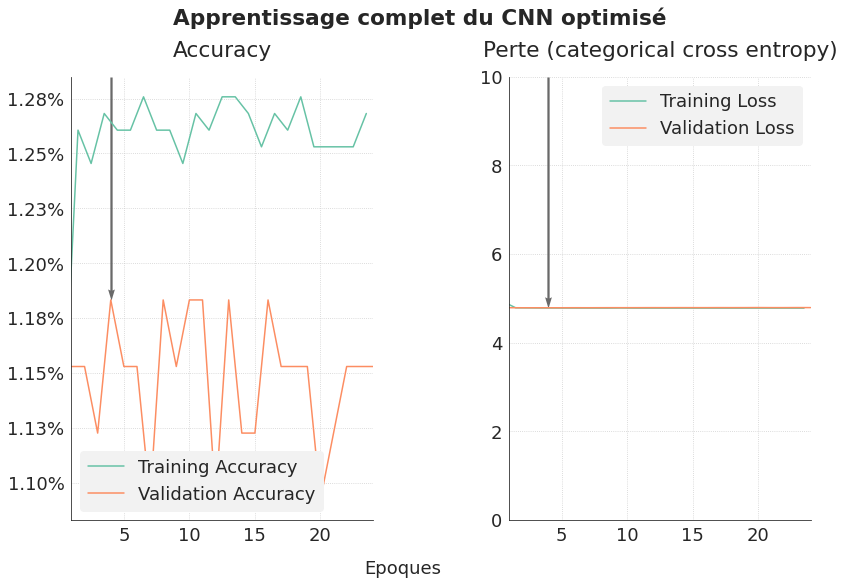

In [ ]:
fig, ax = graph_analysis_both("Apprentissage complet du CNN optimisé",
                              history_csv, is_csv=True)
plt.show()

In [ ]:
history_mini = pd.read_csv("history_secondtry.csv", index_col=0)
history_mini.head()

,loss,accuracy,val_loss,val_accuracy
0,5.487093,0.007440,4.776045,0.006371
1,4.689909,0.019345,4.756478,0.019114
2,4.318592,0.116815,4.915939,0.026396
3,3.643733,0.273810,5.587174,0.028823
4,3.159774,0.404762,5.624161,0.036408


In [ ]:
compar_train = pd.DataFrame({"val_loss_mini": history_mini.val_loss,
                             "val_accuracy_mini": history_mini.val_accuracy,
                             "val_loss_all": history_csv.val_loss,
                             "val_accuracy_all": history_csv.val_accuracy,})
compar_train.head()

,val_loss_mini,val_accuracy_mini,val_loss_all,val_accuracy_all
0,4.776045,0.006371,4.785932,0.011529
1,4.756478,0.019114,4.785312,0.011529
2,4.915939,0.026396,4.785424,0.011226
3,5.587174,0.028823,4.785385,0.011833
4,5.624161,0.036408,4.785171,0.011529


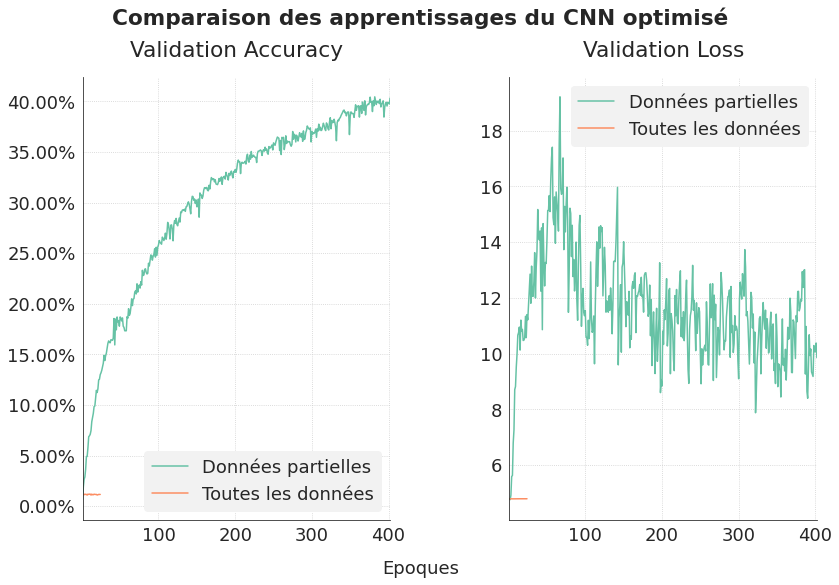

In [ ]:
fig, ax = graph_analysis_compar("Comparaison des apprentissages du CNN optimisé",
                              compar_train)
save_fig("iml06_compar_cnn_optimise")
plt.show()

Le modèle optimisé obtient une accuracy de validation à peine supérieure au pur hasard lorsqu'il est entraîné sur toutes les données d'entraînement.  
Pour rappel, ce modèle a un nombre très élevé Cette baisse spectaculaire de sa performance illustre le danger de l'overfitting. De toute évidence, ce modèle doit être abandonné.

<a id='5_3'></a>

### 5.3. Entraînement du CNN original régularisé avec plusieurs Spatial Dropout et une sortie en Global Max Pooling

In [ ]:
MODEL_NAME = "finalcnn"
SUB_MODEL = "cnn_regularise"

In [ ]:
reset_random_seeds()
model = get_cnn_regularise()
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling (Rescaling)        (None, 256, 256, 3)       0         
_________________________________________________________________
conv2d (Conv2D)              (None, 256, 256, 32)      896       
_________________________________________________________________
spatial_dropout2d (SpatialDr (None, 256, 256, 32)      0         
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 128, 128, 64)      18496     
_________________________________________________________________
spatial_dropout2d_1 (Spatial (None, 128, 128, 64)      0         
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 64, 64, 64)        0

In [ ]:
es_patience = 50
checkpoint_callback = ModelCheckpoint("model_{}.h5".format(SUB_MODEL),
                                      monitor="val_accuracy", save_best_only=True)
earlystop_callback = EarlyStopping(monitor="val_accuracy", mode="max", patience=es_patience,
                                   restore_best_weights=True)

In [ ]:
epochs = 1000
history93 = model.fit(data_train, validation_data=data_valid, verbose=2,
                      epochs=epochs, callbacks=[checkpoint_callback,
                                                earlystop_callback])

Epoch 1/1000
412/412 - 4660s - loss: 4.7861 - accuracy: 0.0105 - val_loss: 4.7863 - val_accuracy: 0.0094
Epoch 2/1000
412/412 - 83s - loss: 4.7782 - accuracy: 0.0137 - val_loss: 4.7803 - val_accuracy: 0.0130
Epoch 3/1000
412/412 - 84s - loss: 4.7638 - accuracy: 0.0137 - val_loss: 4.7646 - val_accuracy: 0.0137
Epoch 4/1000
412/412 - 83s - loss: 4.7411 - accuracy: 0.0185 - val_loss: 4.7371 - val_accuracy: 0.0170
Epoch 5/1000
412/412 - 83s - loss: 4.7158 - accuracy: 0.0193 - val_loss: 4.7109 - val_accuracy: 0.0215
Epoch 6/1000
412/412 - 83s - loss: 4.6749 - accuracy: 0.0250 - val_loss: 4.6665 - val_accuracy: 0.0209
Epoch 7/1000
412/412 - 83s - loss: 4.6399 - accuracy: 0.0274 - val_loss: 4.6051 - val_accuracy: 0.0258
Epoch 8/1000
412/412 - 84s - loss: 4.6057 - accuracy: 0.0310 - val_loss: 4.5795 - val_accuracy: 0.0282
Epoch 9/1000
412/412 - 84s - loss: 4.5655 - accuracy: 0.0336 - val_loss: 4.5380 - val_accuracy: 0.0316
Epoch 10/1000
412/412 - 84s - loss: 4.5215 - accuracy: 0.0387 - val_los

Je sauvegarde les résultats dans un fichier csv pour pouvoir y revenir facilement.

In [ ]:
history93_csv = pd.DataFrame(history93.history)
history93_csv.to_csv("history_{}.csv".format(SUB_MODEL))
# model.save("cnn_regularise")
model.save_weights("weights/cnn_regularise")

In [ ]:
history_csv = pd.read_csv("history_cnn_regularise.csv", index_col=0)
history_csv.head()

,loss,accuracy,val_loss,val_accuracy
0,4.786074,0.010480,4.786289,0.009405
1,4.778218,0.013670,4.780282,0.013046
2,4.763761,0.013745,4.764595,0.013653
3,4.741080,0.018454,4.737090,0.016990
4,4.715822,0.019289,4.710935,0.021541


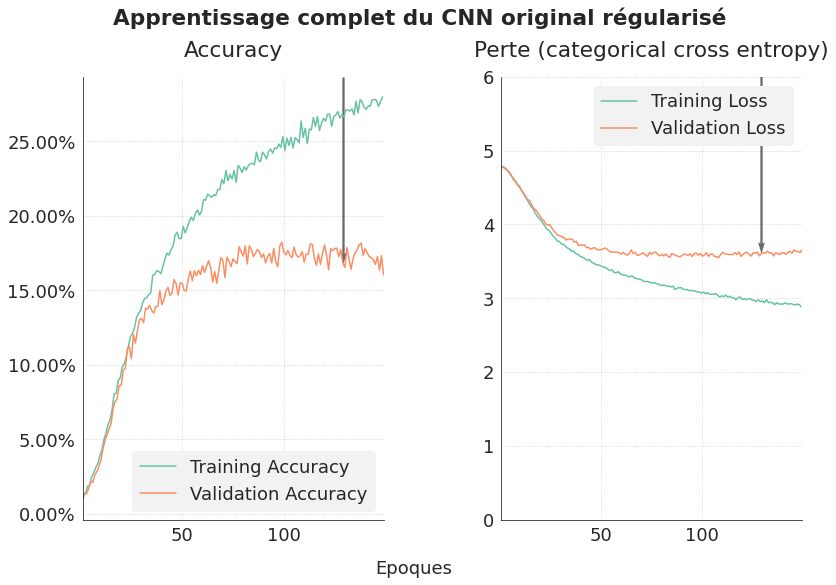

In [ ]:
fig, ax = graph_analysis_both("Apprentissage complet du CNN original régularisé",
                              history_csv, is_csv=True)
ax[1].set_ylim([0, 6])
save_fig("iml06_cnn_retenu")
plt.show()

L'overfitting est bien contenu par ce modèle, dont la performance est meilleure que le pur hasard mais insufisante pour une mise en production.

In [ ]:
history_mini = pd.read_csv("history_multiples_spatial_dropout_GMP.csv", index_col=0)
history_mini.head()

,loss,accuracy,val_loss,val_accuracy
0,4.797807,0.009673,4.787215,0.010619
1,4.779550,0.011161,4.790473,0.010316
2,4.773019,0.007440,4.795630,0.005765
3,4.760479,0.012649,4.801046,0.012136
4,4.759099,0.011161,4.808841,0.013350


In [ ]:
compar_train = pd.DataFrame({"val_loss_mini": history_mini.val_loss,
                             "val_accuracy_mini": history_mini.val_accuracy,
                             "val_loss_all": history_csv.val_loss,
                             "val_accuracy_all": history_csv.val_accuracy,})
compar_train.head()

,val_loss_mini,val_accuracy_mini,val_loss_all,val_accuracy_all
0,4.787215,0.010619,4.786289,0.009405
1,4.790473,0.010316,4.780282,0.013046
2,4.795630,0.005765,4.764595,0.013653
3,4.801046,0.012136,4.737090,0.016990
4,4.808841,0.013350,4.710935,0.021541


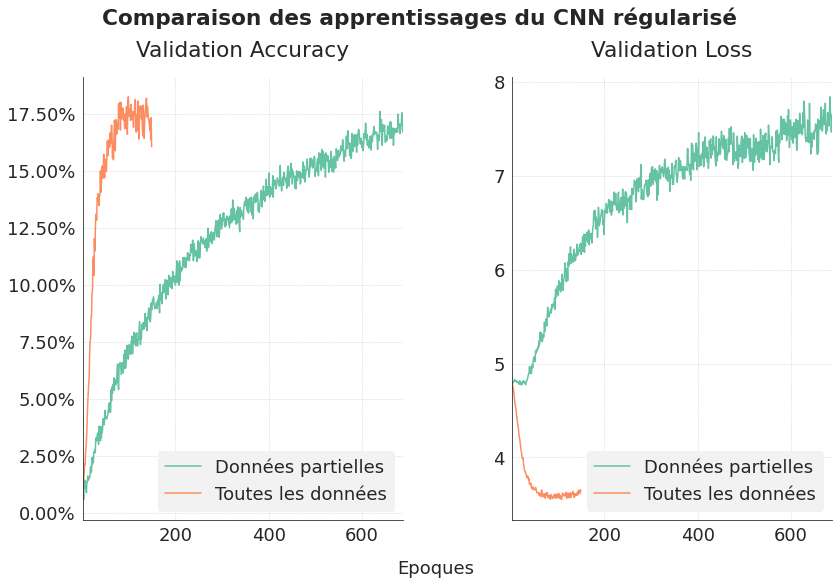

In [ ]:
fig, ax = graph_analysis_compar("Comparaison des apprentissages du CNN régularisé",
                              compar_train)
save_fig("iml06_compar_cnn_regularise")
plt.show()

Ce modèle a un comportement intéressant et très différent des deux autres modèles lorsque j'utilise toutes les données d'entraînement :
- il apprend plus vite avec toutes les données d'entraînement pour atteindre une accuracy de validation similaire, et même légèrement supérieure qu'avec 10% des données d'entraînement ;
- le perte de validation diminue rapidement et se stabilise à une valeur faible par rapport aux autres modèles étudiés.

Ces observations cumulées à l'overfitting contenu m'amènent à être plus confiant quant à ses capacités de généralisation. Je vérifie ce point.

---
<a id='6_0'></a>

## <font clor=blue>6. Evaluation de la performance de généralisation du modèle retenu</font>

Dans un premier temps, je vérifie mon intuition que le modèle de base ne généralise pas bien.  
Puis je teste la capacité de généralisation du modèle régularisé que j'ai retenu.

### 6.1. Modèle de base

Je recharge les poids du modèle entraîné et je vérifie que la performance de validation est cohérente avec celle que j'avais obtenu lors de mes recherches.  
Puis je calcule la performance de généralisation sur les données de test jamais vues jusqu'ici.

In [ ]:
reset_random_seeds()
model = get_model_cnn()
model.load_weights("weights/cnn_original")
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling (Rescaling)        (None, 256, 256, 3)       0         
_________________________________________________________________
conv2d (Conv2D)              (None, 256, 256, 32)      896       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 128, 128, 64)      18496     
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 64, 64, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 64, 64, 128)       73856     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 32, 32, 128)       0

In [ ]:
model.evaluate(data_valid, return_dict=True)

103/103 [==============================] - 1147s 11s/step - loss: 8.6643 - accuracy: 0.3325


{'accuracy': 0.33252426981925964, 'loss': 8.664291381835938}

Le bon modèle est rechargé : la performance est similaire.

In [ ]:
model.evaluate(data_test, return_dict=True)

129/129 [==============================] - 1318s 10s/step - loss: 13.2075 - accuracy: 0.0408


{'accuracy': 0.040816325694322586, 'loss': 13.207535743713379}

Comme je m'y attendais, la performance de généralisation est déplorable. Cela résulte de l'overfitting dû au fait qu'il y a trop de paramètres à déterminer par rapport à la taille de notre jeu d'images.  
Ce modèle ne peut pas être utilisé.

<a id='6_2'></a>

### 6.2. Modèle régularisé

In [ ]:
reset_random_seeds()
model2 = get_cnn_regularise()
model2.load_weights("weights/cnn_regularise")
model2.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling (Rescaling)        (None, 256, 256, 3)       0         
_________________________________________________________________
conv2d (Conv2D)              (None, 256, 256, 32)      896       
_________________________________________________________________
spatial_dropout2d (SpatialDr (None, 256, 256, 32)      0         
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 128, 128, 64)      18496     
_________________________________________________________________
spatial_dropout2d_1 (Spatial (None, 128, 128, 64)      0         
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 64, 64, 64)        0

In [ ]:
model2.evaluate(data_valid, return_dict=True)

103/103 [==============================] - 1912s 19s/step - loss: 3.5972 - accuracy: 0.1836


{'accuracy': 0.18355582654476166, 'loss': 3.5971555709838867}

Le modèle est bien rechargé.

In [ ]:
model2.evaluate(data_test, return_dict=True)

129/129 [==============================] - 2211s 17s/step - loss: 3.6484 - accuracy: 0.1730


{'accuracy': 0.17298348248004913, 'loss': 3.6484181880950928}

L'accuracy de généralisation, ainsi que la perte, sont très proches des valeurs de validation obtenues lors de l'entraînement sur toutes les données.  
Ce modèle est le plus adapté pour notre mission parmi les différents modèles testés jusqu'ici. Toutefois, sa performance est insuffisante pour une mise en production.  
Le Transfer Learning devrait nous fournir de meilleurs résultats.